In [1]:
import Agents
import Markets

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats

def add_price_data(df, t):
    
    #pA_buy, pA_sell, pB_buy, pB_sell = df
    p_buy, p_sell = df
    
    for v, agent in enumerate(agent_list):
        p_buy[t][v] = agent.p_buy
        p_sell[t][v] = agent.p_sell



In [2]:
def add_quant_data(df, t):

    for v,agent in enumerate(agent_list):

        df[t][v] = agent.Q
    
    
    #print(agent_list[0].Q)
    
def add_deficit_data(df, t):

    for v,agent in enumerate(agent_list):

        df[t][v] = agent.D
    
def add_money_data(df, t):
    
    for v,agent in enumerate(agent_list):

        df[t][v] = agent.M
    
    
def reset():
    
    for agent in agentA_list:
        
        #if initialize_money=='random':
        #    agent.M = np.random.uniform(M)
        #else:
        #    agent.M = M
        #    
        #if initialize_quantity=='random':
        #    agent.Q[0] = np.random.uniform(QA1)
        #else:
        #    agent.Q[0] = QA1

        if initialize_prices=='random':
            
            agent.p_buy  = np.random.uniform(agent.M, size=n)
            agent.p_sell = np.random.uniform(agent.M, size=n)
            
        else:
            agent.p_buy  = [p1buy_A_0, p2buy_A_0]
            agent.p_sell = [p1sell_A_0, p2sell_A_0]
        
    for agent in agentB_list:
        
        #if initialize_money=='random':
        #    agent.M = np.random.uniform(M)
        #else:
        #    agent.M = M
        
        if initialize_prices=='random':
            agent.p_buy  = np.random.uniform(agent.M, size=n)
            agent.p_sell = np.random.uniform(agent.M, size=n)
        
        else:
            agent.p_buy  = [p1buy_B_0, p2buy_B_0]
            agent.p_sell = [p1sell_B_0, p2sell_B_0]
    
    market.reset()


In [3]:
def market_supply_demand(*, i=0):

    dE_dict = market.set_intended_exchange(ExchangeDict)
    dE_dict

    supplied = 0
    demanded = 0
    for dE in dE_dict.values():
        if dE[i] < 0:
            supplied += dE[i]
        elif dE[i] > 0:
            demanded += dE[i]

    return -supplied, demanded

def plot_market(i, *, ps=10, log=False, supply_demand=False):

    f, ax = plt.subplots(1, figsize=(10,4)) #(2,1)

    ax.plot(ME_df[:,i], c='C0', label=f'$\Delta M_{i}$')
    ax.plot(QE_df[:,i], c='C1', label=f'$\Delta Q_{i}$')
    ax.plot(ntries_df, c='k', label='Tries', lw='0.5')

    p = ME_df[:,i]/QE_df[:,i]
    ax.scatter(np.arange(0,T), p, c='g', label=f'$p_{i}$', s=ps)
    
    if supply_demand:
        ax.plot(supply_df, c='blue', ls='--', label=f'Supply')
        ax.plot(demand_df, c='orange', ls='--', label=f'Demand')

    ax.legend()
    
    if log:
        plt.yscale('log')
        
    plt.title(f'Market for Commodity {i}')
    plt.xlabel('t')
    plt.ylabel('$M$, $Q$')


def plot_prices(p_df, i, *, A=0, B=1, ps=10, log=False, includeM=True):

    'A sells i=0 and buys i=1, and vice versa for B'

    if i == 0:
        plt.plot(p_df[1][:,A,i], c='C0', ls='-.', label=f"A's Selling Price for {i}")
        plt.plot(p_df[0][:,B,i], c='C1', ls='-', label=f"B's Buying Price for {i}")

    elif i == 1:
        plt.plot(p_df[0][:,A,i], c='C0', ls='-', label=f"A's Buying Price for {i}")
        plt.plot(p_df[1][:,B,i], c='C1', ls='-.', label=f"B's Selling Price for {i}")

    if includeM:
        plt.plot(M_df[:,A], c='C0', ls=':', lw=0.5, label=f'$M_A$')
        plt.plot(M_df[:,B], c='C1', ls=':', lw=0.5, label=f'$M_B$')
    
    p = ME_df[:,i]/QE_df[:,i]
    plt.scatter(np.arange(T)+0.5, p, c='g', s=ps)
    
    plt.legend()
    
    if log:
        plt.yscale('log')

    plt.title(f'Market Prices for Commodity {i}')
    plt.xlabel('t')
    plt.ylabel('Prices')
    
def plot_quantities(Q_df, D_df, i, *, A=0, B=1):

    plt.plot(Q_df[:,A,i], c='C0', ls='-', label=f"A's Q{i}")
    plt.plot(D_df[:,A,i], c='C0', ls=':', label=f"A's D{i}")

    plt.plot(Q_df[:,B,i], c='C1', ls='-', label=f"B's Q{i}")
    plt.plot(D_df[:,B,i], c='C1', ls=':', label=f"B's D{i}")

    plt.legend()

    plt.title(f'Quantities for Commodity {i}')
    plt.xlabel('t')
    plt.ylabel('Q,D')


In [4]:
NA = 2
NB = 10
N = NA+NB
M = 1000

n = 2

QA1 = 100
QA2 = 0

QB1 = 0
QB2 = 0

QA_0 = np.array([QA1, QA2])
QB_0 = np.array([QB1, QB2])

QA = np.copy(QA_0)
QB = np.copy(QB_0)

qA = np.array([0, 0])
qB = np.array([0, 0])

cA = np.array([0, 0])
cB = np.array([5, 0])

DA = cA.copy()
DB = cB.copy()

initialize_prices = 'set'

p1buy_A_0    = 0 
p1sell_A_0   = 1

p2buy_A_0    = 0 
p2sell_A_0   = 0 

p1buy_B_0    = 2 
p1sell_B_0   = 0 

p2buy_B_0    = 0
p2sell_B_0   = 0

In [5]:
agentA_list = [Agents.Agent(QA.copy(), DA.copy(), M, n_actions=1, input_dims=[1]) for agent in range(NA)]
agentB_list = [Agents.Agent(QB.copy(), DB.copy(), M, n_actions=1, input_dims=[1]) for agent in range(NB)]

agent_list = agentA_list + agentB_list

In [6]:
Q = np.zeros(n)
for agent in agent_list:
    Q += agent.Q
    
Q

array([200.,   0.])

In [7]:
D = np.zeros(n)
for agent in agent_list:
    D += agent.D
    
D

array([50.,  0.])

In [8]:
S = np.zeros(n)
for agent in agent_list:
    S += (agent.Q - agent.D)
    
S

array([150.,   0.])

In [9]:
price_adjust_method = 'proportional_random'
max_agent_tries = 100 #100

verbose = True

alpha = 0.01     #0.05 #0.1/max_agent_tries
beta  = 0.01      #0.01 #1.0/max_agent_tries #1./max_agent_tries
gamma = 1.00
epsilon_switch = 0.0
epsilon_rand =   0.0 #0.01/max_agent_tries

max_tries = N*max_agent_tries
 #_random' #proportional_random' #'step_random'
min_price = 1e-5

In [10]:
market = Markets.Market(n, 
                        verbose=verbose, 
                        minimum_price=min_price, 
                        alpha=alpha, 
                        beta=beta, 
                        gamma=gamma, 
                        epsilon_switch=epsilon_switch, 
                        epsilon_rand=epsilon_rand,
                        max_agent_tries=max_agent_tries, 
                        max_tries=max_tries,
                        price_adjust_method=price_adjust_method)

print(f'Market has {max_tries} max tries')

ExchangeDict = {agent : 2 for agent in agent_list}

Market has 1200 max tries


In [11]:
np.random.uniform(0,market.beta)
#market.beta

0.0092187671549581

In [12]:
T = 26 #50

reset()

# Setup data
p_buy, p_sell = np.zeros((T, N, n)), np.zeros((T, N, n))
p_df = (p_buy, p_sell)

Q_df = np.zeros((T, N, n))

D_df = np.zeros((T, N, n))

M_df = np.zeros((T, N))

ME_df = np.zeros((T,n))
QE_df = np.zeros((T,n))
sE_df = np.zeros((T,n))
ntries_df = []

supply_df = []
demand_df = []

add_price_data(p_df, 0)
add_quant_data(Q_df, 0)
add_deficit_data(D_df, 0)
add_money_data(M_df, 0)

# Run market
for t in range(T-1):
    
    print(t)
    print()
    print()
    
    supply0, demand0 = market_supply_demand()

    ME, QE, stn_dev, ntries = market.run_exchange(ExchangeDict)
    
    # Reset quantities
    for agentA in agentA_list:
        #pass
        #agentA.Q = np.maximum(np.zeros(n), agentA.Q + qA - cA) #np.array([QA1, QA2])*np.exp(-0.005*t)
        
        agentA.Q = QA.copy()
        agentA.M = M

    for agentB in agentB_list:
        #pass
        #agentB.Q = np.maximum(np.zeros(n), agentB.Q + qB - cB) #np.array([QB1, QB2])*np.exp(0.001*t)
        
        agentB.Q = QB.copy()
        agentB.M = M 
        agentB.D = agentB.D + np.array([0.5, 0])
    
    add_price_data(p_df, t+1)
    add_quant_data(Q_df, t+1)
    add_deficit_data(D_df, t+1)
    add_money_data(M_df, t+1)
    
    # Market action occurs at half-time interval
    ME_df[t] = ME
    QE_df[t] = QE
    sE_df[t] = stn_dev
    ntries_df.append(ntries)
    
    supply_df.append(supply0)
    demand_df.append(demand0)

0


---Begin Exchanging---

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC1E70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [100   0] [0 0] 1000
<Agents.Agent object at 0x000002C176FC0DF0> [100   0] [0 0] 1000
<Agents.Agent object at 0x000002C176FC1E70> [0 0] [5

<Agents.Agent object at 0x000002C176FC3C70> [0 0] [5 0] 1000
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [5 0] 1000
<Agents.Agent object at 0x000002C176FC2F50> [0 0] [5 0] 1000
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [5 0] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [5 0] 998.1255126136002
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([4, 0]), <Agents.Agent object at 0x000002C176FC24D0>: array([4, 0]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 

Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 6 to 7
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-95,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3, 0]), <Agents.Agent object at 0x000002C176FC30A0>: array([4, 0]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([3, 0]), <Agents.Agent object at 0x000002C176FC24D0>: array([1, 0]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4, 0]), <Agents.Agent object at 0x000002C176FC2F50>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4, 0]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4, 0])}
            ------------                      
Total Exchange Attempts 13/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-95,   0]), <Agents.Agent object at 0x000002C176FC0

<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [5 0] 998.1255126136002
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2, 0]), <Agents.Agent object at 0x000002C176FC30A0>: array([4, 0]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([3, 0]), <Agents.Agent object at 0x000002C176FC3C70>: array([4, 0]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4, 0]), <Agents.Agent object at 0x000002C176FC2F50>: array([4, 0]), <Agents.Agent object at 0x000002C176FC1C30>: array([4, 0]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4, 0])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2, 0]), <Agents.Agent object at 0x000002C176FC30A0>: array([4, 0]), <

     Buyer Exchange: [2 0]
                     [2 0]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1019.805
     Seller D:       [0 0]
     Seller Q:       [87  0]
     Seller Exchange:[-87   0]
                     [-87   0]
                ------------                  

     Dec. Buyer Price to 1.986 and inc. Seller Price to 1.088

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.986
New Seller Price:    1.088

Agent <Agents.Agent object at 0x000002C176FC2F50> attempts increased from 2 to 3
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 12 to 13
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1, 0]), <Agents.Agent object at 0x000002C176FC30A0>: array([3, 0]), <Agents.Agent object at 0x000002C176FC2D70>: array([4, 0]), <Agents.Agent

<Agents.Agent object at 0x000002C176FC1C30> [3 0] [5 0] 995.4961801579088
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-77,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC2D70>: array([3, 0]), <Agents.Agent object at 0x000002C176FC3C70>: array([3, 0]), <Agents.Agent object at 0x000002C176FC3EE0>: array([1, 0]), <Agents.Agent object at 0x000002C176FC2F50>: array([1, 0]), <Agents.Agent object at 0x000002C176FC1C30>: array([2, 0])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC2D70>: array([3, 0]), <Agents.Agent object at 0x000002C176FC3C70>: array([3, 0]), <Agents.Agent object at 0x000002C176FC3EE0>: array([1, 0]), <Agents.Agent object at 0x000002C176FC2F50>: array([0, 0]), <Agents.Agent object at 0x000002C176FC1C30>: array([2, 0])}
      After Exchange
     Buyer           <Agents.Agent object 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC1E70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC24D0>
     Buyer Money:    998.242
     Buyer D:        [5.5 0. ]
     Buyer Q:        [1 0]
     Buyer Exchange: [4.5 0. ]
                     [4.5 0. ]

     Sell

     Buyer Exchange: [4.5 0. ]
                     [4.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1006.344
     Seller D:       [0 0]
     Seller Q:       [96  0]
     Seller Exchange:[-96   0]
                     [-96   0]
                ------------                  

     Dec. Buyer Price to 1.967 and inc. Seller Price to 1.111

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.967
New Seller Price:    1.111

Agent <Agents.Agent object at 0x000002C176FC30A0> attempts increased from 0 to 1
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 3 to 4
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    993.657
     Buyer D:        [5.5 0. ]
     Buyer Q:        [4 0]
     Buyer Exchange: [1.5 0. ]
                     [1.5 0. ]

     

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
            ------------                      
Total Exchange Attempts 17/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC

<Agents.Agent object at 0x000002C176FC2F50> [3 0] [5.5 0. ] 995.3660810894274
<Agents.Agent object at 0x000002C176FC1C30> [2 0] [5.5 0. ] 996.4746000784829
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [5.5 0. ] 998.4685458925163
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-75,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([0.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([2.5, 0. ])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC2F50>
     Buyer Money:    992.471
     Buyer D:        [5.5 0. ]
     Buyer Q:        [5 0]
     Buyer Exchange: [0.5 0. ]
                     [0.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1030.945
     Seller D:       [0 0]
     Seller Q:       [80  0]
     Seller Exchange:[-80   0]
                     [-80   0]
                ------------                  

     Dec. Buyer Price to 1.949 and inc. Seller Price to 1.293

Return to <<attempt_exchange()>>
...After Trying Exchan

     Buyer Exchange: [5. 0.]
                     [5. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1005.538
     Seller D:       [0 0]
     Seller Q:       [97  0]
     Seller Exchange:[-97   0]
                     [-97   0]
                ------------                  

     Dec. Buyer Price to 1.947 and inc. Seller Price to 1.316

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.947
New Seller Price:    1.316

Agent <Agents.Agent object at 0x000002C176FC2F50> attempts increased from 0 to 1
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 2 to 3
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([6., 0.]), <Agen

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    996.861
     Buyer D:        [6. 0.]
     Buyer Q:        [2 0]
     Buyer Exchange: [4. 0.]
                     [4. 0.]

     Seller          

     Buyer Exchange: [3. 0.]
                     [3. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1017.502
     Seller D:       [0 0]
     Seller Q:       [90  0]
     Seller Exchange:[-90   0]
                     [-90   0]
                ------------                  

     Dec. Buyer Price to 1.933 and inc. Seller Price to 1.338

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.933
New Seller Price:    1.338

Agent <Agents.Agent object at 0x000002C176FC2F50> attempts increased from 2 to 3
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 9 to 10
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Age

<Agents.Agent object at 0x000002C176FC24D0> [2 0] [6. 0.] 997.307988557916
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [6. 0.] 995.254084277239
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [6. 0.] 996.6101581343407
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [6. 0.] 994.4007933619167
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [6. 0.] 998.5112309262101
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [6. 0.] 995.2524226212606
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC3E

<Agents.Agent object at 0x000002C176FC0DF0> [87  0] [0 0] 1021.0682489966783
<Agents.Agent object at 0x000002C176FC1E70> [3 0] [6. 0.] 994.8548992063586
<Agents.Agent object at 0x000002C176FC30A0> [5 0] [6. 0.] 991.6125599713225
<Agents.Agent object at 0x000002C176FC21D0> [0 0] [6. 0.] 1000
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [6. 0.] 997.307988557916
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [6. 0.] 995.254084277239
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [6. 0.] 996.6101581343407
<Agents.Agent object at 0x000002C176FC2F50> [5 0] [6. 0.] 991.1927330824827
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [6. 0.] 998.5112309262101
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [6. 0.] 993.5924831472594
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([1., 0.

           [6. 0.]
           [6. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [83  0]
Seller E:  -83
           [-83   0]
           [-83   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC21D0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.961
Seller Price:  1.324

-Scenario 2-
Enact Exchange
-Buyer Price 1.961 higher than Seller Price 1.324-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.961
     pmin_seller:    1.324
     Settled Price:  1.8196929771245736

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC21D0>
     Buyer Money:    1000.000
     Buyer D:        [6. 0.]
     Buyer Q:        [0 0]
     Buyer Exchange: [6. 0.]
                     [6. 0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1027.327
     Seller D:       [0 0]
     Seller Q:

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-74,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-74,   0]), <Agents.Agent object at 0x000002C176FC21D0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([1., 0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC1C30>
     Buyer Money:    992.162
     Buyer D:        [6. 0.]
     Buyer Q:        [5 0]
     Buyer Exchange: [1. 0.]
                     [1. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1042.349
     Seller D:       [0 0]
     Seller Q:       [74  0]
     Seller Exchange:[-74   0]
                     [-74   0]
                ------------                  

     Dec. Buyer Price to 1.921 and inc. Seller Price to 1.375

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Ag

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5,

Buyer Q:   [1 0]
Buyer E:   6
           [5.5 0. ]
           [5.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [92  0]
Seller E:  -92
           [-92   0]
           [-92   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.901
Seller Price:  1.434

-Scenario 2-
Enact Exchange
-Buyer Price 1.901 higher than Seller Price 1.434-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.901
     pmin_seller:    1.434
     Settled Price:  1.504457241852883

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    998.405
     Buyer D:        [6.5 0. ]
     Buyer Q:        [1 0]
     Buyer Exchange: [5.5 0. ]
                     [5.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1012.958
   

     Buyer Exchange: [2.5 0. ]
                     [2.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1016.013
     Seller D:       [0 0]
     Seller Q:       [90  0]
     Seller Exchange:[-90   0]
                     [-90   0]
                ------------                  

     Dec. Buyer Price to 1.894 and inc. Seller Price to 1.444

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.894
New Seller Price:    1.444

Agent <Agents.Agent object at 0x000002C176FC2F50> attempts increased from 3 to 4
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 9 to 10
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([6., 0.])

<Agents.Agent object at 0x000002C176FC30A0> [5 0] [6.5 0. ] 991.8903650917845
<Agents.Agent object at 0x000002C176FC2D70> [1 0] [6.5 0. ] 998.3262629475055
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [6.5 0. ] 998.4886892234243
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [6.5 0. ] 996.7713584748262
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [6.5 0. ] 998.2770881997264
<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [6.5 0. ] 991.9913557053928
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [6.5 0. ] 993.4923371058713
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [6.5 0. ] 993.3605146709536
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [6.5 0. ] 993.3189399903536
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([1.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC

4


---Begin Exchanging---

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC1E70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([7., 0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [100   0] [0 0] 1000
<Agents.Agent object at 0x000002C176FC0DF0> [100   0] [0 0] 1000
<Agents.Agent object at 0x000002C176FC1E70> [0 0] [7

<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [7. 0.] 992.7444847728738
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC1E7

<Agents.Agent object at 0x000002C176FC1C30> [0 0] [8. 0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [8. 0.] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1000
<Agents.Agent object at 0x000002C176FC0DF0> 1000
<Agents.Agent object at 0x000002C176FC1E70> 1000
<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 1000
<Agents.Agent object at 0x000002C176FC21D0> 1000
<Agents.Agent object at 0x000002C176FC24D0> 1000
<Agents.Agent object at 0x000002C176FC3C70> 1000
<Agents.Agent object at 0x000002C176FC3EE0> 1000
<Agents.Agent object at 0x000002C176FC2F50> 1000
<Agents.Agent object at 0x000002C176FC1C30> 1000
<Agents.Agent object at 0x000002C176FC1BA0> 1000

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 8.0, <Agents.Agent object at 0x000002C176FC30A0>: 8.0, <Agents.Agent object at 0x000002C176FC2D70>: 8.0, <Agents.Agent object at 0x000002C176FC21D0>: 8.0, <Agents.Agent object at 0x000002C176FC24D0>: 8.0, <Agents.Age

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4., 0.])}
            ------------                      
Total Exchange Attempts 88/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2D70

<Agents.Agent object at 0x000002C176FC2F50> [7 0] [8. 0.] 987.1256172609303
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [8. 0.] 992.6500770461372
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [8. 0.] 988.9757284528712
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-70,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-71,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([2., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-71,   0]), <Agents.Agent

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([8., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([

     Buyer Exchange: [2.5 0. ]
                     [2.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1020.181
     Seller D:       [0 0]
     Seller Q:       [89  0]
     Seller Exchange:[-89   0]
                     [-89   0]
                ------------                  

     Dec. Buyer Price to 1.831 and inc. Seller Price to 1.834

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.831
New Seller Price:    1.834

Agent <Agents.Agent object at 0x000002C176FC3EE0> attempts increased from 7 to 8
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 18 to 19
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([6.5, 0.

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-84,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6.5, 0. ])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC3EE0>
     Buyer Money:    987.159
     Buyer D:        [8.5 0. ]
     Buyer Q:        [7 0]
     Buyer Exchange: [1.5 0. ]
                     [1.5 0. 

<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [8.5 0. ] 996.3314581420232
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object 

           [5.5 0. ]
           [5.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [80  0]
Seller E:  -80
           [-80   0]
           [-80   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1E70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.837
Seller Price:  1.846

-Scenario 1-
No Exchange
-Buyer Price 1.837 lower than Seller Price 1.846-
Inc. Buyer Price to 1.838 and dec. Seller Price to 1.842

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.838
New Seller Price:    1.842

Agent <Agents.Agent object at 0x000002C176FC1E70> attempts increased from 8 to 9
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 36 to 37
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-76,   0]), <Agents.Agent ob

           [4.5 0. ]
           [4.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [71  0]
Seller E:  -71
           [-71   0]
           [-71   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC24D0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.837
Seller Price:  1.833

-Scenario 2-
Enact Exchange
-Buyer Price 1.837 higher than Seller Price 1.833-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.837
     pmin_seller:    1.833
     Settled Price:  1.8341155070473614

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC24D0>
     Buyer Money:    992.658
     Buyer D:        [8.5 0. ]
     Buyer Q:        [4 0]
     Buyer Exchange: [4.5 0. ]
                     [4.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1053.226
     Seller D:       [0 0]
     

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-67,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3.5, 0. ])}
            ------------                      
Total Exchange Attempts 118/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-67,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([3.5, 0. ]), <Agents.Agent object 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC2D70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3.5, 0. ])}
            ------------                      
Total Exchange Attempts 127/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC2D70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3.5, 0. ])}
<<attempt_exchange>>


<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [9. 0.] 998.164553893878
<Agents.Agent object at 0x000002C176FC2F50> [0 0] [9. 0.] 1000
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [9. 0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [9. 0.] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1B

<Agents.Agent object at 0x000002C176FC2F50> [0 0] [9. 0.] 1000
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [9. 0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [9. 0.] 998.160830699673

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1005.5210825355928
<Agents.Agent object at 0x000002C176FC0DF0> 1009.2170226507618
<Agents.Agent object at 0x000002C176FC1E70> 998.1508155157202
<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 996.3067897872887
<Agents.Agent object at 0x000002C176FC21D0> 1000
<Agents.Agent object at 0x000002C176FC24D0> 996.3227448602255
<Agents.Agent object at 0x000002C176FC3C70> 998.15616005686
<Agents.Agent object at 0x000002C176FC3EE0> 998.164553893878
<Agents.Agent object at 0x000002C176FC2F50> 1000
<Agents.Agent object at 0x000002C176FC1C30> 1000
<Agents.Agent object at 0x000002C176FC1BA0> 998.160830699673

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 8.0, <Agents.Agent object at 0x000002C1

<Agents.Agent object at 0x000002C176FC24D0> [6 0] [9. 0.] 988.9593829234998
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [9. 0.] 996.314402779279
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [9. 0.] 998.164553893878
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [9. 0.] 996.3021361363917
<Agents.Agent object at 0x000002C176FC1C30> [2 0] [9. 0.] 996.2966960596306
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [9. 0.] 994.4727664668238

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1018.4332358859069
<Agents.Agent object at 0x000002C176FC0DF0> 1027.6682181727717
<Agents.Agent object at 0x000002C176FC1E70> 992.6246532366788
<Agents.Agent object at 0x000002C176FC30A0> 998.1550707959698
<Agents.Agent object at 0x000002C176FC2D70> 994.4525512943828
<Agents.Agent object at 0x000002C176FC21D0> 998.156332354787
<Agents.Agent object at 0x000002C176FC24D0> 988.9593829234998
<Agents.Agent object at 0x000002C176FC3C70> 996.314402779279
<Agents.Agent object at 0x000002C176F

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6., 0.])}
            ------------                      
Total Exchange Attempts 66/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6., 0.])}
            ------------                      
Total Exchange Attempts 71/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70

<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [9. 0.] 994.4917521362015
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [9. 0.] 996.3021361363917
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [9. 0.] 992.6065908644936
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [9. 0.] 994.4727664668238
None
Buyer Q: [2 0]
Buyer M: 996.3089015394942
Seller Q: [84  0]
Seller M: 1029.4713685553381
Buyer Q: [3 0]
Buyer M: 994.4636174142764
Seller Q: [83  0]
Seller M: 1031.316652680556
<Agents.Agent object at 0x000002C176FC1FC0> [83  0] [0 0] 1031.316652680556
<Agents.Agent object at 0x000002C176FC0DF0> [81  0] [0 0] 1035.0483556033944
<Agents.Agent object at 0x000002C176FC1E70> [5 0] [9. 0.] 990.7885560383259
<Agents.Agent object at 0x000002C176FC30A0> [3 0] [9. 0.] 994.4636174142764
<Agents.Agent object at 0x000002C176FC2D70> [5 0] [9. 0.] 990.760976838212
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [9. 0.] 998.156332354787
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [9. 0.] 9

<Agents.Agent object at 0x000002C176FC1E70> [5 0] [9. 0.] 990.7885560383259
<Agents.Agent object at 0x000002C176FC30A0> [3 0] [9. 0.] 994.4636174142764
<Agents.Agent object at 0x000002C176FC2D70> [5 0] [9. 0.] 990.760976838212
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [9. 0.] 998.156332354787
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [9. 0.] 987.1178376224326
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [9. 0.] 992.6322541864835
<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [9. 0.] 994.4917521362015
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [9. 0.] 996.3021361363917
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [9. 0.] 992.6065908644936
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [9. 0.] 994.4727664668238

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1031.316652680556
<Agents.Agent object at 0x000002C176FC0DF0> 1036.8905272610164
<Agents.Agent object at 0x000002C176FC1E70> 990.7885560383259
<Agents.Agent object at 0x000002C176FC30A0

<Agents.Agent object at 0x000002C176FC3C70> [4 0] [9. 0.] 992.6322541864835
<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [9. 0.] 992.6515263815376
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [9. 0.] 996.3021361363917
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [9. 0.] 992.6065908644936
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [9. 0.] 994.4727664668238
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6., 0.])}
            ------------                      
Total Exchange Attempts 88/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC1E70

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 3.0, <Agents.Agent object at 0x000002C176FC30A0>: 5.0, <Agents.Agent object at 0x000002C176FC2D70>: 2.0, <Agents.Agent object at 0x000002C176FC21D0>: 8.0, <Agents.Agent object at 0x000002C176FC24D0>: 1.0, <Agents.Agent object at 0x000002C176FC3C70>: 4.0, <Agents.Agent object at 0x000002C176FC3EE0>: 4.0, <Agents.Agent object at 0x000002C176FC2F50>: 7.0, <Agents.Agent object at 0x000002C176FC1C30>: 4.0, <Agents.Agent object at 0x000002C176FC1BA0>: 6.0}

Seller Set
{<Agents.Agent object at 0x000002C176FC1FC0>: -78, <Agents.Agent object at 0x000002C176FC0DF0>: -76}

<<attempt_exchange()>>
--Attempt An Exchange--
Commodity 0

Buyer:     <Agents.Agent object at 0x000002C176FC30A0>
Buyer D:   [9. 0.]
Buyer Q:   [4 0]
Buyer E:   5
           [5. 0.]
           [5. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [76  0]
Seller E:  -76
           [-76   0]
           [-76   0]

Set Prices and Try an E

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-74,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [76  0] [0 0] 1044.2156464395268
<Agents.Agent object at 0x000002C176FC0DF0> [74  0] [0 0] 1047.950887237886
<Agents.Agent object at 0x000002C176FC1E70> [6 0] [9. 0.] 988.952

     Buyer Exchange: [7. 0.]
                     [7. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1049.748
     Seller D:       [0 0]
     Seller Q:       [73  0]
     Seller Exchange:[-73   0]
                     [-73   0]
                ------------                  

     Dec. Buyer Price to 1.843 and inc. Seller Price to 1.846

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.843
New Seller Price:    1.846

Agent <Agents.Agent object at 0x000002C176FC21D0> attempts increased from 7 to 8
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 56 to 57
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([1., 0.]), <Ag

<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [9. 0.] 990.8110273858366
<Agents.Agent object at 0x000002C176FC2F50> [5 0] [9. 0.] 990.7584516479909
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [9. 0.] 988.916388098029
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [9. 0.] 992.6301820345736

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1055.2822853605871
<Agents.Agent object at 0x000002C176FC0DF0> 1053.4949658328812
<Agents.Agent object at 0x000002C176FC1E70> 987.1074674266833
<Agents.Agent object at 0x000002C176FC30A0> 990.7794994533546
<Agents.Agent object at 0x000002C176FC2D70> 985.228377353717
<Agents.Agent object at 0x000002C176FC21D0> 996.3096763470036
<Agents.Agent object at 0x000002C176FC3C70> 985.2535611780097
<Agents.Agent object at 0x000002C176FC3EE0> 990.8110273858366
<Agents.Agent object at 0x000002C176FC2F50> 990.7584516479909
<Agents.Agent object at 0x000002C176FC1C30> 988.916388098029
<Agents.Agent object at 0x000002C176FC1BA0> 992.6301820345736

B

<Agents.Agent object at 0x000002C176FC3C70> [8 0] [9. 0.] 985.2535611780097
<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [9. 0.] 990.8110273858366
<Agents.Agent object at 0x000002C176FC2F50> [5 0] [9. 0.] 990.7584516479909
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [9. 0.] 987.0749437662749
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [9. 0.] 992.6301820345736

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1057.1237296923412
<Agents.Agent object at 0x000002C176FC0DF0> 1057.1903184028124
<Agents.Agent object at 0x000002C176FC1E70> 987.1074674266833
<Agents.Agent object at 0x000002C176FC30A0> 990.7794994533546
<Agents.Agent object at 0x000002C176FC21D0> 994.465950549525
<Agents.Agent object at 0x000002C176FC3C70> 985.2535611780097
<Agents.Agent object at 0x000002C176FC3EE0> 990.8110273858366
<Agents.Agent object at 0x000002C176FC2F50> 990.7584516479909
<Agents.Agent object at 0x000002C176FC1C30> 987.0749437662749
<Agents.Agent object at 0x000002C176FC1BA0> 992.

           [4. 0.]
           [4. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [66  0]
Seller E:  -66
           [-66   0]
           [-66   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC30A0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.854
Seller Price:  1.842

-Scenario 2-
Enact Exchange
-Buyer Price 1.854 higher than Seller Price 1.842-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.854
     pmin_seller:    1.842
     Settled Price:  1.8429896937463819

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC30A0>
     Buyer Money:    990.779
     Buyer D:        [9. 0.]
     Buyer Q:        [5 0]
     Buyer Exchange: [4. 0.]
                     [4. 0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1062.734
     Seller D:       [0 0]
     Seller Q: 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-64,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([0., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([1., 0.])

           [1. 0.]
           [1. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [58  0]
Seller E:  -58
           [-58   0]
           [-58   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC30A0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.837
Seller Price:  1.845

-Scenario 1-
No Exchange
-Buyer Price 1.837 lower than Seller Price 1.845-
Inc. Buyer Price to 1.847 and dec. Seller Price to 1.840

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.847
New Seller Price:    1.840

Agent <Agents.Agent object at 0x000002C176FC30A0> attempts increased from 19 to 20
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 84 to 85
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-58,   0]), <Agents.Agent obje

---Begin Exchanging---

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9., 0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [100   0] [0 0] 1000
<Agents.Agent object at 0x000002C176FC0DF0> [100   0] [0 0] 1000
<Agents.Agent object at 0x000002C176FC1E70> [0 0] [9.5 0

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([9.

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([8.5, 0. ])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [96  0] [0 0] 1007.3761493445412
<Agents.Agent object at 0x000002C176FC0DF0> [96  0] [0 0] 1007.3894963710084
<Agents.Agent object at 0x000002C176FC1E70> [0 0] 

<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [9.5 0. ] 998.1585691121729

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1012.9167870212957
<Agents.Agent object at 0x000002C176FC0DF0> 1009.2345234563476
<Agents.Agent object at 0x000002C176FC1E70> 998.1520643663608
<Agents.Agent object at 0x000002C176FC30A0> 998.1481250585496
<Agents.Agent object at 0x000002C176FC2D70> 998.1591190631505
<Agents.Agent object at 0x000002C176FC21D0> 996.3118614704342
<Agents.Agent object at 0x000002C176FC24D0> 1000
<Agents.Agent object at 0x000002C176FC3C70> 996.3059941602932
<Agents.Agent object at 0x000002C176FC3EE0> 996.306597313502
<Agents.Agent object at 0x000002C176FC2F50> 998.1560358116125
<Agents.Agent object at 0x000002C176FC1C30> 998.150323166281
<Agents.Agent object at 0x000002C176FC1BA0> 998.1585691121729

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 8.5, <Agents.Agent object at 0x000002C176FC30A0>: 8.5, <Agents.Agent object at 0x000002C176FC2D70>: 8.5, <Agents.Agent ob

           [8.5 0. ]
           [8.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [90  0]
Seller E:  -90
           [-90   0]
           [-90   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2F50>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.840
Seller Price:  1.850

-Scenario 1-
No Exchange
-Buyer Price 1.840 lower than Seller Price 1.850-
Inc. Buyer Price to 1.846 and dec. Seller Price to 1.846

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.846
New Seller Price:    1.846

Agent <Agents.Agent object at 0x000002C176FC2F50> attempts increased from 2 to 3
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 19 to 20
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Agents.Agent ob

           [6.5 0. ]
           [6.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [90  0]
Seller E:  -90
           [-90   0]
           [-90   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.852
Seller Price:  1.847

-Scenario 2-
Enact Exchange
-Buyer Price 1.852 higher than Seller Price 1.847-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.852
     pmin_seller:    1.847
     Settled Price:  1.848914016281258

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    994.452
     Buyer D:        [9.5 0. ]
     Buyer Q:        [3 0]
     Buyer Exchange: [6.5 0. ]
                     [6.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1018.457
     Seller D:       [0 0]
     S

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-84,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC

<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [9.5 0. ] 994.4605830256284
<Agents.Agent object at 0x000002C176FC2F50> [5 0] [9.5 0. ] 990.7645627364008
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [9.5 0. ] 992.6084292959756
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [9.5 0. ] 992.6035760383913

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1035.087578939143
<Agents.Agent object at 0x000002C176FC0DF0> 1027.6970871826002
<Agents.Agent object at 0x000002C176FC1E70> 990.7697150613762
<Agents.Agent object at 0x000002C176FC30A0> 996.2953659582179
<Agents.Agent object at 0x000002C176FC2D70> 996.3132986880038
<Agents.Agent object at 0x000002C176FC21D0> 994.4732367197857
<Agents.Agent object at 0x000002C176FC24D0> 996.3123743673149
<Agents.Agent object at 0x000002C176FC3C70> 992.6141919871623
<Agents.Agent object at 0x000002C176FC3EE0> 994.4605830256284
<Agents.Agent object at 0x000002C176FC2F50> 990.7645627364008
<Agents.Agent object at 0x000002C176FC1C30> 992.608429

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5.5, 0. ])}
            ------------                      
Total Exchange Attempts 84/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-78,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-83,   0]), <Agents.Agent object a

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-74,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5.5, 0. ])}
            ------------                      
Total Exchange Attempts 92/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-74,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-83,   0]), <Agents.Agent object a

Agent <Agents.Agent object at 0x000002C176FC30A0> attempts increased from 6 to 7
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 46 to 47
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-77,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5.5, 0. ])}
            ------------                      
Total Exchange Attempts 100/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: arra

     Buyer Exchange: [3.5 0. ]
                     [3.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1053.582
     Seller D:       [0 0]
     Seller Q:       [71  0]
     Seller Exchange:[-71   0]
                     [-71   0]

     -Swap Items 0-
     Market M 0:  99.709
     Market Q 0:  54.0
     Market p 0:  1.846

<Agents.Agent object at 0x000002C176FC1FC0> [71  0] [0 0] 1053.5816987207443
<Agents.Agent object at 0x000002C176FC0DF0> [76  0] [0 0] 1044.2855553349252
<Agents.Agent object at 0x000002C176FC30A0> [4 0] [9.5 0. ] 992.6041263517494
<Agents.Agent object at 0x000002C176FC2D70> [5 0] [9.5 0. ] 990.7503215426307
<Agents.Agent object at 0x000002C176FC21D0> [3 0] [9.5 0. ] 994.4732367197857
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [9.5 0. ] 996.3123743673149
<Agents.Agent object at 0x000002C176FC3C70> [6 0] [9.5 0. ] 988.9292173217001
<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [9.5 0. ] 992.6145532368872
<Agents.Agent obj

           [2.5 0. ]
           [2.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [68  0]
Seller E:  -68
           [-68   0]
           [-68   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3C70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.855
Seller Price:  1.850

-Scenario 2-
Enact Exchange
-Buyer Price 1.855 higher than Seller Price 1.850-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.855
     pmin_seller:    1.850
     Settled Price:  1.850390766665479

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    987.084
     Buyer D:        [9.5 0. ]
     Buyer Q:        [7 0]
     Buyer Exchange: [2.5 0. ]
                     [2.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1059.119
     Seller D:       [0 0]
     S

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-71,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3.5, 0. ])}
            ------------                      
Total Exchange Attempts 128/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-71,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([3.5, 0. ]), <Agents.Agent object 

     Buyer Exchange: [2.5 0. ]
                     [2.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1068.355
     Seller D:       [0 0]
     Seller Q:       [63  0]
     Seller Exchange:[-63   0]
                     [-63   0]
                ------------                  

     Dec. Buyer Price to 1.835 and inc. Seller Price to 1.842

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.835
New Seller Price:    1.842

Agent <Agents.Agent object at 0x000002C176FC2D70> attempts increased from 11 to 12
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 74 to 75
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-68,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([3.5

Seller Q: [61  0]
Seller M: 1072.0476124068164
Buyer Q: [6 0]
Buyer M: 988.9260189946933
Seller Q: [60  0]
Seller M: 1073.8909159972002
<Agents.Agent object at 0x000002C176FC1FC0> [60  0] [0 0] 1073.8909159972002
<Agents.Agent object at 0x000002C176FC0DF0> [67  0] [0 0] 1060.8886886735431
<Agents.Agent object at 0x000002C176FC30A0> [7 0] [9.5 0. ] 987.0586677239362
<Agents.Agent object at 0x000002C176FC2D70> [7 0] [9.5 0. ] 987.0571583255753
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [9.5 0. ] 988.939054489635
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [9.5 0. ] 992.6232661201313
<Agents.Agent object at 0x000002C176FC3EE0> [6 0] [9.5 0. ] 988.9260189946933
<Agents.Agent object at 0x000002C176FC1BA0> [7 0] [9.5 0. ] 987.0673033859687
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-67,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: 

Buyer D:   [9.5 0. ]
Buyer Q:   [7 0]
Buyer E:   2
           [2.5 0. ]
           [2.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [60  0]
Seller E:  -60
           [-60   0]
           [-60   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.845
Seller Price:  1.841

-Scenario 2-
Enact Exchange
-Buyer Price 1.845 higher than Seller Price 1.841-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.845
     pmin_seller:    1.841
     Settled Price:  1.841112036023501

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC2D70>
     Buyer Money:    987.057
     Buyer D:        [9.5 0. ]
     Buyer Q:        [7 0]
     Buyer Exchange: [2.5 0. ]
                     [2.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller 

Buyer D:   [9.5 0. ]
Buyer Q:   [8 0]
Buyer E:   2
           [1.5 0. ]
           [1.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [64  0]
Seller E:  -64
           [-64   0]
           [-64   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.845
Seller Price:  1.840

-Scenario 2-
Enact Exchange
-Buyer Price 1.845 higher than Seller Price 1.840-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.845
     pmin_seller:    1.840
     Settled Price:  1.8425227911568416

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    985.220
     Buyer D:        [9.5 0. ]
     Buyer Q:        [8 0]
     Buyer Exchange: [1.5 0. ]
                     [1.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller

     Seller Exchange:[-63   0]
                     [-63   0]

     -Swap Items 0-
     Market M 0:  149.520
     Market Q 0:  81.0
     Market p 0:  1.846

<Agents.Agent object at 0x000002C176FC1FC0> [57  0] [0 0] 1079.4229461657849
<Agents.Agent object at 0x000002C176FC0DF0> [63  0] [0 0] 1068.2574295452246
<Agents.Agent object at 0x000002C176FC2D70> [8 0] [9.5 0. ] 985.2160462895519
<Agents.Agent object at 0x000002C176FC21D0> [7 0] [9.5 0. ] 987.1008442477106
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [9.5 0. ] 992.6232661201313
<Agents.Agent object at 0x000002C176FC3EE0> [7 0] [9.5 0. ] 987.0857416413716
None
Buyer Q: [7 0]
Buyer M: 987.0857416413716
Seller Q: [63  0]
Seller M: 1068.2574295452246
Buyer Q: [8 0]
Buyer M: 985.2456463757735
Seller Q: [62  0]
Seller M: 1070.0975248108227
<Agents.Agent object at 0x000002C176FC1FC0> [57  0] [0 0] 1079.4229461657849
<Agents.Agent object at 0x000002C176FC0DF0> [62  0] [0 0] 1070.0975248108227
<Agents.Agent object at 0x000002C176FC2D


     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1081.265
     Seller D:       [0 0]
     Seller Q:       [56  0]
     Seller Exchange:[-56   0]
                     [-56   0]

     -Swap Items 0-
     Market M 0:  155.045
     Market Q 0:  84.0
     Market p 0:  1.846

<Agents.Agent object at 0x000002C176FC1FC0> [56  0] [0 0] 1081.2649809543075
<Agents.Agent object at 0x000002C176FC0DF0> [61  0] [0 0] 1071.9346487554594
<Agents.Agent object at 0x000002C176FC2D70> [8 0] [9.5 0. ] 985.2160462895519
<Agents.Agent object at 0x000002C176FC21D0> [8 0] [9.5 0. ] 985.2637203030739
<Agents.Agent object at 0x000002C176FC24D0> [5 0] [9.5 0. ] 990.7812313316088
<Agents.Agent object at 0x000002C176FC3EE0> [8 0] [9.5 0. ] 985.2456463757735
None
Buyer Q: [8 0]
Buyer M: 985.2160462895519
Seller Q: [56  0]
Seller M: 1081.2649809543075
Buyer Q: [9 0]
Buyer M: 983.3709089477093
Seller Q: [55  0]
Seller M: 1083.1101182961502
<Agents.Agent object at 0x000002C176FC1FC0> [55  0]

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-54,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC24D0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([0.5, 0. ])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC3EE0>
     Buyer Money:    983.407
     Buyer D:        [9.5 0. ]
     Buyer Q:        [9 0]
     Buyer Exchange: [0.5 0. ]
                     [0.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1075.618
     Seller D:       [0 0]
     Seller Q:       [59  0]
     Seller Exchange:[-59   0]
                     [-59   0]
                ------------                  

     Dec. Buyer Price to 1.832 and inc. Seller Price to 1.841

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.832
New Seller Price:    1.841

Agent <Agents.Agent object at 0x000002C176FC3EE0

<Agents.Agent object at 0x000002C176FC24D0> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [10.  0.] 998.1543369722875
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [10.  0.] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.,  0.]), <Agents.Agent

<Agents.Agent object at 0x000002C176FC30A0> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC2D70> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC21D0> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC24D0> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [10.  0.] 998.1543369722875
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [10.  0.] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1001.8467134481058
<Agents.Agent object at 0x000002C176FC0DF0> 1003.6926512269347
<Agents.Agent object at 0x000002C176FC1E70> 996.306298352672
<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 1000
<Agents.Agent object at 0x000002C176FC21D0> 1000
<Agents.Agent object at 0x000002C176FC24D0> 1000
<Agent

           [9. 0.]
           [9. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [99  0]
Seller E:  -99
           [-99   0]
           [-99   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC21D0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.838
Seller Price:  1.831

-Scenario 2-
Enact Exchange
-Buyer Price 1.838 higher than Seller Price 1.831-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.838
     pmin_seller:    1.831
     Settled Price:  1.8357957786352235

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC21D0>
     Buyer Money:    998.156
     Buyer D:        [10.  0.]
     Buyer Q:        [1 0]
     Buyer Exchange: [9. 0.]
                     [9. 0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1001.847
     Seller D:       [0 0]
     Seller Q

     Buyer Exchange: [8. 0.]
                     [8. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1011.042
     Seller D:       [0 0]
     Seller Q:       [94  0]
     Seller Exchange:[-94   0]
                     [-94   0]
                ------------                  

     Dec. Buyer Price to 1.833 and inc. Seller Price to 1.845

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.833
New Seller Price:    1.845

Agent <Agents.Agent object at 0x000002C176FC2F50> attempts increased from 1 to 2
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 9 to 10
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <A

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,

<Agents.Agent object at 0x000002C176FC1FC0> [92  0] [0 0] 1014.7404236820414
<Agents.Agent object at 0x000002C176FC0DF0> [89  0] [0 0] 1020.2793738675766
<Agents.Agent object at 0x000002C176FC1E70> [4 0] [10.  0.] 992.6256537488857
<Agents.Agent object at 0x000002C176FC30A0> [0 0] [10.  0.] 1000
<Agents.Agent object at 0x000002C176FC2D70> [1 0] [10.  0.] 998.1551283641437
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [10.  0.] 996.3199262068156
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [10.  0.] 996.3168590054592
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [10.  0.] 996.3074966644159
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [10.  0.] 998.1464439478809
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [10.  0.] 994.4862273986195
<Agents.Agent object at 0x000002C176FC1C30> [2 0] [10.  0.] 996.3158478318506
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [10.  0.] 996.3066192823109
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-92,   0]), <Agents.A

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([8., 0.])}
            ------------                      
Total Exchange Attempts 48/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([7., 0.])}
            ------------                      
Total Exchange Attempts 58/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70

<Agents.Agent object at 0x000002C176FC2F50> [3 0] [10.  0.] 994.4862273986195
<Agents.Agent object at 0x000002C176FC1C30> [2 0] [10.  0.] 996.3158478318506
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [10.  0.] 988.9387414577247

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1027.670198792246
<Agents.Agent object at 0x000002C176FC0DF0> 1029.5037153521075
<Agents.Agent object at 0x000002C176FC1E70> 987.0873345820822
<Agents.Agent object at 0x000002C176FC30A0> 996.2866101747475
<Agents.Agent object at 0x000002C176FC2D70> 998.1551283641437
<Agents.Agent object at 0x000002C176FC21D0> 996.3199262068156
<Agents.Agent object at 0x000002C176FC24D0> 992.6328149726569
<Agents.Agent object at 0x000002C176FC3C70> 996.3074966644159
<Agents.Agent object at 0x000002C176FC3EE0> 996.29595820259
<Agents.Agent object at 0x000002C176FC2F50> 994.4862273986195
<Agents.Agent object at 0x000002C176FC1C30> 996.3158478318506
<Agents.Agent object at 0x000002C176FC1BA0> 988.9387414577247

Buyer Set

           [8. 0.]
           [8. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [83  0]
Seller E:  -83
           [-83   0]
           [-83   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.847
Seller Price:  1.840

-Scenario 2-
Enact Exchange
-Buyer Price 1.847 higher than Seller Price 1.840-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.847
     pmin_seller:    1.840
     Settled Price:  1.8416778284222437

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC2D70>
     Buyer Money:    996.311
     Buyer D:        [10.  0.]
     Buyer Q:        [2 0]
     Buyer Exchange: [8. 0.]
                     [8. 0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1031.368
     Seller D:       [0 0]
     Seller Q

           [8. 0.]
           [8. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [80  0]
Seller E:  -80
           [-80   0]
           [-80   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1C30>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.852
Seller Price:  1.846

-Scenario 2-
Enact Exchange
-Buyer Price 1.852 higher than Seller Price 1.846-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.852
     pmin_seller:    1.846
     Settled Price:  1.8491567384622198

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1C30>
     Buyer Money:    996.316
     Buyer D:        [10.  0.]
     Buyer Q:        [2 0]
     Buyer Exchange: [8. 0.]
                     [8. 0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1036.875
     Seller D:       [0 0]
     Seller Q

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3., 0.])}
            ------------                      
Total Exchange Attempts 96/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC1E70

<Agents.Agent object at 0x000002C176FC2F50> [4 0] [10.  0.] 992.6465445804722
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [10.  0.] 990.7640354502507
<Agents.Agent object at 0x000002C176FC1BA0> [8 0] [10.  0.] 985.2559082445158

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1042.4477309462193
<Agents.Agent object at 0x000002C176FC0DF0> 1049.8141263151683
<Agents.Agent object at 0x000002C176FC1E70> 985.243096387111
<Agents.Agent object at 0x000002C176FC30A0> 994.4355350215075
<Agents.Agent object at 0x000002C176FC2D70> 994.4697535253507
<Agents.Agent object at 0x000002C176FC21D0> 990.7694200764028
<Agents.Agent object at 0x000002C176FC24D0> 990.7860445023567
<Agents.Agent object at 0x000002C176FC3C70> 992.617107635659
<Agents.Agent object at 0x000002C176FC3EE0> 990.7506973149858
<Agents.Agent object at 0x000002C176FC2F50> 992.6465445804722
<Agents.Agent object at 0x000002C176FC1C30> 990.7640354502507
<Agents.Agent object at 0x000002C176FC1BA0> 985.2559082445158

Buyer Se

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([1., 0.])}
            ------------                      
Total Exchange Attempts 123/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC1E7

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([2., 0.])}
            ------------                      
Total Exchange Attempts 144/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC21D

Buyer E:   1
           [1. 0.]
           [1. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [54  0]
Seller E:  -54
           [-54   0]
           [-54   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3EE0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.838
Seller Price:  1.838

-Scenario 2-
Enact Exchange
-Buyer Price 1.838 higher than Seller Price 1.838-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.838
     pmin_seller:    1.838
     Settled Price:  1.8382956157430186

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3EE0>
     Buyer Money:    983.370
     Buyer D:        [10.  0.]
     Buyer Q:        [9 0]
     Buyer Exchange: [1. 0.]
                     [1. 0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1084.834
     Seller D:       [0 0]


{<Agents.Agent object at 0x000002C176FC1FC0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([10.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [100   0] [0 0] 1000
<Agents.Agent object at 0x000002C176FC0DF0> [100   0] [0 0] 1000
<Agents.Agent object at 0x000002C176FC1E70> [0 0] [10.5  0. 

Buyer Q:   [0 0]
Buyer E:   10
           [10.5  0. ]
           [10.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [94  0]
Seller E:  -94
           [-94   0]
           [-94   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1C30>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.832
Seller Price:  1.838

-Scenario 1-
No Exchange
-Buyer Price 1.832 lower than Seller Price 1.838-
Inc. Buyer Price to 1.841 and dec. Seller Price to 1.830

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.841
New Seller Price:    1.830

Agent <Agents.Agent object at 0x000002C176FC1C30> attempts increased from 0 to 1
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 12 to 13
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: ar

<Agents.Agent object at 0x000002C176FC30A0> [1 0] [10.5  0. ] 998.1588854393123
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [10.5  0. ] 994.475455395942
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [10.5  0. ] 996.3229367108571
<Agents.Agent object at 0x000002C176FC24D0> [1 0] [10.5  0. ] 998.1620513261106
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [10.5  0. ] 998.155527443856
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [10.5  0. ] 996.3237573497106
<Agents.Agent object at 0x000002C176FC2F50> [1 0] [10.5  0. ] 998.1554336838126
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [10.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [10.5  0. ] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1018.3874008664818
<Agents.Agent object at 0x000002C176FC0DF0> 1007.3716665870783
<Agents.Agent object at 0x000002C176FC1E70> 994.4868851968387
<Agents.Agent object at 0x000002C176FC30A0> 998.1588854393123
<Agents.Agent object at 0x000002C176FC2D70> 9

<Agents.Agent object at 0x000002C176FC30A0> [4 0] [10.5  0. ] 992.6281463941766
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [10.5  0. ] 994.475455395942
<Agents.Agent object at 0x000002C176FC21D0> [3 0] [10.5  0. ] 994.481923255094
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [10.5  0. ] 996.3216703896223
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [10.5  0. ] 996.31220744819
<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [10.5  0. ] 994.4738145939775
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [10.5  0. ] 996.311991152958
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [10.5  0. ] 998.1599070081959
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [10.5  0. ] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176

<Agents.Agent object at 0x000002C176FC3C70> [2 0] [10.5  0. ] 996.31220744819
<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [10.5  0. ] 992.6237905633229
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [10.5  0. ] 996.311991152958
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [10.5  0. ] 998.1599070081959
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [10.5  0. ] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1031.2954291841588
<Agents.Agent object at 0x000002C176FC0DF0> 1022.1199775666961
<Agents.Agent object at 0x000002C176FC1E70> 992.6464314948959
<Agents.Agent object at 0x000002C176FC30A0> 990.7868866437942
<Agents.Agent object at 0x000002C176FC2D70> 990.7854647962125
<Agents.Agent object at 0x000002C176FC21D0> 992.6362437519534
<Agents.Agent object at 0x000002C176FC24D0> 996.3216703896223
<Agents.Agent object at 0x000002C176FC3C70> 996.31220744819
<Agents.Agent object at 0x000002C176FC3EE0> 992.6237905633229
<Agents.Agent object at 0x000002C176FC2F50> 9

     Buyer Exchange: [6.5 0. ]
                     [6.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1036.815
     Seller D:       [0 0]
     Seller Q:       [80  0]
     Seller Exchange:[-80   0]
                     [-80   0]
                ------------                  

     Dec. Buyer Price to 1.829 and inc. Seller Price to 1.843

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.829
New Seller Price:    1.843

Agent <Agents.Agent object at 0x000002C176FC2F50> attempts increased from 6 to 7
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 38 to 39
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([4.5, 

           [2.5 0. ]
           [2.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [75  0]
Seller E:  -75
           [-75   0]
           [-75   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.839
Seller Price:  1.833

-Scenario 2-
Enact Exchange
-Buyer Price 1.839 higher than Seller Price 1.833-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.839
     pmin_seller:    1.833
     Settled Price:  1.8377580427768818

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC2D70>
     Buyer Money:    985.261
     Buyer D:        [10.5  0. ]
     Buyer Q:        [8 0]
     Buyer Exchange: [2.5 0. ]
                     [2.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1046.045
     Seller D:       [0 0]
   

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-70,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([7.5, 0. ])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [69  0] [0 0] 1057.0528992484408
<Agents.Agent object at 0x000002C176FC0DF0> [70  0] [0 0] 1055.2199035737176
<Agents.Agent object at 0x000002C176FC1E70> 

<Agents.Agent object at 0x000002C176FC2D70> [9 0] [10.5  0. ] 983.4236026346099
<Agents.Agent object at 0x000002C176FC21D0> [8 0] [10.5  0. ] 985.2838909766101
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [10.5  0. ] 987.133017711397
<Agents.Agent object at 0x000002C176FC3C70> [6 0] [10.5  0. ] 988.9504364027562
<Agents.Agent object at 0x000002C176FC3EE0> [8 0] [10.5  0. ] 985.2625766676423
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [10.5  0. ] 988.9487791465859
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [10.5  0. ] 990.8051329653651
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [10.5  0. ] 990.8088070294452
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C17

<Agents.Agent object at 0x000002C176FC21D0> [8 0] [10.5  0. ] 985.2838909766101
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [10.5  0. ] 987.133017711397
<Agents.Agent object at 0x000002C176FC3C70> [6 0] [10.5  0. ] 988.9504364027562
<Agents.Agent object at 0x000002C176FC3EE0> [9 0] [10.5  0. ] 983.4230685008596
<Agents.Agent object at 0x000002C176FC2F50> [8 0] [10.5  0. ] 985.2862236480831
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [10.5  0. ] 988.9715202262637
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [10.5  0. ] 990.8088070294452

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1066.2327978497365
<Agents.Agent object at 0x000002C176FC0DF0> 1071.7353635197678
<Agents.Agent object at 0x000002C176FC1E70> 987.1389529042578
<Agents.Agent object at 0x000002C176FC30A0> 983.4490059332035
<Agents.Agent object at 0x000002C176FC21D0> 985.2838909766101
<Agents.Agent object at 0x000002C176FC24D0> 987.133017711397
<Agents.Agent object at 0x000002C176FC3C70> 988.9504364

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-58,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-55,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3.5, 0. ])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    987.140
     Buyer D:        [10.5  0. ]
     Buyer Q:        [7 0]
     Buyer Exchange: [3.5 0. ]
                     [3.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1082.730
     Seller D:       [0 0]
     Seller Q:       [55  0]
     Seller Exchange:[-55   0]
                     [-55   0]
                ------------        

<Agents.Agent object at 0x000002C176FC1FC0> [53  0] [0 0] 1086.4371131491855
<Agents.Agent object at 0x000002C176FC1C30> [9 0] [10.5  0. ] 983.4433069832286
<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [10.5  0. ] 983.4617807007453

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1086.4371131491855
<Agents.Agent object at 0x000002C176FC1C30> 983.4433069832286
<Agents.Agent object at 0x000002C176FC1BA0> 983.4617807007453

Buyer Set
{<Agents.Agent object at 0x000002C176FC1C30>: 1.5, <Agents.Agent object at 0x000002C176FC1BA0>: 1.5}

Seller Set
{<Agents.Agent object at 0x000002C176FC1FC0>: -53}

<<attempt_exchange()>>
--Attempt An Exchange--
Commodity 0

Buyer:     <Agents.Agent object at 0x000002C176FC1C30>
Buyer D:   [10.5  0. ]
Buyer Q:   [9 0]
Buyer E:   2
           [1.5 0. ]
           [1.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [53  0]
Seller E:  -53
           [-53   0]
           [-53   0]

Set Prices and Try an Excha

<Agents.Agent object at 0x000002C176FC3C70> [0 0] [11.  0.] 1000
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [11.  0.] 998.1567492242378
<Agents.Agent object at 0x000002C176FC2F50> [0 0] [11.  0.] 1000
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [11.  0.] 998.1578098226215
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [11.  0.] 998.1614598842817
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([11

<Agents.Agent object at 0x000002C176FC2F50> [0 0] [11.  0.] 1000
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [11.  0.] 998.1578098226215
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [11.  0.] 990.8041429987428
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([7., 0.])}
{<Agents.Ag

     Buyer Exchange: [8. 0.]
                     [8. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1014.709
     Seller D:       [0 0]
     Seller Q:       [92  0]
     Seller Exchange:[-92   0]
                     [-92   0]
                ------------                  

     Dec. Buyer Price to 1.839 and inc. Seller Price to 1.844

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.839
New Seller Price:    1.844

Agent <Agents.Agent object at 0x000002C176FC3EE0> attempts increased from 3 to 4
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 17 to 18
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6., 0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    998.167
     Buyer D:        [11.  0.]
     Buyer Q:        [1 0]
     Buyer Exchange: [10.  0.]
                     [10.  0.]

     

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: arr

<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [11.  0.] 988.9686178969636
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C

           [7. 0.]
           [7. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [84  0]
Seller E:  -84
           [-84   0]
           [-84   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC30A0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.827
Seller Price:  1.835

-Scenario 1-
No Exchange
-Buyer Price 1.827 lower than Seller Price 1.835-
Inc. Buyer Price to 1.836 and dec. Seller Price to 1.832

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.836
New Seller Price:    1.832

Agent <Agents.Agent object at 0x000002C176FC30A0> attempts increased from 7 to 8
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 34 to 35
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-84,   0]), <Agents.Agent object

<Agents.Agent object at 0x000002C176FC3EE0> [6 0] [11.  0.] 988.9453013650775
<Agents.Agent object at 0x000002C176FC2F50> [1 0] [11.  0.] 998.1680352113383
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [11.  0.] 994.471990076714
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [11.  0.] 988.9686178969636

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1029.4191962316715
<Agents.Agent object at 0x000002C176FC0DF0> 1036.7613027793552
<Agents.Agent object at 0x000002C176FC1E70> 994.4940236143686
<Agents.Agent object at 0x000002C176FC30A0> 992.6475260970166
<Agents.Agent object at 0x000002C176FC2D70> 996.323519326713
<Agents.Agent object at 0x000002C176FC21D0> 994.495915791943
<Agents.Agent object at 0x000002C176FC24D0> 990.8067182170779
<Agents.Agent object at 0x000002C176FC3C70> 994.4978533917604
<Agents.Agent object at 0x000002C176FC3EE0> 988.9453013650775
<Agents.Agent object at 0x000002C176FC2F50> 998.1680352113383
<Agents.Agent object at 0x000002C176FC1C30> 994.47199007

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4., 0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [81  0] [0 0] 1034.9247981655344
<Agents.Agent object at 0x000002C176FC0DF0> [79  0] [0 0] 1038.5922383855082
<Agents.Agent object at 0x000002C176FC1E70> [3 0] [11.  0.] 99

           [3. 0.]
           [3. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [75  0]
Seller E:  -75
           [-75   0]
           [-75   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.826
Seller Price:  1.828

-Scenario 1-
No Exchange
-Buyer Price 1.826 lower than Seller Price 1.828-
Inc. Buyer Price to 1.835 and dec. Seller Price to 1.824

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.835
New Seller Price:    1.824

Agent <Agents.Agent object at 0x000002C176FC1BA0> attempts increased from 13 to 14
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 51 to 52
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-75,   0]), <Agents.Agent obje

<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [11.  0.] 983.4731883721437

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1042.2644590035916
<Agents.Agent object at 0x000002C176FC0DF0> 1049.586877992849
<Agents.Agent object at 0x000002C176FC1E70> 994.4940236143686
<Agents.Agent object at 0x000002C176FC30A0> 990.8109095892675
<Agents.Agent object at 0x000002C176FC2D70> 994.4876066905296
<Agents.Agent object at 0x000002C176FC21D0> 992.6686132239921
<Agents.Agent object at 0x000002C176FC24D0> 987.1379180200123
<Agents.Agent object at 0x000002C176FC3C70> 990.8297739393723
<Agents.Agent object at 0x000002C176FC3EE0> 985.2698859967171
<Agents.Agent object at 0x000002C176FC2F50> 998.1680352113383
<Agents.Agent object at 0x000002C176FC1C30> 990.8087083458175
<Agents.Agent object at 0x000002C176FC1BA0> 983.4731883721437

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 8.0, <Agents.Agent object at 0x000002C176FC30A0>: 6.0, <Agents.Agent object at 0x000002C176FC2D70>: 8.0, <A

<Agents.Agent object at 0x000002C176FC1FC0> [73  0] [0 0] 1049.6152823492203
<Agents.Agent object at 0x000002C176FC0DF0> [72  0] [0 0] 1051.4253066941026
<Agents.Agent object at 0x000002C176FC1E70> [3 0] [11.  0.] 994.4940236143686
<Agents.Agent object at 0x000002C176FC30A0> [5 0] [11.  0.] 990.8109095892675
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [11.  0.] 992.6514658320916
<Agents.Agent object at 0x000002C176FC21D0> [4 0] [11.  0.] 992.6686132239921
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [11.  0.] 987.1379180200123
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [11.  0.] 990.8297739393723
<Agents.Agent object at 0x000002C176FC3EE0> [9 0] [11.  0.] 983.4260163273527
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [11.  0.] 994.4882804876617
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [11.  0.] 990.8087083458175
<Agents.Agent object at 0x000002C176FC1BA0> [10  0] [11.  0.] 981.64370157674
None
Buyer Q: [9 0]
Buyer M: 983.4260163273527
Seller Q: [73  0]
S

                     [-70   0]

     -Swap Items 0-
     Market M 0:  112.054
     Market Q 0:  61.0
     Market p 0:  1.837

<Agents.Agent object at 0x000002C176FC1FC0> [70  0] [0 0] 1055.1284074309735
<Agents.Agent object at 0x000002C176FC0DF0> [70  0] [0 0] 1055.0891940496508
<Agents.Agent object at 0x000002C176FC1E70> [4 0] [11.  0.] 992.6513436207837
<Agents.Agent object at 0x000002C176FC30A0> [5 0] [11.  0.] 990.8109095892675
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [11.  0.] 992.6514658320916
<Agents.Agent object at 0x000002C176FC21D0> [4 0] [11.  0.] 992.6686132239921
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [11.  0.] 987.1379180200123
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [11.  0.] 990.8297739393723
<Agents.Agent object at 0x000002C176FC3EE0> [10  0] [11.  0.] 981.5910933015126
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [11.  0.] 992.6575792110581
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [11.  0.] 988.9731862834893
None
Buyer Q: [5

<Agents.Agent object at 0x000002C176FC3C70> [9 0] [11.  0.] 983.4737549196527
<Agents.Agent object at 0x000002C176FC3EE0> [10  0] [11.  0.] 981.5910933015126
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [11.  0.] 992.6575792110581
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [11.  0.] 988.9731862834893

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1064.3168075153949
<Agents.Agent object at 0x000002C176FC0DF0> 1064.2875431223001
<Agents.Agent object at 0x000002C176FC1E70> 988.9782213981401
<Agents.Agent object at 0x000002C176FC30A0> 990.8109095892675
<Agents.Agent object at 0x000002C176FC2D70> 987.1252753633457
<Agents.Agent object at 0x000002C176FC21D0> 992.6686132239921
<Agents.Agent object at 0x000002C176FC24D0> 985.3065005740506
<Agents.Agent object at 0x000002C176FC3C70> 983.4737549196527
<Agents.Agent object at 0x000002C176FC3EE0> 981.5910933015126
<Agents.Agent object at 0x000002C176FC2F50> 992.6575792110581
<Agents.Agent object at 0x000002C176FC1C30> 988.973

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4., 0.])}
            ------------                      
Total Exchange Attempts 153/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D7

<Agents.Agent object at 0x000002C176FC1FC0> [58  0] [0 0] 1077.1912882843353
<Agents.Agent object at 0x000002C176FC0DF0> [57  0] [0 0] 1079.0453047365752
<Agents.Agent object at 0x000002C176FC1E70> [6 0] [11.  0.] 988.9782213981401
<Agents.Agent object at 0x000002C176FC30A0> [6 0] [11.  0.] 988.9726016643212
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [11.  0.] 988.9735224335766
<Agents.Agent object at 0x000002C176FC24D0> [9 0] [11.  0.] 983.4622325252061
<Agents.Agent object at 0x000002C176FC2F50> [5 0] [11.  0.] 990.8156165518101
<Agents.Agent object at 0x000002C176FC1C30> [9 0] [11.  0.] 983.4380444540678

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1077.1912882843353
<Agents.Agent object at 0x000002C176FC0DF0> 1079.0453047365752
<Agents.Agent object at 0x000002C176FC1E70> 988.9782213981401
<Agents.Agent object at 0x000002C176FC30A0> 988.9726016643212
<Agents.Agent object at 0x000002C176FC21D0> 988.9735224335766
<Agents.Agent object at 0x000002C176FC24D0> 983.46223

           [2. 0.]
           [2. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [55  0]
Seller E:  -55
           [-55   0]
           [-55   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1C30>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.836
Seller Price:  1.848

-Scenario 1-
No Exchange
-Buyer Price 1.836 lower than Seller Price 1.848-
Inc. Buyer Price to 1.844 and dec. Seller Price to 1.846

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.844
New Seller Price:    1.846

Agent <Agents.Agent object at 0x000002C176FC1C30> attempts increased from 19 to 20
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 90 to 91
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-52,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-55,   0]), <Agents.Agent obje

           [11.5  0. ]
           [11.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [100   0]
Seller E:  -100
           [-100    0]
           [-100.    0.]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC30A0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.838
Seller Price:  1.833

-Scenario 2-
Enact Exchange
-Buyer Price 1.838 higher than Seller Price 1.833-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.838
     pmin_seller:    1.833
     Settled Price:  1.8335379035419335

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC30A0>
     Buyer Money:    1000.000
     Buyer D:        [11.5  0. ]
     Buyer Q:        [0 0]
     Buyer Exchange: [11.5  0. ]
                     [11.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1000.000
     Seller D:  

<Agents.Agent object at 0x000002C176FC2F50> 1000
<Agents.Agent object at 0x000002C176FC1C30> 998.1615458799869
<Agents.Agent object at 0x000002C176FC1BA0> 1000

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 11.0, <Agents.Agent object at 0x000002C176FC30A0>: 10.5, <Agents.Agent object at 0x000002C176FC2D70>: 10.5, <Agents.Agent object at 0x000002C176FC21D0>: 11.0, <Agents.Agent object at 0x000002C176FC24D0>: 10.5, <Agents.Agent object at 0x000002C176FC3C70>: 9.5, <Agents.Agent object at 0x000002C176FC3EE0>: 10.5, <Agents.Agent object at 0x000002C176FC2F50>: 11.0, <Agents.Agent object at 0x000002C176FC1C30>: 10.5, <Agents.Agent object at 0x000002C176FC1BA0>: 11.0}

Seller Set
{<Agents.Agent object at 0x000002C176FC1FC0>: -96, <Agents.Agent object at 0x000002C176FC0DF0>: -97}

<<attempt_exchange()>>
--Attempt An Exchange--
Commodity 0

Buyer:     <Agents.Agent object at 0x000002C176FC1C30>
Buyer D:   [11.5  0. ]
Buyer Q:   [1 0]
Buyer E:   10
           [10.5  0. ]
           [1

<Agents.Agent object at 0x000002C176FC0DF0> [92  0] [0 0] 1014.7126829261972
<Agents.Agent object at 0x000002C176FC1E70> [1 0] [11.5  0. ] 998.175548716447
<Agents.Agent object at 0x000002C176FC30A0> [1 0] [11.5  0. ] 998.1664620964581
<Agents.Agent object at 0x000002C176FC2D70> [1 0] [11.5  0. ] 998.1698101159899
<Agents.Agent object at 0x000002C176FC21D0> [3 0] [11.5  0. ] 994.477209205489
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [11.5  0. ] 996.3253993015593
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [11.5  0. ] 996.3314729577728
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [11.5  0. ] 998.1640797332723
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [11.5  0. ] 996.3214654142516
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [11.5  0. ] 998.1615458799869
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [11.5  0. ] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Age

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([11.,  0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC2F50>
     Buyer Money:    994.481
     Buyer D:        [11.5  0. ]
     Buyer Q:        [3 0]
     Buyer Exchange: [8.5 0. ]
                     

     Buyer Exchange: [7.5 0. ]
                     [7.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1020.228
     Seller D:       [0 0]
     Seller Q:       [89  0]
     Seller Exchange:[-89   0]
                     [-89   0]
                ------------                  

     Dec. Buyer Price to 1.834 and inc. Seller Price to 1.842

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.834
New Seller Price:    1.842

Agent <Agents.Agent object at 0x000002C176FC3EE0> attempts increased from 5 to 6
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 26 to 27
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.5,

<Agents.Agent object at 0x000002C176FC2D70> [1 0] [11.5  0. ] 998.1698101159899
<Agents.Agent object at 0x000002C176FC21D0> [4 0] [11.5  0. ] 992.6315449222352
<Agents.Agent object at 0x000002C176FC24D0> [3 0] [11.5  0. ] 994.4877936561481
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [11.5  0. ] 992.6629014643024
<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [11.5  0. ] 992.6581922710795
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [11.5  0. ] 992.6440395830991
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [11.5  0. ] 992.6618623780197
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [11.5  0. ] 996.3400037527782
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002

           [6.5 0. ]
           [6.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [81  0]
Seller E:  -81
           [-81   0]
           [-81   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1C30>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.836
Seller Price:  1.829

-Scenario 2-
Enact Exchange
-Buyer Price 1.836 higher than Seller Price 1.829-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.836
     pmin_seller:    1.829
     Settled Price:  1.8301392992105638

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1C30>
     Buyer Money:    990.829
     Buyer D:        [11.5  0. ]
     Buyer Q:        [5 0]
     Buyer Exchange: [6.5 0. ]
                     [6.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1034.925
     Seller D:       [0 0]
   

<Agents.Agent object at 0x000002C176FC2F50> [6 0] [11.5  0. ] 988.9690870540156
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [11.5  0. ] 988.9992340781113
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [11.5  0. ] 996.3400037527782

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1038.5165348936978
<Agents.Agent object at 0x000002C176FC0DF0> 1040.429208237742
<Agents.Agent object at 0x000002C176FC1E70> 990.8265470589484
<Agents.Agent object at 0x000002C176FC30A0> 994.4943303620855
<Agents.Agent object at 0x000002C176FC2D70> 994.4980732206068
<Agents.Agent object at 0x000002C176FC21D0> 990.7918855713034
<Agents.Agent object at 0x000002C176FC24D0> 990.814002035329
<Agents.Agent object at 0x000002C176FC3C70> 992.6629014643024
<Agents.Agent object at 0x000002C176FC3EE0> 992.6581922710795
<Agents.Agent object at 0x000002C176FC2F50> 988.9690870540156
<Agents.Agent object at 0x000002C176FC1C30> 988.9992340781113
<Agents.Agent object at 0x000002C176FC1BA0> 996.3400037527782

Bu

<Agents.Agent object at 0x000002C176FC21D0> [6 0] [11.5  0. ] 988.9546454507589
<Agents.Agent object at 0x000002C176FC24D0> [6 0] [11.5  0. ] 988.9813819277593
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [11.5  0. ] 990.829384430113
<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [11.5  0. ] 992.6581922710795
<Agents.Agent object at 0x000002C176FC2F50> [7 0] [11.5  0. ] 987.1273471122201
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [11.5  0. ] 988.9992340781113
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [11.5  0. ] 994.499887400741
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([

     Buyer Exchange: [4.5 0. ]
                     [4.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1044.015
     Seller D:       [0 0]
     Seller Q:       [76  0]
     Seller Exchange:[-76   0]
                     [-76   0]
                ------------                  

     Dec. Buyer Price to 1.837 and inc. Seller Price to 1.836

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.837
New Seller Price:    1.836

Agent <Agents.Agent object at 0x000002C176FC24D0> attempts increased from 10 to 11
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 44 to 45
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5

Buyer D:   [11.5  0. ]
Buyer Q:   [4 0]
Buyer E:   8
           [7.5 0. ]
           [7.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [71  0]
Seller E:  -71
           [-71   0]
           [-71   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.838
Seller Price:  1.840

-Scenario 1-
No Exchange
-Buyer Price 1.838 lower than Seller Price 1.840-
Inc. Buyer Price to 1.840 and dec. Seller Price to 1.831

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.840
New Seller Price:    1.831

Agent <Agents.Agent object at 0x000002C176FC2D70> attempts increased from 7 to 8
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 65 to 66
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-75,   0]), <Agents.Agent object at 0x0

<Agents.Agent object at 0x000002C176FC24D0> 987.1483704317675
<Agents.Agent object at 0x000002C176FC3C70> 988.9885677372457
<Agents.Agent object at 0x000002C176FC3EE0> 992.6581922710795
<Agents.Agent object at 0x000002C176FC2F50> 985.2840342984779
<Agents.Agent object at 0x000002C176FC1C30> 987.1623258943829
<Agents.Agent object at 0x000002C176FC1BA0> 994.499887400741

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 4.5, <Agents.Agent object at 0x000002C176FC30A0>: 8.5, <Agents.Agent object at 0x000002C176FC2D70>: 6.5, <Agents.Agent object at 0x000002C176FC21D0>: 4.5, <Agents.Agent object at 0x000002C176FC24D0>: 4.5, <Agents.Agent object at 0x000002C176FC3C70>: 5.5, <Agents.Agent object at 0x000002C176FC3EE0>: 7.5, <Agents.Agent object at 0x000002C176FC2F50>: 3.5, <Agents.Agent object at 0x000002C176FC1C30>: 4.5, <Agents.Agent object at 0x000002C176FC1BA0>: 8.5}

Seller Set
{<Agents.Agent object at 0x000002C176FC1FC0>: -73, <Agents.Agent object at 0x000002C176FC0DF0>: -70}

<<a

<Agents.Agent object at 0x000002C176FC2F50> [8 0] [11.5  0. ] 985.2840342984779
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [11.5  0. ] 987.1623258943829
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [11.5  0. ] 992.666765066415

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1053.2036772790884
<Agents.Agent object at 0x000002C176FC0DF0> 1060.665897454613
<Agents.Agent object at 0x000002C176FC1E70> 987.1297060912241
<Agents.Agent object at 0x000002C176FC30A0> 994.4943303620855
<Agents.Agent object at 0x000002C176FC2D70> 990.8223866160337
<Agents.Agent object at 0x000002C176FC21D0> 985.2867596145228
<Agents.Agent object at 0x000002C176FC24D0> 987.1483704317675
<Agents.Agent object at 0x000002C176FC3C70> 987.1502479247389
<Agents.Agent object at 0x000002C176FC3EE0> 988.9854989666501
<Agents.Agent object at 0x000002C176FC2F50> 985.2840342984779
<Agents.Agent object at 0x000002C176FC1C30> 987.1623258943829
<Agents.Agent object at 0x000002C176FC1BA0> 992.666765066415

Buy

           [6.5 0. ]
           [6.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [66  0]
Seller E:  -66
           [-66   0]
           [-66   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.834
Seller Price:  1.840

-Scenario 1-
No Exchange
-Buyer Price 1.834 lower than Seller Price 1.840-
Inc. Buyer Price to 1.836 and dec. Seller Price to 1.835

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.836
New Seller Price:    1.835

Agent <Agents.Agent object at 0x000002C176FC1BA0> attempts increased from 13 to 14
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 74 to 75
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-68,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-66,   0]), <Agents.Agent 

<Agents.Agent object at 0x000002C176FC2D70> [8 0] [11.5  0. ] 985.3139483094512
<Agents.Agent object at 0x000002C176FC21D0> [9 0] [11.5  0. ] 983.4545345401671
<Agents.Agent object at 0x000002C176FC24D0> [8 0] [11.5  0. ] 985.3133784790556
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [11.5  0. ] 987.1502479247389
<Agents.Agent object at 0x000002C176FC3EE0> [6 0] [11.5  0. ] 988.9854989666501
<Agents.Agent object at 0x000002C176FC2F50> [9 0] [11.5  0. ] 983.4524056327344
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [11.5  0. ] 987.1623258943829
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [11.5  0. ] 990.8275953211046
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-67,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C1

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4.5, 0. ])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    987.159
     Buyer D:        [11.5  0. ]
     Buyer Q:        [7 0]
     Buyer Exchange: [4.5 0. ]
                     [4.5

           [2.5 0. ]
           [2.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [56  0]
Seller E:  -56
           [-56   0]
           [-56   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1C30>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.833
Seller Price:  1.840

-Scenario 1-
No Exchange
-Buyer Price 1.833 lower than Seller Price 1.840-
Inc. Buyer Price to 1.839 and dec. Seller Price to 1.840

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.839
New Seller Price:    1.840

Agent <Agents.Agent object at 0x000002C176FC1C30> attempts increased from 16 to 17
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 91 to 92
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-56,   0]), <Agents.Agent 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-55,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4.5, 0. ])}
            ------------                      
Total Exchange Attempts 176/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-55,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1.5, 0. ]), <Agents.Agent object 

<Agents.Agent object at 0x000002C176FC30A0> [5 0] [11.5  0. ] 990.8289304083104
<Agents.Agent object at 0x000002C176FC2D70> [8 0] [11.5  0. ] 985.3139483094512
<Agents.Agent object at 0x000002C176FC3C70> [10  0] [11.5  0. ] 981.6477931537362
<Agents.Agent object at 0x000002C176FC3EE0> [7 0] [11.5  0. ] 987.1602508152597
<Agents.Agent object at 0x000002C176FC2F50> [10  0] [11.5  0. ] 981.6196968489033
<Agents.Agent object at 0x000002C176FC1BA0> [7 0] [11.5  0. ] 987.1592454212356
None
Buyer Q: [5 0]
Buyer M: 990.8289304083104
Seller Q: [56  0]
Seller M: 1080.7206876555995
Buyer Q: [6 0]
Buyer M: 988.9967361934607
Seller Q: [55  0]
Seller M: 1082.5528818704493
<Agents.Agent object at 0x000002C176FC1FC0> [55  0] [0 0] 1082.5528818704493
<Agents.Agent object at 0x000002C176FC0DF0> [54  0] [0 0] 1084.5157557295997
<Agents.Agent object at 0x000002C176FC1E70> [10  0] [11.5  0. ] 981.6301459323831
<Agents.Agent object at 0x000002C176FC30A0> [6 0] [11.5  0. ] 988.9967361934607
<Agents.Agent obj

<Agents.Agent object at 0x000002C176FC2D70> [10  0] [11.5  0. ] 981.6340294065751
<Agents.Agent object at 0x000002C176FC3C70> [10  0] [11.5  0. ] 981.6477931537362
<Agents.Agent object at 0x000002C176FC3EE0> [9 0] [11.5  0. ] 983.4923402008969
<Agents.Agent object at 0x000002C176FC2F50> [10  0] [11.5  0. ] 981.6196968489033
<Agents.Agent object at 0x000002C176FC1BA0> [8 0] [11.5  0. ] 985.3178607825207

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1093.5895186707228
<Agents.Agent object at 0x000002C176FC30A0> 987.1623790125631
<Agents.Agent object at 0x000002C176FC2D70> 981.6340294065751
<Agents.Agent object at 0x000002C176FC3C70> 981.6477931537362
<Agents.Agent object at 0x000002C176FC3EE0> 983.4923402008969
<Agents.Agent object at 0x000002C176FC2F50> 981.6196968489033
<Agents.Agent object at 0x000002C176FC1BA0> 985.3178607825207

Buyer Set
{<Agents.Agent object at 0x000002C176FC30A0>: 4.5, <Agents.Agent object at 0x000002C176FC2D70>: 1.5, <Agents.Agent object at 0x000002C1

<Agents.Agent object at 0x000002C176FC0DF0> [97  0] [0 0] 1005.498155602305
<Agents.Agent object at 0x000002C176FC1E70> [0 0] [12.  0.] 1000
<Agents.Agent object at 0x000002C176FC30A0> [1 0] [12.  0.] 998.1647598037279
<Agents.Agent object at 0x000002C176FC2D70> [1 0] [12.  0.] 998.1700332433284
<Agents.Agent object at 0x000002C176FC21D0> [0 0] [12.  0.] 1000
<Agents.Agent object at 0x000002C176FC24D0> [1 0] [12.  0.] 998.1670513506388
<Agents.Agent object at 0x000002C176FC3C70> [0 0] [12.  0.] 1000
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [12.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [0 0] [12.  0.] 1000
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [12.  0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [12.  0.] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1000
<Agents.Agent object at 0x000002C176FC0DF0> 1005.498155602305
<Agents.Agent object at 0x000002C176FC1E70> 1000
<Agents.Agent object at 0x000002C176FC30A0> 998.1647598037279


{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([12.,  0.])}
            ------------                      
Total Exchange Attempts 21/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Agents.Agent object at 

           [12.  0.]
           [12.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [96  0]
Seller E:  -96
           [-96   0]
           [-96   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3C70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.841
Seller Price:  1.830

-Scenario 2-
Enact Exchange
-Buyer Price 1.841 higher than Seller Price 1.830-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.841
     pmin_seller:    1.830
     Settled Price:  1.836380857453051

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    1000.000
     Buyer D:        [12.  0.]
     Buyer Q:        [0 0]
     Buyer Exchange: [12.  0.]
                     [12.  0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1007.347
     Seller D:       [0 0]
     

<Agents.Agent object at 0x000002C176FC1E70> [0 0] [12.  0.] 1000
<Agents.Agent object at 0x000002C176FC30A0> [3 0] [12.  0.] 994.499417830511
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [12.  0.] 994.5093043198386
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [12.  0.] 998.1652307999242
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [12.  0.] 992.6531534774756
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [12.  0.] 996.3207326749568
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [12.  0.] 998.1707565737062
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [12.  0.] 996.329434980021
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [12.  0.] 994.5071178610478
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [12.  0.] 998.1640859283792
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176F

<Agents.Agent object at 0x000002C176FC30A0> [4 0] [12.  0.] 992.6618015519814
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [12.  0.] 994.5093043198386
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [12.  0.] 998.1652307999242
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [12.  0.] 992.6531534774756
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [12.  0.] 994.486683484037
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [12.  0.] 996.3206108332605
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [12.  0.] 994.4970534227084
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [12.  0.] 994.5071178610478
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [12.  0.] 996.3260210950224

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1018.3872826986643
<Agents.Agent object at 0x000002C176FC0DF0> 1029.3226116902415
<Agents.Agent object at 0x000002C176FC1E70> 998.1631287657983
<Agents.Agent object at 0x000002C176FC30A0> 992.6618015519814
<Agents.Agent object at 0x000002C176

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8.

<Agents.Agent object at 0x000002C176FC1C30> [4 0] [12.  0.] 992.6762948874532
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [12.  0.] 994.4934551805608

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1029.4101234443704
<Agents.Agent object at 0x000002C176FC0DF0> 1038.4877816453509
<Agents.Agent object at 0x000002C176FC1E70> 996.3252742870377
<Agents.Agent object at 0x000002C176FC30A0> 990.8259084959506
<Agents.Agent object at 0x000002C176FC2D70> 992.6717149927315
<Agents.Agent object at 0x000002C176FC21D0> 994.4995013716148
<Agents.Agent object at 0x000002C176FC24D0> 992.6531534774756
<Agents.Agent object at 0x000002C176FC3C70> 992.6583848001217
<Agents.Agent object at 0x000002C176FC3EE0> 992.6356900614213
<Agents.Agent object at 0x000002C176FC2F50> 992.6627173559117
<Agents.Agent object at 0x000002C176FC1C30> 992.6762948874532
<Agents.Agent object at 0x000002C176FC1BA0> 994.4934551805608

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 10.0, <Agents.Agent object a

<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [12.  0.] 992.6356900614213
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [12.  0.] 992.6627173559117
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [12.  0.] 990.8436703816743
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [12.  0.] 994.4934551805608

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1034.9154281164886
<Agents.Agent object at 0x000002C176FC0DF0> 1040.3148435857313
<Agents.Agent object at 0x000002C176FC1E70> 994.4843982602147
<Agents.Agent object at 0x000002C176FC30A0> 990.8259084959506
<Agents.Agent object at 0x000002C176FC2D70> 992.6717149927315
<Agents.Agent object at 0x000002C176FC21D0> 994.4995013716148
<Agents.Agent object at 0x000002C176FC24D0> 990.8213493379594
<Agents.Agent object at 0x000002C176FC3C70> 990.8313228597412
<Agents.Agent object at 0x000002C176FC3EE0> 992.6356900614213
<Agents.Agent object at 0x000002C176FC2F50> 992.6627173559117
<Agents.Agent object at 0x000002C176FC1C30> 990.84367

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.])

<Agents.Agent object at 0x000002C176FC21D0> [4 0] [12.  0.] 992.6744352593452
<Agents.Agent object at 0x000002C176FC24D0> [6 0] [12.  0.] 988.9888059619324
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [12.  0.] 990.8313228597412
<Agents.Agent object at 0x000002C176FC3EE0> [6 0] [12.  0.] 988.967745246892
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [12.  0.] 992.6627173559117
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [12.  0.] 987.1740298558893
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [12.  0.] 992.6498365742102
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-74,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([6., 0.]), <Agents.Age

<Agents.Agent object at 0x000002C176FC24D0> [6 0] [12.  0.] 988.9888059619324
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [12.  0.] 990.8313228597412
<Agents.Agent object at 0x000002C176FC3EE0> [6 0] [12.  0.] 988.967745246892
<Agents.Agent object at 0x000002C176FC2F50> [5 0] [12.  0.] 990.8212291728765
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [12.  0.] 987.1740298558893
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [12.  0.] 992.6498365742102
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-70,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([7., 0.]), <Agents.Agent object at 0x0

<Agents.Agent object at 0x000002C176FC3EE0> [6 0] [12.  0.] 988.967745246892
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [12.  0.] 988.9967150505358
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [12.  0.] 987.1740298558893
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [12.  0.] 992.6498365742102

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1056.9358293653784
<Agents.Agent object at 0x000002C176FC0DF0> 1058.6727471749298
<Agents.Agent object at 0x000002C176FC1E70> 985.3009901411789
<Agents.Agent object at 0x000002C176FC30A0> 985.3179395421035
<Agents.Agent object at 0x000002C176FC2D70> 988.9982016022238
<Agents.Agent object at 0x000002C176FC21D0> 988.9965510778535
<Agents.Agent object at 0x000002C176FC24D0> 987.1580915090636
<Agents.Agent object at 0x000002C176FC3C70> 990.8313228597412
<Agents.Agent object at 0x000002C176FC3EE0> 988.967745246892
<Agents.Agent object at 0x000002C176FC2F50> 988.9967150505358
<Agents.Agent object at 0x000002C176FC1C30> 987.1740298

<Agents.Agent object at 0x000002C176FC30A0> [9 0] [12.  0.] 983.4810788709857
<Agents.Agent object at 0x000002C176FC2D70> [7 0] [12.  0.] 987.1648637317043
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [12.  0.] 988.9965510778535
<Agents.Agent object at 0x000002C176FC24D0> [8 0] [12.  0.] 985.3205556118849
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [12.  0.] 990.8313228597412
<Agents.Agent object at 0x000002C176FC3EE0> [6 0] [12.  0.] 988.967745246892
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [12.  0.] 988.9967150505358
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [12.  0.] 987.1740298558893
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [12.  0.] 990.8131355039231
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-67,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2D7

<Agents.Agent object at 0x000002C176FC3EE0> [8 0] [12.  0.] 985.2922927726099
<Agents.Agent object at 0x000002C176FC2F50> [7 0] [12.  0.] 987.1613711042847
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [12.  0.] 985.3422243245869
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [12.  0.] 990.8131355039231

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1066.1157462099134
<Agents.Agent object at 0x000002C176FC0DF0> 1067.856138950734
<Agents.Agent object at 0x000002C176FC1E70> 981.6247189817792
<Agents.Agent object at 0x000002C176FC30A0> 983.4810788709857
<Agents.Agent object at 0x000002C176FC2D70> 987.1648637317043
<Agents.Agent object at 0x000002C176FC21D0> 988.9965510778535
<Agents.Agent object at 0x000002C176FC24D0> 985.3205556118849
<Agents.Agent object at 0x000002C176FC3C70> 990.8313228597412
<Agents.Agent object at 0x000002C176FC3EE0> 985.2922927726099
<Agents.Agent object at 0x000002C176FC2F50> 987.1613711042847
<Agents.Agent object at 0x000002C176FC1C30> 985.342224

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-60,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([2., 0.])

<Agents.Agent object at 0x000002C176FC1C30> [9 0] [12.  0.] 983.5099007232014
<Agents.Agent object at 0x000002C176FC1BA0> [8 0] [12.  0.] 985.3022731287107

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1075.297115699287
<Agents.Agent object at 0x000002C176FC0DF0> 1078.876879020822
<Agents.Agent object at 0x000002C176FC1E70> 981.6247189817792
<Agents.Agent object at 0x000002C176FC30A0> 981.6455192096159
<Agents.Agent object at 0x000002C176FC2D70> 985.3236958302857
<Agents.Agent object at 0x000002C176FC21D0> 985.3220235144718
<Agents.Agent object at 0x000002C176FC24D0> 985.3205556118849
<Agents.Agent object at 0x000002C176FC3C70> 987.160090879514
<Agents.Agent object at 0x000002C176FC3EE0> 983.4558562961439
<Agents.Agent object at 0x000002C176FC2F50> 987.1613711042847
<Agents.Agent object at 0x000002C176FC1C30> 983.5099007232014
<Agents.Agent object at 0x000002C176FC1BA0> 985.3022731287107

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 2.0, <Agents.Agent object at 0x

     Buyer Exchange: [4. 0.]
                     [4. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1078.962
     Seller D:       [0 0]
     Seller Q:       [57  0]
     Seller Exchange:[-57   0]
                     [-57   0]
                ------------                  

     Dec. Buyer Price to 1.835 and inc. Seller Price to 1.838

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.835
New Seller Price:    1.838

Agent <Agents.Agent object at 0x000002C176FC3C70> attempts increased from 18 to 19
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 78 to 79
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-57,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-55,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-56,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-53,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-55,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-53,   0]), <Agents.Agent object at 0x000002C176FC30A0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([3., 0.])

<Agents.Agent object at 0x000002C176FC2F50> [9 0] [12.  0.] 983.4914321796533
<Agents.Agent object at 0x000002C176FC1C30> [11  0] [12.  0.] 979.8471370449074
<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [12.  0.] 983.4605340761246

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1089.968162659188
<Agents.Agent object at 0x000002C176FC2D70> 983.4826490663424
<Agents.Agent object at 0x000002C176FC21D0> 983.4873644990787
<Agents.Agent object at 0x000002C176FC24D0> 985.3205556118849
<Agents.Agent object at 0x000002C176FC3C70> 985.325137921902
<Agents.Agent object at 0x000002C176FC3EE0> 981.615790717226
<Agents.Agent object at 0x000002C176FC2F50> 983.4914321796533
<Agents.Agent object at 0x000002C176FC1C30> 979.8471370449074
<Agents.Agent object at 0x000002C176FC1BA0> 983.4605340761246

Buyer Set
{<Agents.Agent object at 0x000002C176FC2D70>: 3.0, <Agents.Agent object at 0x000002C176FC21D0>: 3.0, <Agents.Agent object at 0x000002C176FC24D0>: 4.0, <Agents.Agent object at 0x000002C

           [12.5  0. ]
           [12.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [100   0]
Seller E:  -100
           [-100    0]
           [-100.    0.]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC24D0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.844
Seller Price:  1.843

-Scenario 2-
Enact Exchange
-Buyer Price 1.844 higher than Seller Price 1.843-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.844
     pmin_seller:    1.843
     Settled Price:  1.8436863245465478

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC24D0>
     Buyer Money:    1000.000
     Buyer D:        [12.5  0. ]
     Buyer Q:        [0 0]
     Buyer Exchange: [12.5  0. ]
                     [12.  0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1000.000
     Seller D:  

<Agents.Agent object at 0x000002C176FC1E70> 1000
<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 1000
<Agents.Agent object at 0x000002C176FC21D0> 998.1630570148035
<Agents.Agent object at 0x000002C176FC24D0> 998.1563136754535
<Agents.Agent object at 0x000002C176FC3C70> 998.1614260031128
<Agents.Agent object at 0x000002C176FC3EE0> 1000
<Agents.Agent object at 0x000002C176FC2F50> 998.167694838067
<Agents.Agent object at 0x000002C176FC1C30> 1000
<Agents.Agent object at 0x000002C176FC1BA0> 998.1586185729593

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 12.0, <Agents.Agent object at 0x000002C176FC30A0>: 12.0, <Agents.Agent object at 0x000002C176FC2D70>: 12.0, <Agents.Agent object at 0x000002C176FC21D0>: 11.5, <Agents.Agent object at 0x000002C176FC24D0>: 11.5, <Agents.Agent object at 0x000002C176FC3C70>: 11.5, <Agents.Agent object at 0x000002C176FC3EE0>: 12.0, <Agents.Agent object at 0x000002C176FC2F50>: 11.5, <Agents.Agent object at 0x

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([10.5,  0. ])}
            ------------                      
Total Exchange Attempts 23/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-92,   0]), <Agents.

<Agents.Agent object at 0x000002C176FC0DF0> [89  0] [0 0] 1020.1916362687558
<Agents.Agent object at 0x000002C176FC1E70> [1 0] [12.5  0. ] 998.158846983166
<Agents.Agent object at 0x000002C176FC30A0> [0 0] [12.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC2D70> [0 0] [12.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [12.5  0. ] 998.1630570148035
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [12.5  0. ] 996.3131788383333
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [12.5  0. ] 994.4846827893629
<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [12.5  0. ] 994.4861142257901
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [12.5  0. ] 994.5024016574253
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [12.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [12.5  0. ] 994.4981101097602
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-95,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-90,   0]), <Agents.Agent object at 0x000

     Buyer Exchange: [10.5  0. ]
                     [10.5  0. ]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1012.874
     Seller D:       [0 0]
     Seller Q:       [93  0]
     Seller Exchange:[-93   0]
                     [-93   0]
                ------------                  

     Dec. Buyer Price to 1.842 and inc. Seller Price to 1.841

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.842
New Seller Price:    1.841

Agent <Agents.Agent object at 0x000002C176FC21D0> attempts increased from 3 to 4
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 16 to 17
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array(

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9.5, 0. ])}
            ------------                      
Total Exchange Attempts 44/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object

Buyer Q:   [3 0]
Buyer E:   10
           [9.5 0. ]
           [9.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [90  0]
Seller E:  -90
           [-90   0]
           [-90   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3C70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.845
Seller Price:  1.834

-Scenario 2-
Enact Exchange
-Buyer Price 1.845 higher than Seller Price 1.834-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.845
     pmin_seller:    1.834
     Settled Price:  1.8415416200499268

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    994.485
     Buyer D:        [12.5  0. ]
     Buyer Q:        [3 0]
     Buyer Exchange: [9.5 0. ]
                     [9.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1018.388

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9.5, 0. ])}
            ------------                      
Total Exchange Attempts 59/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-83,   0]), <Agents.Agent object

     Seller Exchange:[-80   0]
                     [-80   0]
                ------------                  

     Dec. Buyer Price to 1.844 and inc. Seller Price to 1.840

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.844
New Seller Price:    1.840

Agent <Agents.Agent object at 0x000002C176FC2D70> attempts increased from 3 to 4
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 33 to 34
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([6.5, 0. ]), <Agents.Age

           [7.5 0. ]
           [7.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [83  0]
Seller E:  -83
           [-83   0]
           [-83   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.848
Seller Price:  1.831

-Scenario 2-
Enact Exchange
-Buyer Price 1.848 higher than Seller Price 1.831-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.848
     pmin_seller:    1.831
     Settled Price:  1.8351456467686764

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    990.825
     Buyer D:        [12.5  0. ]
     Buyer Q:        [5 0]
     Buyer Exchange: [7.5 0. ]
                     [7.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1031.248
     Seller D:       [0 0]
   

<Agents.Agent object at 0x000002C176FC2F50> [3 0] [12.5  0. ] 994.5024016574253
<Agents.Agent object at 0x000002C176FC1C30> [2 0] [12.5  0. ] 996.3358616370139
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [12.5  0. ] 988.9899821545763
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>:

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-77,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-75,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-77,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-74,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC

<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [12.5  0. ] 988.9899821545763
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-75,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-72,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-75,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-71,   0]), <Agents.Agent obj

<Agents.Agent object at 0x000002C176FC1C30> [3 0] [12.5  0. ] 994.5082728028812
<Agents.Agent object at 0x000002C176FC1BA0> [7 0] [12.5  0. ] 987.1452100520856

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1049.6225919886976
<Agents.Agent object at 0x000002C176FC0DF0> 1058.7594171659657
<Agents.Agent object at 0x000002C176FC1E70> 990.811307060636
<Agents.Agent object at 0x000002C176FC30A0> 992.664217787235
<Agents.Agent object at 0x000002C176FC2D70> 990.7933587871518
<Agents.Agent object at 0x000002C176FC21D0> 987.130748142425
<Agents.Agent object at 0x000002C176FC24D0> 983.4573165765992
<Agents.Agent object at 0x000002C176FC3C70> 985.2939451540329
<Agents.Agent object at 0x000002C176FC3EE0> 987.1543246437751
<Agents.Agent object at 0x000002C176FC2F50> 992.6592898385147
<Agents.Agent object at 0x000002C176FC1C30> 994.5082728028812
<Agents.Agent object at 0x000002C176FC1BA0> 987.1452100520856

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 7.5, <Agents.Agent object a

Buyer Q:   [5 0]
Buyer E:   8
           [7.5 0. ]
           [7.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [71  0]
Seller E:  -71
           [-71   0]
           [-71   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1E70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.830
Seller Price:  1.835

-Scenario 1-
No Exchange
-Buyer Price 1.830 lower than Seller Price 1.835-
Inc. Buyer Price to 1.838 and dec. Seller Price to 1.826

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.838
New Seller Price:    1.826

Agent <Agents.Agent object at 0x000002C176FC1E70> attempts increased from 10 to 11
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 62 to 63
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-71,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: arr

<Agents.Agent object at 0x000002C176FC30A0> [5 0] [12.5  0. ] 990.8290338659391
<Agents.Agent object at 0x000002C176FC2D70> [9 0] [12.5  0. ] 983.4480415402544
<Agents.Agent object at 0x000002C176FC21D0> [8 0] [12.5  0. ] 985.2999496477006
<Agents.Agent object at 0x000002C176FC24D0> [10  0] [12.5  0. ] 981.6262355298247
<Agents.Agent object at 0x000002C176FC3C70> [9 0] [12.5  0. ] 983.4591680552772
<Agents.Agent object at 0x000002C176FC3EE0> [9 0] [12.5  0. ] 983.477109290081
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [12.5  0. ] 988.965801574793
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [12.5  0. ] 992.6715008148794
<Agents.Agent object at 0x000002C176FC1BA0> [10  0] [12.5  0. ] 981.6464225756263
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-60,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([7.5, 0. ]), <Agents.Agent ob

<Agents.Agent object at 0x000002C176FC0DF0> 1082.6349622054538
<Agents.Agent object at 0x000002C176FC1E70> 988.9798033215262
<Agents.Agent object at 0x000002C176FC30A0> 990.8290338659391
<Agents.Agent object at 0x000002C176FC2D70> 981.6147770470925
<Agents.Agent object at 0x000002C176FC21D0> 985.2999496477006
<Agents.Agent object at 0x000002C176FC24D0> 981.6262355298247
<Agents.Agent object at 0x000002C176FC3C70> 981.6173531747727
<Agents.Agent object at 0x000002C176FC3EE0> 983.477109290081
<Agents.Agent object at 0x000002C176FC2F50> 987.1214314230465
<Agents.Agent object at 0x000002C176FC1C30> 990.8374558414068
<Agents.Agent object at 0x000002C176FC1BA0> 979.8139858667018

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 6.5, <Agents.Agent object at 0x000002C176FC30A0>: 7.5, <Agents.Agent object at 0x000002C176FC2D70>: 2.5, <Agents.Agent object at 0x000002C176FC21D0>: 4.5, <Agents.Agent object at 0x000002C176FC24D0>: 2.5, <Agents.Agent object at 0x000002C176FC3C70>: 2.5, <Agent

<Agents.Agent object at 0x000002C176FC0DF0> 1089.980101882361
<Agents.Agent object at 0x000002C176FC1E70> 987.1438216603004
<Agents.Agent object at 0x000002C176FC30A0> 990.8290338659391
<Agents.Agent object at 0x000002C176FC2D70> 981.6147770470925
<Agents.Agent object at 0x000002C176FC21D0> 983.4620763182804
<Agents.Agent object at 0x000002C176FC24D0> 979.7861736903844
<Agents.Agent object at 0x000002C176FC3C70> 979.7861303279518
<Agents.Agent object at 0x000002C176FC3EE0> 983.477109290081
<Agents.Agent object at 0x000002C176FC2F50> 987.1214314230465
<Agents.Agent object at 0x000002C176FC1C30> 990.8374558414068
<Agents.Agent object at 0x000002C176FC1BA0> 979.8139858667018

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 5.5, <Agents.Agent object at 0x000002C176FC30A0>: 7.5, <Agents.Agent object at 0x000002C176FC2D70>: 2.5, <Agents.Agent object at 0x000002C176FC21D0>: 3.5, <Agents.Agent object at 0x000002C176FC24D0>: 1.5, <Agents.Agent object at 0x000002C176FC3C70>: 1.5, <Agents

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-48,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([7.5, 0. ])}
            ------------                      
Total Exchange Attempts 181/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-48,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([2.5, 0. ]), <Agents.Agent object 

<Agents.Agent object at 0x000002C176FC1FC0> [56  0] [0 0] 1080.8378242736565
<Agents.Agent object at 0x000002C176FC0DF0> [48  0] [0 0] 1095.4815777728677
<Agents.Agent object at 0x000002C176FC1E70> [7 0] [12.5  0. ] 987.1438216603004
<Agents.Agent object at 0x000002C176FC30A0> [6 0] [12.5  0. ] 988.9960120276305
<Agents.Agent object at 0x000002C176FC2D70> [11  0] [12.5  0. ] 979.7801634639206
<Agents.Agent object at 0x000002C176FC21D0> [11  0] [12.5  0. ] 979.7829378856441
<Agents.Agent object at 0x000002C176FC3EE0> [10  0] [12.5  0. ] 981.6466022798329
<Agents.Agent object at 0x000002C176FC2F50> [9 0] [12.5  0. ] 983.4500202006885
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [12.5  0. ] 989.006808965049

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1080.8378242736565
<Agents.Agent object at 0x000002C176FC0DF0> 1095.4815777728677
<Agents.Agent object at 0x000002C176FC1E70> 987.1438216603004
<Agents.Agent object at 0x000002C176FC30A0> 988.9960120276305
<Agents.Agent obje

<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [13.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [0 0] [13.  0.] 1000
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [13.  0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [13.  0.] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1003.6582090637489
<Agents.Agent object at 0x000002C176FC0DF0> 1001.8341648522932
<Agents.Agent object at 0x000002C176FC1E70> 1000
<Agents.Agent object at 0x000002C176FC30A0> 998.173091902249
<Agents.Agent object at 0x000002C176FC2D70> 1000
<Agents.Agent object at 0x000002C176FC21D0> 998.1658351477068
<Agents.Agent object at 0x000002C176FC24D0> 998.1686990340021
<Agents.Agent object at 0x000002C176FC3C70> 1000
<Agents.Agent object at 0x000002C176FC3EE0> 1000
<Agents.Agent object at 0x000002C176FC2F50> 1000
<Agents.Agent object at 0x000002C176FC1C30> 1000
<Agents.Agent object at 0x000002C176FC1BA0> 1000

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 13.0, <Agents.Ag

<Agents.Agent object at 0x000002C176FC2D70> [0 0] [13.  0.] 1000
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [13.  0.] 998.1658351477068
<Agents.Agent object at 0x000002C176FC24D0> [1 0] [13.  0.] 998.1686990340021
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [13.  0.] 998.1641706964888
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [13.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [13.  0.] 994.4953536388391
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [13.  0.] 998.159589170015
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [13.  0.] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([12.,  0.])}
            ------------                      
Total Exchange Attempts 29/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-94,   0]), <Agents.Agent object a

<Agents.Agent object at 0x000002C176FC1FC0> [90  0] [0 0] 1018.352005127926
<Agents.Agent object at 0x000002C176FC0DF0> [91  0] [0 0] 1016.539544875111
<Agents.Agent object at 0x000002C176FC1E70> [1 0] [13.  0.] 998.1635417262005
<Agents.Agent object at 0x000002C176FC30A0> [3 0] [13.  0.] 994.4998529644289
<Agents.Agent object at 0x000002C176FC2D70> [2 0] [13.  0.] 996.3196633113059
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [13.  0.] 996.3232700881972
<Agents.Agent object at 0x000002C176FC24D0> [1 0] [13.  0.] 998.1686990340021
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [13.  0.] 994.4939424182494
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [13.  0.] 998.1637716706036
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [13.  0.] 994.4953536388391
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [13.  0.] 998.159589170015
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [13.  0.] 996.3207659751213

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1018.3520051

<Agents.Agent object at 0x000002C176FC2D70> [4 0] [13.  0.] 992.6479984984039
<Agents.Agent object at 0x000002C176FC21D0> [3 0] [13.  0.] 994.4886488743015
<Agents.Agent object at 0x000002C176FC24D0> [3 0] [13.  0.] 994.5020470267422
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [13.  0.] 994.4939424182494
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [13.  0.] 996.3324614253312
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [13.  0.] 994.4953536388391
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [13.  0.] 998.159589170015
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [13.  0.] 996.3207659751213

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1022.0137356296932
<Agents.Agent object at 0x000002C176FC0DF0> 1023.8820626526739
<Agents.Agent object at 0x000002C176FC1E70> 998.1635417262005
<Agents.Agent object at 0x000002C176FC30A0> 994.4998529644289
<Agents.Agent object at 0x000002C176FC2D70> 992.6479984984039
<Agents.Agent object at 0x000002C176FC21D0> 994.4886

<Agents.Agent object at 0x000002C176FC24D0> [4 0] [13.  0.] 992.6675722996042
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [13.  0.] 994.4939424182494
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [13.  0.] 996.3324614253312
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [13.  0.] 994.4953536388391
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [13.  0.] 998.159589170015
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [13.  0.] 992.6343088559292

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1025.6890739970625
<Agents.Agent object at 0x000002C176FC0DF0> 1029.406342554108
<Agents.Agent object at 0x000002C176FC1E70> 996.3239536183447
<Agents.Agent object at 0x000002C176FC30A0> 992.6607546498111
<Agents.Agent object at 0x000002C176FC2D70> 992.6479984984039
<Agents.Agent object at 0x000002C176FC21D0> 994.4886488743015
<Agents.Agent object at 0x000002C176FC24D0> 992.6675722996042
<Agents.Agent object at 0x000002C176FC3C70> 994.4939424182494
<Agents.Agent object at

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array

<Agents.Agent object at 0x000002C176FC1FC0> [80  0] [0 0] 1036.7042151208143
<Agents.Agent object at 0x000002C176FC0DF0> [79  0] [0 0] 1038.588514377449
<Agents.Agent object at 0x000002C176FC1E70> [2 0] [13.  0.] 996.3239536183447
<Agents.Agent object at 0x000002C176FC30A0> [6 0] [13.  0.] 988.9911328995737
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [13.  0.] 992.6479984984039
<Agents.Agent object at 0x000002C176FC21D0> [3 0] [13.  0.] 994.4886488743015
<Agents.Agent object at 0x000002C176FC24D0> [5 0] [13.  0.] 990.8326026231956
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [13.  0.] 992.6553600774272
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [13.  0.] 996.3324614253312
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [13.  0.] 988.9775849558397
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [13.  0.] 992.651989991456
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [13.  0.] 990.8055375378627

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1036.704215

<Agents.Agent object at 0x000002C176FC1C30> [6 0] [13.  0.] 988.9715621737519
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [13.  0.] 990.8055375378627

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1042.2246525748499
<Agents.Agent object at 0x000002C176FC0DF0> 1040.4292422050482
<Agents.Agent object at 0x000002C176FC1E70> 996.3239536183447
<Agents.Agent object at 0x000002C176FC30A0> 988.9911328995737
<Agents.Agent object at 0x000002C176FC2D70> 992.6479984984039
<Agents.Agent object at 0x000002C176FC21D0> 994.4886488743015
<Agents.Agent object at 0x000002C176FC24D0> 988.9926755313714
<Agents.Agent object at 0x000002C176FC3C70> 990.8145497053209
<Agents.Agent object at 0x000002C176FC3EE0> 996.3324614253312
<Agents.Agent object at 0x000002C176FC2F50> 988.9775849558397
<Agents.Agent object at 0x000002C176FC1C30> 988.9715621737519
<Agents.Agent object at 0x000002C176FC1BA0> 990.8055375378627

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 11.0, <Agents.Agent object a

<Agents.Agent object at 0x000002C176FC24D0> [6 0] [13.  0.] 988.9926755313714
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [13.  0.] 990.8145497053209
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [13.  0.] 996.3324614253312
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [13.  0.] 988.9775849558397
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [13.  0.] 987.1405929647817
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [13.  0.] 990.8055375378627
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-75,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 

<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [13.  0.] 988.9751217642065

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1049.5651297185304
<Agents.Agent object at 0x000002C176FC0DF0> 1047.7600427677519
<Agents.Agent object at 0x000002C176FC1E70> 992.644934515089
<Agents.Agent object at 0x000002C176FC30A0> 988.9911328995737
<Agents.Agent object at 0x000002C176FC2D70> 988.9836064861349
<Agents.Agent object at 0x000002C176FC21D0> 992.6576066075329
<Agents.Agent object at 0x000002C176FC24D0> 988.9926755313714
<Agents.Agent object at 0x000002C176FC3C70> 990.8145497053209
<Agents.Agent object at 0x000002C176FC3EE0> 994.4970220838667
<Agents.Agent object at 0x000002C176FC2F50> 988.9775849558397
<Agents.Agent object at 0x000002C176FC1C30> 987.1405929647817
<Agents.Agent object at 0x000002C176FC1BA0> 988.9751217642065

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 9.0, <Agents.Agent object at 0x000002C176FC30A0>: 7.0, <Agents.Agent object at 0x000002C176FC2D70>: 7.0, <A

<Agents.Agent object at 0x000002C176FC21D0> [5 0] [13.  0.] 990.8274485728507
<Agents.Agent object at 0x000002C176FC24D0> [6 0] [13.  0.] 988.9926755313714
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [13.  0.] 990.8145497053209
<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [13.  0.] 990.8211458441987
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [13.  0.] 988.9775849558397
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [13.  0.] 987.1405929647817
<Agents.Agent object at 0x000002C176FC1BA0> [7 0] [13.  0.] 987.1448577815402

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1051.3952877532126
<Agents.Agent object at 0x000002C176FC0DF0> 1055.0976326574414
<Agents.Agent object at 0x000002C176FC1E70> 992.644934515089
<Agents.Agent object at 0x000002C176FC30A0> 988.9911328995737
<Agents.Agent object at 0x000002C176FC2D70> 987.1521568187799
<Agents.Agent object at 0x000002C176FC21D0> 990.8274485728507
<Agents.Agent object at 0x000002C176FC24D0> 988.9926755313714
<Agent

{<Agents.Agent object at 0x000002C176FC1FC0>: -70, <Agents.Agent object at 0x000002C176FC0DF0>: -67}

<<attempt_exchange()>>
--Attempt An Exchange--
Commodity 0

Buyer:     <Agents.Agent object at 0x000002C176FC1E70>
Buyer D:   [13.  0.]
Buyer Q:   [5 0]
Buyer E:   8
           [8. 0.]
           [8. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [67  0]
Seller E:  -67
           [-67   0]
           [-67   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1E70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.837
Seller Price:  1.828

-Scenario 2-
Enact Exchange
-Buyer Price 1.837 higher than Seller Price 1.828-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.837
     pmin_seller:    1.828
     Settled Price:  1.8288206607794397

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1E70>
    

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-70,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6., 0.])}
            ------------                      
Total Exchange Attempts 135/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-70,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC1E7

     Buyer Exchange: [5. 0.]
                     [5. 0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1073.411
     Seller D:       [0 0]
     Seller Q:       [60  0]
     Seller Exchange:[-60   0]
                     [-60   0]

     -Swap Items 0-
     Market M 0:  132.158
     Market Q 0:  72.0
     Market p 0:  1.836

<Agents.Agent object at 0x000002C176FC1FC0> [69  0] [0 0] 1056.9080017297447
<Agents.Agent object at 0x000002C176FC0DF0> [60  0] [0 0] 1073.4105067307478
<Agents.Agent object at 0x000002C176FC1E70> [8 0] [13.  0.] 985.3252720071844
<Agents.Agent object at 0x000002C176FC30A0> [7 0] [13.  0.] 987.1587661210749
<Agents.Agent object at 0x000002C176FC2D70> [9 0] [13.  0.] 983.4921898570711
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [13.  0.] 988.9942584572063
<Agents.Agent object at 0x000002C176FC24D0> [6 0] [13.  0.] 988.9926755313714
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [13.  0.] 987.1486327558039
<Agents.Agent object

Buyer D:   [13.  0.]
Buyer Q:   [6 0]
Buyer E:   7
           [7. 0.]
           [7. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [57  0]
Seller E:  -57
           [-57   0]
           [-57   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3EE0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.850
Seller Price:  1.833

-Scenario 2-
Enact Exchange
-Buyer Price 1.850 higher than Seller Price 1.833-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.850
     pmin_seller:    1.833
     Settled Price:  1.845507218045965

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3EE0>
     Buyer Money:    988.973
     Buyer D:        [13.  0.]
     Buyer Q:        [6 0]
     Buyer Exchange: [7. 0.]
                     [7. 0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:  

     Buyer Exchange: [4. 0.]
                     [4. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1086.272
     Seller D:       [0 0]
     Seller Q:       [53  0]
     Seller Exchange:[-53   0]
                     [-53   0]
                ------------                  

     Dec. Buyer Price to 1.829 and inc. Seller Price to 1.837

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.829
New Seller Price:    1.837

Agent <Agents.Agent object at 0x000002C176FC24D0> attempts increased from 15 to 16
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 89 to 90
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-53,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([3., 0.]), <

<Agents.Agent object at 0x000002C176FC21D0> [7 0] [13.  0.] 987.1640354823858
<Agents.Agent object at 0x000002C176FC24D0> [9 0] [13.  0.] 983.4799403452892
<Agents.Agent object at 0x000002C176FC3C70> [8 0] [13.  0.] 985.3137278621285
<Agents.Agent object at 0x000002C176FC3EE0> [9 0] [13.  0.] 983.4491052820732
<Agents.Agent object at 0x000002C176FC2F50> [10  0] [13.  0.] 981.6121213569853
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [13.  0.] 985.3109061966511
<Agents.Agent object at 0x000002C176FC1BA0> [8 0] [13.  0.] 985.3081259374851

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1067.93382434959
<Agents.Agent object at 0x000002C176FC0DF0> 1091.7808983064424
<Agents.Agent object at 0x000002C176FC1E70> 981.657326695339
<Agents.Agent object at 0x000002C176FC30A0> 985.3328242605161
<Agents.Agent object at 0x000002C176FC2D70> 981.6571639251144
<Agents.Agent object at 0x000002C176FC21D0> 987.1640354823858
<Agents.Agent object at 0x000002C176FC24D0> 983.4799403452892
<Agent

<Agents.Agent object at 0x000002C176FC1FC0> [59  0] [0 0] 1075.2624173977154
<Agents.Agent object at 0x000002C176FC1E70> [11  0] [13.  0.] 979.819346755865
<Agents.Agent object at 0x000002C176FC30A0> [8 0] [13.  0.] 985.3328242605161
<Agents.Agent object at 0x000002C176FC2D70> [10  0] [13.  0.] 981.6571639251144
<Agents.Agent object at 0x000002C176FC21D0> [8 0] [13.  0.] 985.330249299943
<Agents.Agent object at 0x000002C176FC24D0> [10  0] [13.  0.] 981.6543010592684
<Agents.Agent object at 0x000002C176FC3C70> [8 0] [13.  0.] 985.3137278621285
<Agents.Agent object at 0x000002C176FC3EE0> [10  0] [13.  0.] 981.6178387021042
<Agents.Agent object at 0x000002C176FC2F50> [11  0] [13.  0.] 979.7784141143236
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [13.  0.] 985.3109061966511
<Agents.Agent object at 0x000002C176FC1BA0> [8 0] [13.  0.] 985.3081259374851
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-60,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2., 0.]), <Ag

<Agents.Agent object at 0x000002C176FC2F50> [12  0] [13.  0.] 977.9486663064242
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [13.  0.] 985.3109061966511
<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [13.  0.] 983.474946764456
None
Buyer Q: [11  0]
Buyer M: 979.7814596807164
Seller Q: [51  0]
Seller M: 1089.9283438815864
Buyer Q: [12  0]
Buyer M: 977.9450966067453
Seller Q: [50  0]
Seller M: 1091.7647069555576
<Agents.Agent object at 0x000002C176FC1FC0> [50  0] [0 0] 1091.7647069555576
<Agents.Agent object at 0x000002C176FC1E70> [12  0] [13.  0.] 977.9872171211653
<Agents.Agent object at 0x000002C176FC30A0> [8 0] [13.  0.] 985.3328242605161
<Agents.Agent object at 0x000002C176FC2D70> [12  0] [13.  0.] 977.9742512999703
<Agents.Agent object at 0x000002C176FC21D0> [8 0] [13.  0.] 985.330249299943
<Agents.Agent object at 0x000002C176FC24D0> [10  0] [13.  0.] 981.6543010592684
<Agents.Agent object at 0x000002C176FC3C70> [10  0] [13.  0.] 981.6621496404173
<Agents.Agent object at 0x

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([13.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([13.,  0.]), <Agents.Agent object at 0x0000

<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [13.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC2F50> [1 0] [13.5  0. ] 998.1641055845962
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [13.5  0. ] 992.6717058518349
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [13.5  0. ] 996.3238749894011
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-95,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>

<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [13.5  0. ] 992.6571788126063

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1018.3689107165875
<Agents.Agent object at 0x000002C176FC0DF0> 1016.5283060747876
<Agents.Agent object at 0x000002C176FC1E70> 998.1561588394806
<Agents.Agent object at 0x000002C176FC30A0> 996.3209515262032
<Agents.Agent object at 0x000002C176FC2D70> 996.3271909173383
<Agents.Agent object at 0x000002C176FC21D0> 1000
<Agents.Agent object at 0x000002C176FC24D0> 992.6348784906669
<Agents.Agent object at 0x000002C176FC3C70> 1000
<Agents.Agent object at 0x000002C176FC3EE0> 1000
<Agents.Agent object at 0x000002C176FC2F50> 996.3347187704949
<Agents.Agent object at 0x000002C176FC1C30> 992.6717058518349
<Agents.Agent object at 0x000002C176FC1BA0> 992.6571788126063

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 12.5, <Agents.Agent object at 0x000002C176FC30A0>: 11.5, <Agents.Agent object at 0x000002C176FC2D70>: 11.5, <Agents.Agent object at 0x000002C17

<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [13.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [13.5  0. ] 994.4944849367791
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [13.5  0. ] 985.3284933668428
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [13.5  0. ] 990.8204339128677
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC1

<Agents.Agent object at 0x000002C176FC2F50> [5 0] [13.5  0. ] 990.812857946044
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [13.5  0. ] 985.3284933668428
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [13.5  0. ] 988.9856242629764

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1042.2498168220561
<Agents.Agent object at 0x000002C176FC0DF0> 1036.7276629965138
<Agents.Agent object at 0x000002C176FC1E70> 994.4848289081731
<Agents.Agent object at 0x000002C176FC30A0> 990.8163958937884
<Agents.Agent object at 0x000002C176FC2D70> 992.6565594952459
<Agents.Agent object at 0x000002C176FC21D0> 992.6424677184091
<Agents.Agent object at 0x000002C176FC24D0> 987.1283002672336
<Agents.Agent object at 0x000002C176FC3C70> 998.1669923227173
<Agents.Agent object at 0x000002C176FC3EE0> 1000
<Agents.Agent object at 0x000002C176FC2F50> 990.812857946044
<Agents.Agent object at 0x000002C176FC1C30> 985.3284933668428
<Agents.Agent object at 0x000002C176FC1BA0> 988.9856242629764

Buyer Set
{<Age

<Agents.Agent object at 0x000002C176FC1E70> [3 0] [13.5  0. ] 994.4848289081731
<Agents.Agent object at 0x000002C176FC30A0> [6 0] [13.5  0. ] 988.985266049528
<Agents.Agent object at 0x000002C176FC2D70> [5 0] [13.5  0. ] 990.8166457617567
<Agents.Agent object at 0x000002C176FC21D0> [5 0] [13.5  0. ] 990.8091534557913
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [13.5  0. ] 987.1283002672336
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [13.5  0. ] 998.1669923227173
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [13.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [13.5  0. ] 988.9690901230535
<Agents.Agent object at 0x000002C176FC1C30> [10  0] [13.5  0. ] 981.6593369784455
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [13.5  0. ] 988.9856242629764
None
Buyer Q: [6 0]
Buyer M: 988.9690901230535
Seller Q: [76  0]
Seller M: 1044.0751537707854
Buyer Q: [7 0]
Buyer M: 987.1341014882679
Seller Q: [75  0]
Seller M: 1045.910142405571
<Agents.Agent object at 0x0000

<Agents.Agent object at 0x000002C176FC1BA0> [7 0] [13.5  0. ] 987.1577271338233

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1049.5772341537688
<Agents.Agent object at 0x000002C176FC0DF0> 1049.574826211243
<Agents.Agent object at 0x000002C176FC1E70> 992.6550999830973
<Agents.Agent object at 0x000002C176FC30A0> 988.985266049528
<Agents.Agent object at 0x000002C176FC2D70> 990.8166457617567
<Agents.Agent object at 0x000002C176FC21D0> 990.8091534557913
<Agents.Agent object at 0x000002C176FC24D0> 985.2916909239144
<Agents.Agent object at 0x000002C176FC3C70> 996.3389178603644
<Agents.Agent object at 0x000002C176FC3EE0> 1000
<Agents.Agent object at 0x000002C176FC2F50> 987.1341014882679
<Agents.Agent object at 0x000002C176FC1C30> 981.6593369784455
<Agents.Agent object at 0x000002C176FC1BA0> 987.1577271338233

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 9.5, <Agents.Agent object at 0x000002C176FC30A0>: 7.5, <Agents.Agent object at 0x000002C176FC2D70>: 8.5, <Agents.Agent 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-70,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-72,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-72,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C1

<Agents.Agent object at 0x000002C176FC1C30> [11  0] [13.5  0. ] 979.8286956539595
<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [13.5  0. ] 983.4910335655247

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1058.7482349449203
<Agents.Agent object at 0x000002C176FC0DF0> 1058.735420559344
<Agents.Agent object at 0x000002C176FC1E70> 992.6550999830973
<Agents.Agent object at 0x000002C176FC30A0> 988.985266049528
<Agents.Agent object at 0x000002C176FC2D70> 988.9889755248857
<Agents.Agent object at 0x000002C176FC21D0> 988.9768414887683
<Agents.Agent object at 0x000002C176FC24D0> 981.6202352110932
<Agents.Agent object at 0x000002C176FC3C70> 996.3389178603644
<Agents.Agent object at 0x000002C176FC3EE0> 996.3280047441702
<Agents.Agent object at 0x000002C176FC2F50> 985.3032744143449
<Agents.Agent object at 0x000002C176FC1C30> 979.8286956539595
<Agents.Agent object at 0x000002C176FC1BA0> 983.4910335655247

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 9.5, <Agents.Agent objec

<Agents.Agent object at 0x000002C176FC1E70> [4 0] [13.5  0. ] 992.6550999830973
<Agents.Agent object at 0x000002C176FC30A0> [7 0] [13.5  0. ] 987.1461215885655
<Agents.Agent object at 0x000002C176FC2D70> [7 0] [13.5  0. ] 987.1531003666723
<Agents.Agent object at 0x000002C176FC21D0> [7 0] [13.5  0. ] 987.1448396860843
<Agents.Agent object at 0x000002C176FC24D0> [10  0] [13.5  0. ] 981.6202352110932
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [13.5  0. ] 994.5029702315604
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [13.5  0. ] 996.3280047441702
<Agents.Agent object at 0x000002C176FC2F50> [8 0] [13.5  0. ] 985.3032744143449
<Agents.Agent object at 0x000002C176FC1C30> [11  0] [13.5  0. ] 979.8286956539595
<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [13.5  0. ] 983.4910335655247

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1062.4193812085668
<Agents.Agent object at 0x000002C176FC0DF0> 1062.4072433463614
<Agents.Agent object at 0x000002C176FC1E70> 992.655099983

<Agents.Agent object at 0x000002C176FC1C30> [12  0] [13.5  0. ] 977.9964122610228
<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [13.5  0. ] 983.4910335655247

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1064.252636749608
<Agents.Agent object at 0x000002C176FC0DF0> 1066.0712519791844
<Agents.Agent object at 0x000002C176FC1E70> 990.8233747432112
<Agents.Agent object at 0x000002C176FC30A0> 985.3128660475244
<Agents.Agent object at 0x000002C176FC2D70> 987.1531003666723
<Agents.Agent object at 0x000002C176FC21D0> 987.1448396860843
<Agents.Agent object at 0x000002C176FC24D0> 981.6202352110932
<Agents.Agent object at 0x000002C176FC3C70> 994.5029702315604
<Agents.Agent object at 0x000002C176FC3EE0> 996.3280047441702
<Agents.Agent object at 0x000002C176FC2F50> 985.3032744143449
<Agents.Agent object at 0x000002C176FC1C30> 977.9964122610228
<Agents.Agent object at 0x000002C176FC1BA0> 983.4910335655247

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 8.5, <Agents.Agent obje

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([1.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-64,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C1

<Agents.Agent object at 0x000002C176FC21D0> [9 0] [13.5  0. ] 983.4780758830219
<Agents.Agent object at 0x000002C176FC24D0> [11  0] [13.5  0. ] 979.7927926516733
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [13.5  0. ] 994.5029702315604
<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [13.5  0. ] 994.497221136415
<Agents.Agent object at 0x000002C176FC2F50> [9 0] [13.5  0. ] 983.4716843959867
<Agents.Agent object at 0x000002C176FC1BA0> [10  0] [13.5  0. ] 981.647494096374

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1069.7604566666819
<Agents.Agent object at 0x000002C176FC0DF0> 1080.7516826239578
<Agents.Agent object at 0x000002C176FC1E70> 990.8233747432112
<Agents.Agent object at 0x000002C176FC30A0> 983.4806181815092
<Agents.Agent object at 0x000002C176FC2D70> 981.628499751965
<Agents.Agent object at 0x000002C176FC21D0> 983.4780758830219
<Agents.Agent object at 0x000002C176FC24D0> 979.7927926516733
<Agents.Agent object at 0x000002C176FC3C70> 994.5029702315604
<Agents.

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-52,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([2.5, 0. ])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [61  0] [0 0] 1071.5943939823405
<Agents.Agent object at 0x000002C176FC0DF0> [52  0] [0 0] 1088.0901741826142
<Agents.Agent object at 0x000002C176FC1E70> [5 0] [13.5  0. ] 990.8233747432112
<Agents.Agent object at 0x

Buyer Q: [7 0]
Buyer M: 987.1806616623757
Seller Q: [56  0]
Seller M: 1080.7729359038174
<Agents.Agent object at 0x000002C176FC1FC0> [56  0] [0 0] 1080.7729359038174
<Agents.Agent object at 0x000002C176FC1E70> [7 0] [13.5  0. ] 987.1579692412071
<Agents.Agent object at 0x000002C176FC30A0> [9 0] [13.5  0. ] 983.4806181815092
<Agents.Agent object at 0x000002C176FC2D70> [11  0] [13.5  0. ] 979.7865206253542
<Agents.Agent object at 0x000002C176FC21D0> [9 0] [13.5  0. ] 983.4780758830219
<Agents.Agent object at 0x000002C176FC24D0> [11  0] [13.5  0. ] 979.7927926516733
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [13.5  0. ] 987.1806616623757
<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [13.5  0. ] 994.497221136415
<Agents.Agent object at 0x000002C176FC2F50> [10  0] [13.5  0. ] 981.6433466480923
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-57,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([4.5

<Agents.Agent object at 0x000002C176FC1C30> [0 0] [14.  0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [14.  0.] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1003.6696885880261
<Agents.Agent object at 0x000002C176FC0DF0> 1003.6632057602742
<Agents.Agent object at 0x000002C176FC1E70> 1000
<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 1000
<Agents.Agent object at 0x000002C176FC21D0> 998.1682280249588
<Agents.Agent object at 0x000002C176FC24D0> 998.1620833870151
<Agents.Agent object at 0x000002C176FC3C70> 998.1682374344939
<Agents.Agent object at 0x000002C176FC3EE0> 998.1685568052319
<Agents.Agent object at 0x000002C176FC2F50> 1000
<Agents.Agent object at 0x000002C176FC1C30> 1000
<Agents.Agent object at 0x000002C176FC1BA0> 1000

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 14.0, <Agents.Agent object at 0x000002C176FC30A0>: 14.0, <Agents.Agent object at 0x000002C176FC2D70>: 14.0, <Agents.Agent object at 

     Buyer Exchange: [13.  0.]
                     [13.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1009.165
     Seller D:       [0 0]
     Seller Q:       [95  0]
     Seller Exchange:[-95   0]
                     [-95   0]

     -Swap Items 0-
     Market M 0:  21.975
     Market Q 0:  12.0
     Market p 0:  1.831

<Agents.Agent object at 0x000002C176FC1FC0> [94  0] [0 0] 1010.9769760418699
<Agents.Agent object at 0x000002C176FC0DF0> [95  0] [0 0] 1009.1647181716537
<Agents.Agent object at 0x000002C176FC1E70> [2 0] [14.  0.] 996.3478170512868
<Agents.Agent object at 0x000002C176FC30A0> [1 0] [14.  0.] 998.1672329406657
<Agents.Agent object at 0x000002C176FC2D70> [0 0] [14.  0.] 1000
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [14.  0.] 998.1682280249588
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [14.  0.] 996.3305398104568
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [14.  0.] 998.1682374344939
<Agents.Agent object at 0x0000

     Buyer Exchange: [11.  0.]
                     [11.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1021.979
     Seller D:       [0 0]
     Seller Q:       [88  0]
     Seller Exchange:[-88   0]
                     [-88   0]

     -Swap Items 0-
     Market M 0:  38.451
     Market Q 0:  21.0
     Market p 0:  1.831

<Agents.Agent object at 0x000002C176FC1FC0> [92  0] [0 0] 1014.6362513508539
<Agents.Agent object at 0x000002C176FC0DF0> [88  0] [0 0] 1021.9787324950225
<Agents.Agent object at 0x000002C176FC1E70> [4 0] [14.  0.] 992.6972903309946
<Agents.Agent object at 0x000002C176FC30A0> [2 0] [14.  0.] 996.3341681601331
<Agents.Agent object at 0x000002C176FC2D70> [0 0] [14.  0.] 1000
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [14.  0.] 998.1682280249588
<Agents.Agent object at 0x000002C176FC24D0> [3 0] [14.  0.] 994.5014654073755
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [14.  0.] 994.5089706068292
<Agents.Agent object at 0x0000

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([10.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [88  0] [0 0] 1021.9526736915182
<Agents.Agent object at 0x000002C176FC0DF0> [86  0] [0 0] 1025.635643349133
<Agents.Agent object at 0x000002C176FC1E70> [4 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([10.,  0.])}
            ------------                      
Total Exchange Attempts 61/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x

Buyer D:   [14.  0.]
Buyer Q:   [5 0]
Buyer E:   9
           [9. 0.]
           [9. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [83  0]
Seller E:  -83
           [-83   0]
           [-83   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3EE0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.830
Seller Price:  1.825

-Scenario 2-
Enact Exchange
-Buyer Price 1.830 higher than Seller Price 1.825-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.830
     pmin_seller:    1.825
     Settled Price:  1.8283944111273442

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3EE0>
     Buyer Money:    990.846
     Buyer D:        [14.  0.]
     Buyer Q:        [5 0]
     Buyer Exchange: [9. 0.]
                     [9. 0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money: 

           [10.  0.]
           [10.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [75  0]
Seller E:  -75
           [-75   0]
           [-75   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2F50>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.827
Seller Price:  1.832

-Scenario 1-
No Exchange
-Buyer Price 1.827 lower than Seller Price 1.832-
Inc. Buyer Price to 1.829 and dec. Seller Price to 1.828

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.829
New Seller Price:    1.828

Agent <Agents.Agent object at 0x000002C176FC2F50> attempts increased from 8 to 9
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 50 to 51
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-75,   0]), <Agents.Agent ob

<Agents.Agent object at 0x000002C176FC2D70> [3 0] [14.  0.] 994.4926592724433
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [14.  0.] 996.342119784548
<Agents.Agent object at 0x000002C176FC24D0> [5 0] [14.  0.] 990.8405554606005
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [14.  0.] 990.8616877401946
<Agents.Agent object at 0x000002C176FC3EE0> [8 0] [14.  0.] 985.3582130219945
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [14.  0.] 992.6891482289765
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [14.  0.] 992.6767869409953
<Agents.Agent object at 0x000002C176FC1BA0> [7 0] [14.  0.] 987.1831996019183

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1038.4123005201989
<Agents.Agent object at 0x000002C176FC0DF0> 1053.1024269502457
<Agents.Agent object at 0x000002C176FC1E70> 989.0301684575265
<Agents.Agent object at 0x000002C176FC30A0> 989.0107340203579
<Agents.Agent object at 0x000002C176FC2D70> 994.4926592724433
<Agents.Agent object at 0x000002C176FC21D0> 996.3421

Buyer Q:   [8 0]
Buyer E:   6
           [6. 0.]
           [6. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [76  0]
Seller E:  -76
           [-76   0]
           [-76   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3EE0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.828
Seller Price:  1.829

-Scenario 1-
No Exchange
-Buyer Price 1.828 lower than Seller Price 1.829-
Inc. Buyer Price to 1.833 and dec. Seller Price to 1.820

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.833
New Seller Price:    1.820

Agent <Agents.Agent object at 0x000002C176FC3EE0> attempts increased from 13 to 14
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 44 to 45
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-76,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([

Buyer Q: [8 0]
Buyer M: 985.3582130219945
Seller Q: [73  0]
Seller M: 1049.384681196217
Buyer Q: [9 0]
Buyer M: 983.530550350528
Seller Q: [72  0]
Seller M: 1051.2123438676833
<Agents.Agent object at 0x000002C176FC1FC0> [72  0] [0 0] 1051.2123438676833
<Agents.Agent object at 0x000002C176FC0DF0> [65  0] [0 0] 1064.0784798832815
<Agents.Agent object at 0x000002C176FC1E70> [9 0] [14.  0.] 983.5333521026749
<Agents.Agent object at 0x000002C176FC30A0> [8 0] [14.  0.] 985.359740838828
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [14.  0.] 992.6644619002582
<Agents.Agent object at 0x000002C176FC21D0> [3 0] [14.  0.] 994.5121959370839
<Agents.Agent object at 0x000002C176FC24D0> [6 0] [14.  0.] 989.0130123544014
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [14.  0.] 990.8616877401946
<Agents.Agent object at 0x000002C176FC3EE0> [9 0] [14.  0.] 983.530550350528
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [14.  0.] 989.0368302387795
<Agents.Agent object at 0x000002C176FC1C30> [5 0

<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [14.  0.] 983.5271060173511

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1054.8610006820954
<Agents.Agent object at 0x000002C176FC0DF0> 1069.5734578193722
<Agents.Agent object at 0x000002C176FC1E70> 983.5333521026749
<Agents.Agent object at 0x000002C176FC30A0> 985.359740838828
<Agents.Agent object at 0x000002C176FC2D70> 992.6644619002582
<Agents.Agent object at 0x000002C176FC21D0> 990.8607569421198
<Agents.Agent object at 0x000002C176FC24D0> 989.0130123544014
<Agents.Agent object at 0x000002C176FC3C70> 990.8616877401946
<Agents.Agent object at 0x000002C176FC3EE0> 981.6929129174695
<Agents.Agent object at 0x000002C176FC2F50> 989.0368302387795
<Agents.Agent object at 0x000002C176FC1C30> 989.015680446455
<Agents.Agent object at 0x000002C176FC1BA0> 983.5271060173511

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 5.0, <Agents.Agent object at 0x000002C176FC30A0>: 6.0, <Agents.Agent object at 0x000002C176FC2D70>: 10.0, <A

<Agents.Agent object at 0x000002C176FC3C70> [5 0] [14.  0.] 990.8616877401946
<Agents.Agent object at 0x000002C176FC3EE0> [11  0] [14.  0.] 979.8582821583027
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [14.  0.] 989.0368302387795
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [14.  0.] 989.015680446455
<Agents.Agent object at 0x000002C176FC1BA0> [9 0] [14.  0.] 983.5271060173511

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1058.5289272253885
<Agents.Agent object at 0x000002C176FC0DF0> 1073.2354364075024
<Agents.Agent object at 0x000002C176FC1E70> 981.7054061822637
<Agents.Agent object at 0x000002C176FC30A0> 985.359740838828
<Agents.Agent object at 0x000002C176FC2D70> 990.8304292325389
<Agents.Agent object at 0x000002C176FC21D0> 989.0274611579933
<Agents.Agent object at 0x000002C176FC24D0> 989.0130123544014
<Agents.Agent object at 0x000002C176FC3C70> 990.8616877401946
<Agents.Agent object at 0x000002C176FC3EE0> 979.8582821583027
<Agents.Agent object at 0x000002C176F

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-56,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
            ------------                      
Total Exchange Attempts 158/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-56,   0]), <Agents.Agent object at 0x000002C176FC1E7

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-54,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([4., 0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC2D70>
     Buyer Money:    987.177
     Buyer D:        [14.  0.]
     Buyer Q:        [7 0]
     Buyer Exchange: [7. 0.]
                     [7. 0.]

     Seller        

     Buyer Q:        [10  0]
     Buyer Exchange: [4. 0.]
                     [4. 0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1069.501
     Seller D:       [0 0]
     Seller Q:       [62  0]
     Seller Exchange:[-62   0]
                     [-62   0]

     -Swap Items 0-
     Market M 0:  157.392
     Market Q 0:  86.0
     Market p 0:  1.830

<Agents.Agent object at 0x000002C176FC1FC0> [62  0] [0 0] 1069.501352127231
<Agents.Agent object at 0x000002C176FC0DF0> [53  0] [0 0] 1086.056455626992
<Agents.Agent object at 0x000002C176FC1E70> [11  0] [14.  0.] 979.8737318873036
<Agents.Agent object at 0x000002C176FC30A0> [10  0] [14.  0.] 981.6965003176878
<Agents.Agent object at 0x000002C176FC2D70> [7 0] [14.  0.] 987.176825322267
<Agents.Agent object at 0x000002C176FC21D0> [7 0] [14.  0.] 987.1912162911708
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [14.  0.] 987.1848132237792
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [14.  0.] 987.2065

<Agents.Agent object at 0x000002C176FC21D0> [8 0] [14.  0.] 985.3527417065571
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [14.  0.] 987.1848132237792
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [14.  0.] 987.2065429039503
<Agents.Agent object at 0x000002C176FC3EE0> [12  0] [14.  0.] 978.0259058958767
<Agents.Agent object at 0x000002C176FC2F50> [7 0] [14.  0.] 987.2079864368912
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [14.  0.] 987.1845644787575
<Agents.Agent object at 0x000002C176FC1BA0> [10  0] [14.  0.] 981.6941054880924

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1073.1742702245285
<Agents.Agent object at 0x000002C176FC0DF0> 1086.056455626992
<Agents.Agent object at 0x000002C176FC1E70> 979.8737318873036
<Agents.Agent object at 0x000002C176FC30A0> 979.8620568050037
<Agents.Agent object at 0x000002C176FC2D70> 987.176825322267
<Agents.Agent object at 0x000002C176FC21D0> 985.3527417065571
<Agents.Agent object at 0x000002C176FC24D0> 987.1848132237792
<Ag

<Agents.Agent object at 0x000002C176FC2F50> [7 0] [14.  0.] 987.2079864368912
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [14.  0.] 985.3569947248233
<Agents.Agent object at 0x000002C176FC1BA0> [10  0] [14.  0.] 981.6941054880924

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1075.0018399784628
<Agents.Agent object at 0x000002C176FC0DF0> 1086.056455626992
<Agents.Agent object at 0x000002C176FC1E70> 979.8737318873036
<Agents.Agent object at 0x000002C176FC30A0> 979.8620568050037
<Agents.Agent object at 0x000002C176FC2D70> 987.176825322267
<Agents.Agent object at 0x000002C176FC21D0> 985.3527417065571
<Agents.Agent object at 0x000002C176FC24D0> 987.1848132237792
<Agents.Agent object at 0x000002C176FC3C70> 987.2065429039503
<Agents.Agent object at 0x000002C176FC3EE0> 978.0259058958767
<Agents.Agent object at 0x000002C176FC2F50> 987.2079864368912
<Agents.Agent object at 0x000002C176FC1C30> 985.3569947248233
<Agents.Agent object at 0x000002C176FC1BA0> 981.6941054880924

Buyer 

           [4. 0.]
           [4. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [57  0]
Seller E:  -57
           [-57   0]
           [-57   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.833
Seller Price:  1.829

-Scenario 2-
Enact Exchange
-Buyer Price 1.833 higher than Seller Price 1.829-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.833
     pmin_seller:    1.829
     Settled Price:  1.8301717590378674

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    981.694
     Buyer D:        [14.  0.]
     Buyer Q:        [10  0]
     Buyer Exchange: [4. 0.]
                     [4. 0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1078.654
     Seller D:       [0 0]
     Seller

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-53,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([3., 0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC2F50>
     Buyer Money:    985.371
     Buyer D:        [14.  0.]
     Buyer Q:        [8 0]
     Buyer Exchange: [6. 0.]
                     [6. 0.]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:

           [14.5  0. ]
           [14.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [100   0]
Seller E:  -100
           [-100    0]
           [-100.    0.]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.841
Seller Price:  1.831

-Scenario 2-
Enact Exchange
-Buyer Price 1.841 higher than Seller Price 1.831-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.841
     pmin_seller:    1.831
     Settled Price:  1.8379439259806187

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    1000.000
     Buyer D:        [14.5  0. ]
     Buyer Q:        [0 0]
     Buyer Exchange: [14.5  0. ]
                     [14.  0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1000.000
     Seller D:  

Buyer D:   [14.5  0. ]
Buyer Q:   [0 0]
Buyer E:   14
           [14.5  0. ]
           [14.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [98  0]
Seller E:  -98
           [-98   0]
           [-98   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC24D0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.833
Seller Price:  1.837

-Scenario 1-
No Exchange
-Buyer Price 1.833 lower than Seller Price 1.837-
Inc. Buyer Price to 1.842 and dec. Seller Price to 1.831

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.842
New Seller Price:    1.831

Agent <Agents.Agent object at 0x000002C176FC24D0> attempts increased from 1 to 2
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 4 to 5
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([11.5,  0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-95,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([13.5,  0. ]), <Agents.Agent object a

<Agents.Agent object at 0x000002C176FC2F50> [4 0] [14.5  0. ] 992.6667993174966
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [14.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [14.5  0. ] 992.6527050300189

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1012.8397231495493
<Agents.Agent object at 0x000002C176FC0DF0> 1012.8386746889513
<Agents.Agent object at 0x000002C176FC1E70> 996.3386184027463
<Agents.Agent object at 0x000002C176FC30A0> 998.1616829887029
<Agents.Agent object at 0x000002C176FC2D70> 998.1652969275857
<Agents.Agent object at 0x000002C176FC21D0> 998.1716090793566
<Agents.Agent object at 0x000002C176FC24D0> 1000
<Agents.Agent object at 0x000002C176FC3C70> 1000
<Agents.Agent object at 0x000002C176FC3EE0> 998.1648904155925
<Agents.Agent object at 0x000002C176FC2F50> 992.6667993174966
<Agents.Agent object at 0x000002C176FC1C30> 1000
<Agents.Agent object at 0x000002C176FC1BA0> 992.6527050300189

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E7

<Agents.Agent object at 0x000002C176FC30A0> [1 0] [14.5  0. ] 998.1616829887029
<Agents.Agent object at 0x000002C176FC2D70> [1 0] [14.5  0. ] 998.1652969275857
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [14.5  0. ] 996.3418040335785
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [14.5  0. ] 996.327805782613
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [14.5  0. ] 998.1589477798515
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [14.5  0. ] 998.1648904155925
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [14.5  0. ] 992.6667993174966
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [14.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [14.5  0. ] 990.8138582682028

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1018.349427177292
<Agents.Agent object at 0x000002C176FC0DF0> 1016.5108689063383
<Agents.Agent object at 0x000002C176FC1E70> 996.3386184027463
<Agents.Agent object at 0x000002C176FC30A0> 998.1616829887029
<Agents.Agent object at 0x000002

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([12.5,  0. ]), <Agents.Agent obje

Seller Q: [86  0]
Seller M: 1025.689397030109
<Agents.Agent object at 0x000002C176FC1FC0> [86  0] [0 0] 1025.69016759419
<Agents.Agent object at 0x000002C176FC0DF0> [86  0] [0 0] 1025.689397030109
<Agents.Agent object at 0x000002C176FC1E70> [3 0] [14.5  0. ] 994.5079769568422
<Agents.Agent object at 0x000002C176FC30A0> [3 0] [14.5  0. ] 994.4881653322632
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [14.5  0. ] 994.4998975790933
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [14.5  0. ] 996.3418040335785
<Agents.Agent object at 0x000002C176FC24D0> [3 0] [14.5  0. ] 994.4934183335218
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [14.5  0. ] 996.3162918451187
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [14.5  0. ] 998.1648904155925
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [14.5  0. ] 992.6667993174966
<Agents.Agent object at 0x000002C176FC1C30> [2 0] [14.5  0. ] 996.3273332939917
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [14.5  0. ] 990.8138582682028
Non

<Agents.Agent object at 0x000002C176FC3C70> [3 0] [14.5  0. ] 994.4763489644017
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [14.5  0. ] 996.3238113344703
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [14.5  0. ] 992.6667993174966
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [14.5  0. ] 994.4919647521886
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [14.5  0. ] 990.8138582682028

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1027.530110474907
<Agents.Agent object at 0x000002C176FC0DF0> 1029.3658446530342
<Agents.Agent object at 0x000002C176FC1E70> 994.5079769568422
<Agents.Agent object at 0x000002C176FC30A0> 994.4881653322632
<Agents.Agent object at 0x000002C176FC2D70> 994.4998975790933
<Agents.Agent object at 0x000002C176FC21D0> 996.3418040335785
<Agents.Agent object at 0x000002C176FC24D0> 994.4934183335218
<Agents.Agent object at 0x000002C176FC3C70> 994.4763489644017
<Agents.Agent object at 0x000002C176FC3EE0> 996.3238113344703
<Agents.Agent object at 0x00

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-84,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-84,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9.5, 0. ])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [84  0] [0 0] 1029.3696944470325
<Agents.Agent object at 0x000002C176FC0DF0> [84  0] [0 0] 1029.3658446530342
<Agents.Agent object at 0x

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 10.5, <Agents.Agent object at 0x000002C176FC30A0>: 11.5, <Agents.Agent object at 0x000002C176FC2D70>: 11.5, <Agents.Agent object at 0x000002C176FC21D0>: 12.5, <Agents.Agent object at 0x000002C176FC24D0>: 11.5, <Agents.Agent object at 0x000002C176FC3C70>: 11.5, <Agents.Agent object at 0x000002C176FC3EE0>: 11.5, <Agents.Agent object at 0x000002C176FC2F50>: 10.5, <Agents.Agent object at 0x000002C176FC1C30>: 11.5, <Agents.Agent object at 0x000002C176FC1BA0>: 9.5}

Seller Set
{<Agents.Agent object at 0x000002C176FC1FC0>: -84, <Agents.Agent object at 0x000002C176FC0DF0>: -83}

<<attempt_exchange()>>
--Attempt An Exchange--
Commodity 0

Buyer:     <Agents.Agent object at 0x000002C176FC1BA0>
Buyer D:   [14.5  0. ]
Buyer Q:   [5 0]
Buyer E:   10
           [9.5 0. ]
           [9.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [83  0]
Seller E:  -83
           [-83   0]
           [-83   0]

Set P

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([8.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 

<Agents.Agent object at 0x000002C176FC1FC0> [83  0] [0 0] 1031.2031297745127
<Agents.Agent object at 0x000002C176FC0DF0> [79  0] [0 0] 1038.567579172247
<Agents.Agent object at 0x000002C176FC1E70> [5 0] [14.5  0. ] 990.8276328939794
<Agents.Agent object at 0x000002C176FC30A0> [4 0] [14.5  0. ] 992.6465051793247
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [14.5  0. ] 994.4998975790933
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [14.5  0. ] 996.3418040335785
<Agents.Agent object at 0x000002C176FC24D0> [5 0] [14.5  0. ] 990.8242711367717
<Agents.Agent object at 0x000002C176FC3C70> [3 0] [14.5  0. ] 994.4763489644017
<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [14.5  0. ] 994.4842273623447
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [14.5  0. ] 992.6667993174966
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [14.5  0. ] 994.4919647521886
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [14.5  0. ] 988.9698398340612
None
Buyer Q: [5 0]
Buyer M: 990.8276328939794


<Agents.Agent object at 0x000002C176FC2F50> [4 0] [14.5  0. ] 992.6667993174966
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [14.5  0. ] 994.4919647521886
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [14.5  0. ] 988.9698398340612

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1038.5583036872022
<Agents.Agent object at 0x000002C176FC0DF0> 1042.2539756117894
<Agents.Agent object at 0x000002C176FC1E70> 988.9890881946046
<Agents.Agent object at 0x000002C176FC30A0> 990.8127630460691
<Agents.Agent object at 0x000002C176FC2D70> 992.6561543735639
<Agents.Agent object at 0x000002C176FC21D0> 992.6659094598571
<Agents.Agent object at 0x000002C176FC24D0> 990.8242711367717
<Agents.Agent object at 0x000002C176FC3C70> 992.6267032240507
<Agents.Agent object at 0x000002C176FC3EE0> 994.4842273623447
<Agents.Agent object at 0x000002C176FC2F50> 992.6667993174966
<Agents.Agent object at 0x000002C176FC1C30> 994.4919647521886
<Agents.Agent object at 0x000002C176FC1BA0> 988.9698398340612



<Agents.Agent object at 0x000002C176FC1FC0> [76  0] [0 0] 1044.0661067326369
<Agents.Agent object at 0x000002C176FC0DF0> [76  0] [0 0] 1044.0939386033792
<Agents.Agent object at 0x000002C176FC1E70> [6 0] [14.5  0. ] 988.9890881946046
<Agents.Agent object at 0x000002C176FC30A0> [5 0] [14.5  0. ] 990.8127630460691
<Agents.Agent object at 0x000002C176FC2D70> [5 0] [14.5  0. ] 990.8161913819741
<Agents.Agent object at 0x000002C176FC21D0> [4 0] [14.5  0. ] 992.6659094598571
<Agents.Agent object at 0x000002C176FC24D0> [5 0] [14.5  0. ] 990.8242711367717
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [14.5  0. ] 992.6267032240507
<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [14.5  0. ] 992.6515258748002
<Agents.Agent object at 0x000002C176FC2F50> [5 0] [14.5  0. ] 990.8259271200919
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [14.5  0. ] 992.6577353917031
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [14.5  0. ] 988.9698398340612
None
Buyer Q: [4 0]
Buyer M: 992.6659094598571

           [10.5  0. ]
           [10.5  0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [75  0]
Seller E:  -75
           [-75   0]
           [-75   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3C70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.842
Seller Price:  1.839

-Scenario 2-
Enact Exchange
-Buyer Price 1.842 higher than Seller Price 1.839-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.842
     pmin_seller:    1.839
     Settled Price:  1.8401014719603819

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    992.627
     Buyer D:        [14.5  0. ]
     Buyer Q:        [4 0]
     Buyer Exchange: [10.5  0. ]
                     [10.5  0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1045.935
     Seller D:       [

     Buyer Exchange: [7.5 0. ]
                     [7.5 0. ]

     Seller          <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1056.924
     Seller D:       [0 0]
     Seller Q:       [69  0]
     Seller Exchange:[-69   0]
                     [-69   0]
                ------------                  

     Dec. Buyer Price to 1.824 and inc. Seller Price to 1.836

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.824
New Seller Price:    1.836

Agent <Agents.Agent object at 0x000002C176FC30A0> attempts increased from 13 to 14
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 63 to 64
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([9.5

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-67,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-70,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([7.5, 0. ])}
            ------------                      
Total Exchange Attempts 125/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-67,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-70,   0]), <Agents.Agent object 

Buyer Q: [10  0]
Buyer M: 981.6220464408465
Seller Q: [66  0]
Seller M: 1062.4477041539008
<Agents.Agent object at 0x000002C176FC1FC0> [67  0] [0 0] 1060.6087819931154
<Agents.Agent object at 0x000002C176FC0DF0> [66  0] [0 0] 1062.4477041539008
<Agents.Agent object at 0x000002C176FC1E70> [10  0] [14.5  0. ] 981.6220464408465
<Agents.Agent object at 0x000002C176FC30A0> [7 0] [14.5  0. ] 987.1441356522132
<Agents.Agent object at 0x000002C176FC2D70> [6 0] [14.5  0. ] 988.9839462886321
<Agents.Agent object at 0x000002C176FC21D0> [5 0] [14.5  0. ] 990.8320534270281
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [14.5  0. ] 987.1557808728953
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [14.5  0. ] 987.1221137385095
<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [14.5  0. ] 990.8182009948298
<Agents.Agent object at 0x000002C176FC2F50> [7 0] [14.5  0. ] 987.148227073049
<Agents.Agent object at 0x000002C176FC1C30> [6 0] [14.5  0. ] 988.9810302661283
<Agents.Agent object at 0x000002C1

           [6.5 0. ]
           [6.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [62  0]
Seller E:  -62
           [-62   0]
           [-62   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC30A0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.838
Seller Price:  1.832

-Scenario 2-
Enact Exchange
-Buyer Price 1.838 higher than Seller Price 1.832-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.838
     pmin_seller:    1.832
     Settled Price:  1.837644239239846

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC30A0>
     Buyer Money:    985.315
     Buyer D:        [14.5  0. ]
     Buyer Q:        [8 0]
     Buyer Exchange: [6.5 0. ]
                     [6.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1069.774
     Seller D:       [0 0]
    

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-58,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([7.5, 0. ])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [65  0] [0 0] 1064.2767108433857
<Agents.Agent object at 0x000002C176FC0DF0> [58  0] [0 0] 1077.1058075385602
<Agents.Agent object at 0x000002C176FC1E70> 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-56,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([6.5, 0. ])}
            ------------                      
Total Exchange Attempts 167/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-56,   0]), <Agents.Agent object 

           [5.5 0. ]
           [5.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [53  0]
Seller E:  -53
           [-53   0]
           [-53   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3C70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.832
Seller Price:  1.826

-Scenario 2-
Enact Exchange
-Buyer Price 1.832 higher than Seller Price 1.826-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.832
     pmin_seller:    1.826
     Settled Price:  1.8274862906999523

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    983.454
     Buyer D:        [14.5  0. ]
     Buyer Q:        [9 0]
     Buyer Exchange: [5.5 0. ]
                     [5.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1086.279
     Seller D:       [0 0]
   

<Agents.Agent object at 0x000002C176FC1FC0> [58  0] [0 0] 1077.1603305574672
<Agents.Agent object at 0x000002C176FC0DF0> [50  0] [0 0] 1091.7705201296565
<Agents.Agent object at 0x000002C176FC1E70> [12  0] [14.5  0. ] 977.9285462041737
<Agents.Agent object at 0x000002C176FC30A0> [12  0] [14.5  0. ] 977.9506063697116
<Agents.Agent object at 0x000002C176FC2D70> [7 0] [14.5  0. ] 987.1496974175419
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [14.5  0. ] 988.998307840465
<Agents.Agent object at 0x000002C176FC24D0> [11  0] [14.5  0. ] 979.8264604154984
<Agents.Agent object at 0x000002C176FC3C70> [10  0] [14.5  0. ] 981.6261257426518
<Agents.Agent object at 0x000002C176FC3EE0> [7 0] [14.5  0. ] 987.1584384046907
<Agents.Agent object at 0x000002C176FC2F50> [8 0] [14.5  0. ] 985.3176400206194
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [14.5  0. ] 985.3137033547891
<Agents.Agent object at 0x000002C176FC1BA0> [11  0] [14.5  0. ] 979.7996235427356

M of Agents
<Agents.Agent object at 

<Agents.Agent object at 0x000002C176FC1C30> [8 0] [14.5  0. ] 985.3137033547891
<Agents.Agent object at 0x000002C176FC1BA0> [11  0] [14.5  0. ] 979.7996235427356

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1082.670854712786
<Agents.Agent object at 0x000002C176FC30A0> 977.9506063697116
<Agents.Agent object at 0x000002C176FC2D70> 985.3133672878654
<Agents.Agent object at 0x000002C176FC21D0> 988.998307840465
<Agents.Agent object at 0x000002C176FC24D0> 979.8264604154984
<Agents.Agent object at 0x000002C176FC3C70> 979.7871114025548
<Agents.Agent object at 0x000002C176FC3EE0> 987.1584384046907
<Agents.Agent object at 0x000002C176FC2F50> 983.4806331626004
<Agents.Agent object at 0x000002C176FC1C30> 985.3137033547891
<Agents.Agent object at 0x000002C176FC1BA0> 979.7996235427356

Buyer Set
{<Agents.Agent object at 0x000002C176FC30A0>: 2.5, <Agents.Agent object at 0x000002C176FC2D70>: 6.5, <Agents.Agent object at 0x000002C176FC21D0>: 8.5, <Agents.Agent object at 0x000002C176FC24D0>:

           [15.  0.]
           [15.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [98  0]
Seller E:  -98
           [-98   0]
           [-98   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1E70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.842
Seller Price:  1.835

-Scenario 2-
Enact Exchange
-Buyer Price 1.842 higher than Seller Price 1.835-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.842
     pmin_seller:    1.835
     Settled Price:  1.8377074015722628

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1E70>
     Buyer Money:    1000.000
     Buyer D:        [15.  0.]
     Buyer Q:        [0 0]
     Buyer Exchange: [15.  0.]
                     [15.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1003.675
     Seller D:       [0 0]
    

           [15.  0.]
           [15.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [95  0]
Seller E:  -95
           [-95   0]
           [-95   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1C30>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.834
Seller Price:  1.828

-Scenario 2-
Enact Exchange
-Buyer Price 1.834 higher than Seller Price 1.828-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.834
     pmin_seller:    1.828
     Settled Price:  1.8285740621924331

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1C30>
     Buyer Money:    1000.000
     Buyer D:        [15.  0.]
     Buyer Q:        [0 0]
     Buyer Exchange: [15.  0.]
                     [15.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1009.177
     Seller D:       [0 0]
    

           [14.  0.]
           [14.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [96  0]
Seller E:  -96
           [-96   0]
           [-96   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC24D0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.834
Seller Price:  1.834

-Scenario 1-
No Exchange
-Buyer Price 1.834 lower than Seller Price 1.834-
Inc. Buyer Price to 1.839 and dec. Seller Price to 1.825

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.839
New Seller Price:    1.825

Agent <Agents.Agent object at 0x000002C176FC24D0> attempts increased from 2 to 3
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 10 to 11
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-93,   0]), <Agents.Agent ob

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-94,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [94  0] [0 0] 1011.015454782837
<Agents.Agent object at 0x000002C176FC0DF0> [92  0] [0 0] 1014.6769979578821
<Agents.Agent object at 0x000002C176FC1E70> [

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [93  0] [0 0] 1012.8568465812991
<Agents.Agent object at 0x000002C176FC0DF0> [91  0] [0 0] 1016.5141641559457
<Agents.Agent object at 0x000002C176FC1E70> 

<Agents.Agent object at 0x000002C176FC21D0> [3 0] [15.  0.] 994.4889063544509
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [15.  0.] 996.327162291433
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [15.  0.] 996.3214420034743
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [15.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [15.  0.] 996.3261113552239
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [15.  0.] 994.520573265872
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [15.  0.] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.,  0.]), <Agents.Agent object at 0x00

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC1E70>
     Buyer Money:    990.826
     Buyer D:        [15.  0.]
     Buyer Q:        [5 0]
     Buyer Exchange: [10.  0.]
                     [10.  

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
            ------------                      
Total Exchange Attempts 53/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-86,   0]), <Agents.Agent object a

Buyer Q: [4 0]
Buyer M: 992.656080951099
Seller Q: [88  0]
Seller M: 1022.0398479417297
<Agents.Agent object at 0x000002C176FC1FC0> [88  0] [0 0] 1022.0398479417297
<Agents.Agent object at 0x000002C176FC0DF0> [83  0] [0 0] 1031.1673854468559
<Agents.Agent object at 0x000002C176FC1E70> [5 0] [15.  0.] 990.8259823013199
<Agents.Agent object at 0x000002C176FC30A0> [1 0] [15.  0.] 998.1621274135233
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [15.  0.] 992.656080951099
<Agents.Agent object at 0x000002C176FC21D0> [4 0] [15.  0.] 992.6555305481344
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [15.  0.] 992.6627053546974
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [15.  0.] 992.6439676505797
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [15.  0.] 996.3396877709647
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [15.  0.] 996.3261113552239
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [15.  0.] 994.520573265872
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [15.  0.

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC

<Agents.Agent object at 0x000002C176FC3C70> [4 0] [15.  0.] 992.6439676505797
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [15.  0.] 996.3396877709647
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [15.  0.] 996.3261113552239
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [15.  0.] 992.6913604892103
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [15.  0.] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F5

<Agents.Agent object at 0x000002C176FC30A0> [3 0] [15.  0.] 994.4801302118382
<Agents.Agent object at 0x000002C176FC2D70> [5 0] [15.  0.] 990.8169695121626
<Agents.Agent object at 0x000002C176FC21D0> [5 0] [15.  0.] 990.8216446203808
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [15.  0.] 992.6627053546974
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [15.  0.] 990.8115783475732
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [15.  0.] 996.3396877709647
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [15.  0.] 994.4861850256866
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [15.  0.] 992.6913604892103
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [15.  0.] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-86,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: arra

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-83,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-77,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-77,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>:

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-75,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([14.,  0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC2D70>
     Buyer Money:    987.160
     Buyer D:        [15.  0.]
     Buyer Q:        [7 0]
     Buyer Exchange: [8. 0.]
                     [8. 0.]

     Sell

<Agents.Agent object at 0x000002C176FC21D0> [6 0] [15.  0.] 988.9905835790398
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [15.  0.] 987.1728771102826
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [15.  0.] 990.8115783475732
<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [15.  0.] 994.5094112026098
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [15.  0.] 994.4861850256866
<Agents.Agent object at 0x000002C176FC1C30> [8 0] [15.  0.] 985.3663415705124
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [15.  0.] 998.1709219558584
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-77,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([8., 0.]), <Agents.

<Agents.Agent object at 0x000002C176FC1E70> [7 0] [15.  0.] 987.1642176061658
<Agents.Agent object at 0x000002C176FC30A0> [3 0] [15.  0.] 994.4801302118382
<Agents.Agent object at 0x000002C176FC2D70> [10  0] [15.  0.] 981.6692092654259
<Agents.Agent object at 0x000002C176FC21D0> [7 0] [15.  0.] 987.1632143847947
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [15.  0.] 987.1728771102826
<Agents.Agent object at 0x000002C176FC3C70> [6 0] [15.  0.] 988.9801607202924
<Agents.Agent object at 0x000002C176FC3EE0> [3 0] [15.  0.] 994.5094112026098
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [15.  0.] 994.4861850256866
<Agents.Agent object at 0x000002C176FC1C30> [10  0] [15.  0.] 981.7094418627541
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [15.  0.] 998.1709219558584

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1049.4883646775872
<Agents.Agent object at 0x000002C176FC0DF0> 1055.0058659767035
<Agents.Agent object at 0x000002C176FC1E70> 987.1642176061658
<Agents.Agent o

Buyer D:   [15.  0.]
Buyer Q:   [6 0]
Buyer E:   9
           [9. 0.]
           [9. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [70  0]
Seller E:  -70
           [-70   0]
           [-70   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC30A0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.836
Seller Price:  1.835

-Scenario 2-
Enact Exchange
-Buyer Price 1.836 higher than Seller Price 1.835-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.836
     pmin_seller:    1.835
     Settled Price:  1.8358071425805087

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC30A0>
     Buyer Money:    988.967
     Buyer D:        [15.  0.]
     Buyer Q:        [6 0]
     Buyer Exchange: [9. 0.]
                     [9. 0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money: 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-68,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([11.,  0.])}
            ------------                      
Total Exchange Attempts 135/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-68,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-61,   0]), <Agents.Agent object at 0x000002C17

Buyer D:   [15.  0.]
Buyer Q:   [7 0]
Buyer E:   8
           [8. 0.]
           [8. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [59  0]
Seller E:  -59
           [-59   0]
           [-59   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3C70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.830
Seller Price:  1.833

-Scenario 1-
No Exchange
-Buyer Price 1.830 lower than Seller Price 1.833-
Inc. Buyer Price to 1.840 and dec. Seller Price to 1.824

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.840
New Seller Price:    1.824

Agent <Agents.Agent object at 0x000002C176FC3C70> attempts increased from 11 to 12
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 76 to 77
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-64,   0]), <Agents.Agent object at 0x00000

<Agents.Agent object at 0x000002C176FC1C30> 979.8849744409825
<Agents.Agent object at 0x000002C176FC1BA0> 990.847625030063

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 6.0, <Agents.Agent object at 0x000002C176FC30A0>: 6.0, <Agents.Agent object at 0x000002C176FC2D70>: 4.0, <Agents.Agent object at 0x000002C176FC21D0>: 6.0, <Agents.Agent object at 0x000002C176FC24D0>: 6.0, <Agents.Agent object at 0x000002C176FC3C70>: 8.0, <Agents.Agent object at 0x000002C176FC3EE0>: 8.0, <Agents.Agent object at 0x000002C176FC2F50>: 8.0, <Agents.Agent object at 0x000002C176FC1C30>: 4.0, <Agents.Agent object at 0x000002C176FC1BA0>: 10.0}

Seller Set
{<Agents.Agent object at 0x000002C176FC1FC0>: -61, <Agents.Agent object at 0x000002C176FC0DF0>: -55}

<<attempt_exchange()>>
--Attempt An Exchange--
Commodity 0

Buyer:     <Agents.Agent object at 0x000002C176FC2F50>
Buyer D:   [15.  0.]
Buyer Q:   [7 0]
Buyer E:   8
           [8. 0.]
           [8. 0.]

Seller:    <Agents.Agent object at 0x000002C1

     Buyer Exchange: [7. 0.]
                     [7. 0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1073.309
     Seller D:       [0 0]
     Seller Q:       [60  0]
     Seller Exchange:[-60   0]
                     [-60   0]

     -Swap Items 0-
     Market M 0:  164.921
     Market Q 0:  90.0
     Market p 0:  1.832

<Agents.Agent object at 0x000002C176FC1FC0> [60  0] [0 0] 1073.3088593291245
<Agents.Agent object at 0x000002C176FC0DF0> [51  0] [0 0] 1089.7785070398202
<Agents.Agent object at 0x000002C176FC1E70> [9 0] [15.  0.] 983.5042693000801
<Agents.Agent object at 0x000002C176FC30A0> [9 0] [15.  0.] 983.4718425112094
<Agents.Agent object at 0x000002C176FC2D70> [12  0] [15.  0.] 978.0019505198842
<Agents.Agent object at 0x000002C176FC21D0> [11  0] [15.  0.] 979.8342177332281
<Agents.Agent object at 0x000002C176FC24D0> [9 0] [15.  0.] 983.5103116130023
<Agents.Agent object at 0x000002C176FC3C70> [8 0] [15.  0.] 985.3200933627497
<Agents.Agent ob

<Agents.Agent object at 0x000002C176FC21D0> 977.998410511186
<Agents.Agent object at 0x000002C176FC24D0> 981.6802086951517
<Agents.Agent object at 0x000002C176FC3C70> 983.4868832546259
<Agents.Agent object at 0x000002C176FC3EE0> 987.2045352476056
<Agents.Agent object at 0x000002C176FC2F50> 987.1581294124093
<Agents.Agent object at 0x000002C176FC1C30> 978.0596589008229
<Agents.Agent object at 0x000002C176FC1BA0> 990.847625030063

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 6.0, <Agents.Agent object at 0x000002C176FC30A0>: 5.0, <Agents.Agent object at 0x000002C176FC2D70>: 3.0, <Agents.Agent object at 0x000002C176FC21D0>: 3.0, <Agents.Agent object at 0x000002C176FC24D0>: 5.0, <Agents.Agent object at 0x000002C176FC3C70>: 6.0, <Agents.Agent object at 0x000002C176FC3EE0>: 8.0, <Agents.Agent object at 0x000002C176FC2F50>: 8.0, <Agents.Agent object at 0x000002C176FC1C30>: 3.0, <Agents.Agent object at 0x000002C176FC1BA0>: 10.0}

Seller Set
{<Agents.Agent object at 0x000002C176FC1FC0

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-54,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([2., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-53,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([3., 0.]), <A

<Agents.Agent object at 0x000002C176FC3C70> [10  0] [15.  0.] 981.650965920038
<Agents.Agent object at 0x000002C176FC3EE0> [7 0] [15.  0.] 987.2045352476056
<Agents.Agent object at 0x000002C176FC2F50> [9 0] [15.  0.] 983.5003523543758
<Agents.Agent object at 0x000002C176FC1C30> [13  0] [15.  0.] 976.2259218126119
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [15.  0.] 989.0240100897499

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1093.4510135622013
<Agents.Agent object at 0x000002C176FC1E70> 983.5042693000801
<Agents.Agent object at 0x000002C176FC30A0> 977.9825551442606
<Agents.Agent object at 0x000002C176FC2D70> 974.3347598878917
<Agents.Agent object at 0x000002C176FC21D0> 977.998410511186
<Agents.Agent object at 0x000002C176FC24D0> 978.0174342821072
<Agents.Agent object at 0x000002C176FC3C70> 981.650965920038
<Agents.Agent object at 0x000002C176FC3EE0> 987.2045352476056
<Agents.Agent object at 0x000002C176FC2F50> 983.5003523543758
<Agents.Agent object at 0x000002C176F

     Buyer Exchange: [14.5  0. ]
                     [14.5  0. ]

     Seller          <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1003.671
     Seller D:       [0 0]
     Seller Q:       [98  0]
     Seller Exchange:[-98   0]
                     [-98   0]
                ------------                  

     Dec. Buyer Price to 1.841 and inc. Seller Price to 1.838

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.841
New Seller Price:    1.838

Agent <Agents.Agent object at 0x000002C176FC1C30> attempts increased from 1 to 2
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 2 to 3
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
            ------------                      
Total Exchange Attempts 17/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-97,   0]), <Agents.Ag

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-96,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [93  0] [0 0] 1012.8570459728624
<Agents.Agent object at 0x000002C176FC0DF0> [96  0] [0 0] 1007.3503224664951
<Agents.Agent object at 0x0000

           [14.5  0. ]
           [14.5  0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [90  0]
Seller E:  -90
           [-90   0]
           [-90   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.826
Seller Price:  1.845

-Scenario 1-
No Exchange
-Buyer Price 1.826 lower than Seller Price 1.845-
Inc. Buyer Price to 1.827 and dec. Seller Price to 1.842

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.827
New Seller Price:    1.842

Agent <Agents.Agent object at 0x000002C176FC2D70> attempts increased from 2 to 3
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 18 to 19
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-94,   0]), <Agents.Agen

<Agents.Agent object at 0x000002C176FC2F50> [1 0] [15.5  0. ] 998.1707972442655
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [15.5  0. ] 994.4813443294249
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [15.5  0. ] 1000
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: 

<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [15.5  0. ] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1023.8819576110737
<Agents.Agent object at 0x000002C176FC0DF0> 1020.1856775298141
<Agents.Agent object at 0x000002C176FC1E70> 994.4946190893996
<Agents.Agent object at 0x000002C176FC30A0> 992.6570080095017
<Agents.Agent object at 0x000002C176FC2D70> 998.1697761136948
<Agents.Agent object at 0x000002C176FC21D0> 994.4808749340967
<Agents.Agent object at 0x000002C176FC24D0> 996.3298985560373
<Agents.Agent object at 0x000002C176FC3C70> 992.651041768143
<Agents.Agent object at 0x000002C176FC3EE0> 994.4970048145485
<Agents.Agent object at 0x000002C176FC2F50> 998.1707972442655
<Agents.Agent object at 0x000002C176FC1C30> 994.4813443294249
<Agents.Agent object at 0x000002C176FC1BA0> 1000

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 12.5, <Agents.Agent object at 0x000002C176FC30A0>: 11.5, <Agents.Agent object at 0x000002C176FC2D70>: 14.5, <Agents.Agent object at

           [14.5  0. ]
           [14.5  0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [85  0]
Seller E:  -85
           [-85   0]
           [-85   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.827
Seller Price:  1.830

-Scenario 1-
No Exchange
-Buyer Price 1.827 lower than Seller Price 1.830-
Inc. Buyer Price to 1.829 and dec. Seller Price to 1.827

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.829
New Seller Price:    1.827

Agent <Agents.Agent object at 0x000002C176FC2D70> attempts increased from 3 to 4
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 29 to 30
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-87,   0]), <Agents.Agen

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-84,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-84,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([15.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [84  0] [0 0] 1029.3775378708558
<Agents.Agent object at 0x000002C176FC0DF0> [84  0] [0 0] 1029.3490635381318
<Agents.Agent object at 0x00

<Agents.Agent object at 0x000002C176FC2F50> [3 0] [15.5  0. ] 994.5188136246301
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [15.5  0. ] 992.6500265902841
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [15.5  0. ] 998.1660546564871

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1036.6888559653494
<Agents.Agent object at 0x000002C176FC0DF0> 1031.1845146804008
<Agents.Agent object at 0x000002C176FC1E70> 988.9955905370144
<Agents.Agent object at 0x000002C176FC30A0> 990.8129865383568
<Agents.Agent object at 0x000002C176FC2D70> 996.3443869823495
<Agents.Agent object at 0x000002C176FC21D0> 990.819488336899
<Agents.Agent object at 0x000002C176FC24D0> 996.3298985560373
<Agents.Agent object at 0x000002C176FC3C70> 990.826585578578
<Agents.Agent object at 0x000002C176FC3EE0> 992.6627979536139
<Agents.Agent object at 0x000002C176FC2F50> 994.5188136246301
<Agents.Agent object at 0x000002C176FC1C30> 992.6500265902841
<Agents.Agent object at 0x000002C176FC1BA0> 998.1660546564871

Bu

<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [15.5  0. ] 992.6627979536139
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [15.5  0. ] 994.5188136246301
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [15.5  0. ] 992.6500265902841
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [15.5  0. ] 998.1660546564871

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1038.5241953762948
<Agents.Agent object at 0x000002C176FC0DF0> 1038.5288717051794
<Agents.Agent object at 0x000002C176FC1E70> 987.1599226502029
<Agents.Agent object at 0x000002C176FC30A0> 987.1383319658239
<Agents.Agent object at 0x000002C176FC2D70> 996.3443869823495
<Agents.Agent object at 0x000002C176FC21D0> 990.819488336899
<Agents.Agent object at 0x000002C176FC24D0> 994.4958639906029
<Agents.Agent object at 0x000002C176FC3C70> 988.9912461676327
<Agents.Agent object at 0x000002C176FC3EE0> 992.6627979536139
<Agents.Agent object at 0x000002C176FC2F50> 994.5188136246301
<Agents.Agent object at 0x000002C176FC1C30> 99

Seller Q:  [76  0]
Seller E:  -76
           [-76   0]
           [-76   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.833
Seller Price:  1.830

-Scenario 2-
Enact Exchange
-Buyer Price 1.833 higher than Seller Price 1.830-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.833
     pmin_seller:    1.830
     Settled Price:  1.8307455732321438

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC2D70>
     Buyer Money:    996.344
     Buyer D:        [15.5  0. ]
     Buyer Q:        [2 0]
     Buyer Exchange: [13.5  0. ]
                     [13.5  0. ]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1043.993
     Seller D:       [0 0]
     Seller Q:       [76  0]
     Seller Exchange:[-76   0]
                     [-76   0]

     -Swap Items 0-
  

           [11.5  0. ]
           [11.5  0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [76  0]
Seller E:  -76
           [-76   0]
           [-76   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC24D0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.835
Seller Price:  1.830

-Scenario 2-
Enact Exchange
-Buyer Price 1.835 higher than Seller Price 1.830-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.835
     pmin_seller:    1.830
     Settled Price:  1.8296410518150297

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC24D0>
     Buyer Money:    992.662
     Buyer D:        [15.5  0. ]
     Buyer Q:        [4 0]
     Buyer Exchange: [11.5  0. ]
                     [11.5  0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1044.010
     Seller D:       [

<Agents.Agent object at 0x000002C176FC24D0> [5 0] [15.5  0. ] 990.832589671731
<Agents.Agent object at 0x000002C176FC3C70> [8 0] [15.5  0. ] 985.3374375697061
<Agents.Agent object at 0x000002C176FC3EE0> [7 0] [15.5  0. ] 987.1523307236672
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [15.5  0. ] 992.6873903677496
<Agents.Agent object at 0x000002C176FC1C30> [4 0] [15.5  0. ] 992.6500265902841
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [15.5  0. ] 998.1660546564871
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([7.5, 0. ]),

<Agents.Agent object at 0x000002C176FC30A0> [9 0] [15.5  0. ] 983.497883207025
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [15.5  0. ] 992.6842567122433
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [15.5  0. ] 988.9928347011481
<Agents.Agent object at 0x000002C176FC24D0> [5 0] [15.5  0. ] 990.832589671731
<Agents.Agent object at 0x000002C176FC3C70> [8 0] [15.5  0. ] 985.3374375697061
<Agents.Agent object at 0x000002C176FC3EE0> [8 0] [15.5  0. ] 985.31998440061
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [15.5  0. ] 992.6873903677496
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [15.5  0. ] 990.8207383502153
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [15.5  0. ] 996.3375339456246
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-72,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-70,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object a

           [12.5  0. ]
           [12.5  0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [69  0]
Seller E:  -69
           [-69   0]
           [-69   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.833
Seller Price:  1.838

-Scenario 1-
No Exchange
-Buyer Price 1.833 lower than Seller Price 1.838-
Inc. Buyer Price to 1.837 and dec. Seller Price to 1.838

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.837
New Seller Price:    1.838

Agent <Agents.Agent object at 0x000002C176FC1BA0> attempts increased from 7 to 8
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 61 to 62
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-66,   0]), <Agents.Agen

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-68,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([12.5,  0. ])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    979.847
     Buyer D:        [15.5  0. ]
     Buyer Q:        [11  0]
     Buyer Exchange: [4.5 0. ]
                 

     Buyer Exchange: [7.5 0. ]
                     [7.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1058.679
     Seller D:       [0 0]
     Seller Q:       [68  0]
     Seller Exchange:[-68   0]
                     [-68   0]

     -Swap Items 0-
     Market M 0:  135.622
     Market Q 0:  74.0
     Market p 0:  1.833

<Agents.Agent object at 0x000002C176FC1FC0> [68  0] [0 0] 1058.6794113407734
<Agents.Agent object at 0x000002C176FC0DF0> [59  0] [0 0] 1075.1164380878151
<Agents.Agent object at 0x000002C176FC1E70> [9 0] [15.5  0. ] 983.5015379437561
<Agents.Agent object at 0x000002C176FC30A0> [9 0] [15.5  0. ] 983.497883207025
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [15.5  0. ] 992.6842567122433
<Agents.Agent object at 0x000002C176FC21D0> [9 0] [15.5  0. ] 983.493771337283
<Agents.Agent object at 0x000002C176FC24D0> [6 0] [15.5  0. ] 988.9958577194607
<Agents.Agent object at 0x000002C176FC3C70> [11  0] [15.5  0. ] 979.8474055521043
<Age

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-65,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-57,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9.5, 0. ])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [65  0] [0 0] 1064.1819701189977
<Agents.Agent object at 0x000002C176FC0DF0> [57  0] [0 0] 1078.7843867095578
<Agents.Agent object at 0x000002C176FC1E70

<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [15.5  0. ] 989.0261648825494
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-63,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-55,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([9.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-55,   0]), <Agents.Agent o

<Agents.Agent object at 0x000002C176FC2F50> [6 0] [15.5  0. ] 989.0210394914648
<Agents.Agent object at 0x000002C176FC1C30> [11  0] [15.5  0. ] 979.7998276379724
<Agents.Agent object at 0x000002C176FC1BA0> [7 0] [15.5  0. ] 987.1944861275831
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-54,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: a

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-52,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([8.5, 0. ])}
            ------------                      
Total Exchange Attempts 170/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-52,   0]), <Agents.Agent objec

           [9.5 0. ]
           [9.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [58  0]
Seller E:  -58
           [-58   0]
           [-58   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.835
Seller Price:  1.830

-Scenario 2-
Enact Exchange
-Buyer Price 1.835 higher than Seller Price 1.830-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.835
     pmin_seller:    1.830
     Settled Price:  1.8316714346783698

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC2D70>
     Buyer Money:    989.010
     Buyer D:        [15.5  0. ]
     Buyer Q:        [6 0]
     Buyer Exchange: [9.5 0. ]
                     [9.5 0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1077.008
     Seller D:       [0 0]
   

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-54,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-49,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([4.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([2.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([7.5, 0. ])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    985.359
     Buyer D:        [15.5  0. ]
     Buyer Q:        [8 0]
     Buyer Exchange: [7.5 0. ]
                     [7.5

<Agents.Agent object at 0x000002C176FC3C70> [12  0] [15.5  0. ] 978.015985210006
<Agents.Agent object at 0x000002C176FC3EE0> [12  0] [15.5  0. ] 977.9914882857748
<Agents.Agent object at 0x000002C176FC2F50> [9 0] [15.5  0. ] 983.530609171063
<Agents.Agent object at 0x000002C176FC1C30> [13  0] [15.5  0. ] 976.1328132482408
<Agents.Agent object at 0x000002C176FC1BA0> [8 0] [15.5  0. ] 985.3587323214061
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-53,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([3.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([6.5, 0. ]), <Agents.Agent 

<Agents.Agent object at 0x000002C176FC21D0> [0 0] [16.  0.] 1000
<Agents.Agent object at 0x000002C176FC24D0> [0 0] [16.  0.] 1000
<Agents.Agent object at 0x000002C176FC3C70> [0 0] [16.  0.] 1000
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [16.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [1 0] [16.  0.] 998.1660489587139
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [16.  0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [16.  0.] 998.1598879174702
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-100.,    0.]), <Agents.Agent object at 0x000002C176FC1E70>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([16.,  0.]

           [16.  0.]
           [16.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [97  0]
Seller E:  -97
           [-97   0]
           [-97   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.840
Seller Price:  1.831

-Scenario 2-
Enact Exchange
-Buyer Price 1.840 higher than Seller Price 1.831-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.840
     pmin_seller:    1.831
     Settled Price:  1.8355000642460753

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC2D70>
     Buyer Money:    1000.000
     Buyer D:        [16.  0.]
     Buyer Q:        [0 0]
     Buyer Exchange: [16.  0.]
                     [16.  0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1005.497
     Seller D:       [0 0]
    

<Agents.Agent object at 0x000002C176FC30A0> [1 0] [16.  0.] 998.1641729619184
<Agents.Agent object at 0x000002C176FC2D70> [1 0] [16.  0.] 998.164499935754
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [16.  0.] 998.1633299354716
<Agents.Agent object at 0x000002C176FC24D0> [1 0] [16.  0.] 998.1727470032687
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [16.  0.] 996.3303267458892
<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [16.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [1 0] [16.  0.] 998.1660489587139
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [16.  0.] 998.1626330994726
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [16.  0.] 998.1598879174702
None
Buyer Q: [1 0]
Buyer M: 998.1598879174702
Seller Q: [95  0]
Seller M: 1009.1795372572482
Buyer Q: [2 0]
Buyer M: 996.3224957483276
Seller Q: [94  0]
Seller M: 1011.0169294263908
<Agents.Agent object at 0x000002C176FC1FC0> [95  0] [0 0] 1009.1599006931693
<Agents.Agent object at 0x000002C176FC0DF0> [94  0] 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-92,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([14.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [93  0] [0 0] 1012.8323503688896
<Agents.Agent object at 0x000002C176FC0DF0> [92  0] [0 0] 1014.6858851087094
<Agents.Agent object at 0x000002C176FC1E70> 

           [13.  0.]
           [13.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [90  0]
Seller E:  -90
           [-90   0]
           [-90   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.824
Seller Price:  1.828

-Scenario 1-
No Exchange
-Buyer Price 1.824 lower than Seller Price 1.828-
Inc. Buyer Price to 1.825 and dec. Seller Price to 1.828

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.825
New Seller Price:    1.828

Agent <Agents.Agent object at 0x000002C176FC2D70> attempts increased from 6 to 7
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 20 to 21
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-92,   0]), <Agents.Agent ob

Seller Q: [89  0]
Seller M: 1020.1899570013146
Buyer Q: [4 0]
Buyer M: 992.6574246728295
Seller Q: [88  0]
Seller M: 1022.0262246340197
<Agents.Agent object at 0x000002C176FC1FC0> [89  0] [0 0] 1020.1547912405359
<Agents.Agent object at 0x000002C176FC0DF0> [88  0] [0 0] 1022.0262246340197
<Agents.Agent object at 0x000002C176FC1E70> [4 0] [16.  0.] 992.683269601502
<Agents.Agent object at 0x000002C176FC30A0> [2 0] [16.  0.] 996.3308848507183
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [16.  0.] 994.5008654741985
<Agents.Agent object at 0x000002C176FC21D0> [1 0] [16.  0.] 998.1633299354716
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [16.  0.] 996.3377475288521
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [16.  0.] 992.6574246728295
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [16.  0.] 996.3298303946266
<Agents.Agent object at 0x000002C176FC2F50> [1 0] [16.  0.] 998.1660489587139
<Agents.Agent object at 0x000002C176FC1C30> [2 0] [16.  0.] 996.3270869602043
<Agents.A

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-87,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([13.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [85  0] [0 0] 1027.4900348669335
<Agents.Agent object at 0x000002C176FC0DF0> [87  0] [0 0] 1023.8588443808534
<Agents.Agent object at 0x000002C176FC1E70> 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-82,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([11.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-85,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC

           [12.  0.]
           [12.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [78  0]
Seller E:  -78
           [-78   0]
           [-78   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1C30>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.829
Seller Price:  1.818

-Scenario 2-
Enact Exchange
-Buyer Price 1.829 higher than Seller Price 1.818-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.829
     pmin_seller:    1.818
     Settled Price:  1.823544927906439

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1C30>
     Buyer Money:    992.667
     Buyer D:        [16.  0.]
     Buyer Q:        [4 0]
     Buyer Exchange: [12.  0.]
                     [12.  0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1040.314
     Seller D:       [0 0]
     S

<Agents.Agent object at 0x000002C176FC0DF0> [82  0] [0 0] 1033.0181795743017
<Agents.Agent object at 0x000002C176FC1E70> [6 0] [16.  0.] 989.0160442023054
<Agents.Agent object at 0x000002C176FC30A0> [3 0] [16.  0.] 994.4982651038847
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [16.  0.] 994.5008654741985
<Agents.Agent object at 0x000002C176FC21D0> [3 0] [16.  0.] 994.4848343880226
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [16.  0.] 992.675812635641
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [16.  0.] 987.1736194338818
<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [16.  0.] 992.6671718704788
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [16.  0.] 996.3373763485502
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [16.  0.] 990.8431938826551
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [16.  0.] 990.8270291180722

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1043.957607968008
<Agents.Agent object at 0x000002C176FC0DF0> 1033.0181795743017
<Agent

<Agents.Agent object at 0x000002C176FC1E70> [6 0] [16.  0.] 989.0160442023054
<Agents.Agent object at 0x000002C176FC30A0> [3 0] [16.  0.] 994.4982651038847
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [16.  0.] 992.6644777054172
<Agents.Agent object at 0x000002C176FC21D0> [3 0] [16.  0.] 994.4848343880226
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [16.  0.] 992.675812635641
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [16.  0.] 987.1736194338818
<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [16.  0.] 992.6671718704788
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [16.  0.] 994.5106665054534
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [16.  0.] 990.8431938826551
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [16.  0.] 990.8270291180722
None
Buyer Q: [6 0]
Buyer M: 989.0160442023054
Seller Q: [75  0]
Seller M: 1045.7843178111048
Buyer Q: [7 0]
Buyer M: 987.1892191874349
Seller Q: [74  0]
Seller M: 1047.6111428259753
<Agents.Agent object at 0x000002C176FC

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-72,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([11.,  0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC21D0>
     Buyer Money:    992.647
     Buyer D:        [16.  0.]
     Buyer Q:        [4 0]
     Buyer Exchange: [12.  0.]
                     [12.  0.]


     Buyer D:        [16.  0.]
     Buyer Q:        [5 0]
     Buyer Exchange: [11.  0.]
                     [11.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1042.173
     Seller D:       [0 0]
     Seller Q:       [77  0]
     Seller Exchange:[-77   0]
                     [-77   0]

     -Swap Items 0-
     Market M 0:  97.125
     Market Q 0:  53.0
     Market p 0:  1.833

<Agents.Agent object at 0x000002C176FC1FC0> [71  0] [0 0] 1053.1198059944259
<Agents.Agent object at 0x000002C176FC0DF0> [77  0] [0 0] 1042.1725946138174
<Agents.Agent object at 0x000002C176FC1E70> [7 0] [16.  0.] 987.1892191874349
<Agents.Agent object at 0x000002C176FC30A0> [4 0] [16.  0.] 992.6632951117707
<Agents.Agent object at 0x000002C176FC2D70> [5 0] [16.  0.] 990.8287788383416
<Agents.Agent object at 0x000002C176FC21D0> [5 0] [16.  0.] 990.8034195494624
<Agents.Agent object at 0x000002C176FC24D0> [5 0] [16.  0.] 990.8515509444804
<Agents.Agent object at 0x000002C176F

<Agents.Agent object at 0x000002C176FC1E70> [7 0] [16.  0.] 987.1892191874349
<Agents.Agent object at 0x000002C176FC30A0> [5 0] [16.  0.] 990.829371618928
<Agents.Agent object at 0x000002C176FC2D70> [6 0] [16.  0.] 989.0024722156078
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [16.  0.] 988.9705627406621
<Agents.Agent object at 0x000002C176FC24D0> [5 0] [16.  0.] 990.8515509444804
<Agents.Agent object at 0x000002C176FC3C70> [8 0] [16.  0.] 985.3514339506686
<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [16.  0.] 990.8390123034173
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [16.  0.] 992.6779365767952
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [16.  0.] 990.8431938826551
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [16.  0.] 988.9956467852368
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-75,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0

<Agents.Agent object at 0x000002C176FC30A0> [5 0] [16.  0.] 990.829371618928
<Agents.Agent object at 0x000002C176FC2D70> [6 0] [16.  0.] 989.0024722156078
<Agents.Agent object at 0x000002C176FC21D0> [8 0] [16.  0.] 985.3060247068381
<Agents.Agent object at 0x000002C176FC24D0> [7 0] [16.  0.] 987.207693512599
<Agents.Agent object at 0x000002C176FC3C70> [8 0] [16.  0.] 985.3514339506686
<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [16.  0.] 990.8390123034173
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [16.  0.] 992.6779365767952
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [16.  0.] 990.8431938826551
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [16.  0.] 988.9956467852368

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1060.4306077925573
<Agents.Agent object at 0x000002C176FC0DF0> 1053.1499013967652
<Agents.Agent object at 0x000002C176FC1E70> 985.3667052579312
<Agents.Agent object at 0x000002C176FC30A0> 990.829371618928
<Agents.Agent object at 0x000002C176FC

Buyer D:   [16.  0.]
Buyer Q:   [8 0]
Buyer E:   8
           [8. 0.]
           [8. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [67  0]
Seller E:  -67
           [-67   0]
           [-67   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.834
Seller Price:  1.830

-Scenario 2-
Enact Exchange
-Buyer Price 1.834 higher than Seller Price 1.830-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.834
     pmin_seller:    1.830
     Settled Price:  1.831132418830887

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    985.337
     Buyer D:        [16.  0.]
     Buyer Q:        [8 0]
     Buyer Exchange: [8. 0.]
                     [8. 0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:  

Buyer D:   [16.  0.]
Buyer Q:   [8 0]
Buyer E:   8
           [8. 0.]
           [8. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [65  0]
Seller E:  -65
           [-65   0]
           [-65   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC24D0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.827
Seller Price:  1.824

-Scenario 2-
Enact Exchange
-Buyer Price 1.827 higher than Seller Price 1.824-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.827
     pmin_seller:    1.824
     Settled Price:  1.8254013527720816

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC24D0>
     Buyer Money:    985.374
     Buyer D:        [16.  0.]
     Buyer Q:        [8 0]
     Buyer Exchange: [8. 0.]
                     [8. 0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money: 

<Agents.Agent object at 0x000002C176FC3C70> [9 0] [16.  0.] 983.5207524081868
<Agents.Agent object at 0x000002C176FC3EE0> [6 0] [16.  0.] 989.0050442647413
<Agents.Agent object at 0x000002C176FC2F50> [7 0] [16.  0.] 987.1621397370122
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [16.  0.] 990.8431938826551
<Agents.Agent object at 0x000002C176FC1BA0> [10  0] [16.  0.] 981.6740847346967

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1073.2669291120806
<Agents.Agent object at 0x000002C176FC0DF0> 1069.6279644636693
<Agents.Agent object at 0x000002C176FC1E70> 981.706118383868
<Agents.Agent object at 0x000002C176FC30A0> 989.0070774720957
<Agents.Agent object at 0x000002C176FC2D70> 989.0024722156078
<Agents.Agent object at 0x000002C176FC21D0> 981.6358362676759
<Agents.Agent object at 0x000002C176FC24D0> 983.5483870577108
<Agents.Agent object at 0x000002C176FC3C70> 983.5207524081868
<Agents.Agent object at 0x000002C176FC3EE0> 989.0050442647413
<Agents.Agent object at 0x000002C176

Buyer Q:   [10  0]
Buyer E:   6
           [6. 0.]
           [6. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [58  0]
Seller E:  -58
           [-58   0]
           [-58   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1BA0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.824
Seller Price:  1.822

-Scenario 2-
Enact Exchange
-Buyer Price 1.824 higher than Seller Price 1.822-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.824
     pmin_seller:    1.822
     Settled Price:  1.8225192555382905

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    981.674
     Buyer D:        [16.  0.]
     Buyer Q:        [10  0]
     Buyer Exchange: [6. 0.]
                     [6. 0.]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1076.930
     S

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-53,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-53,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-58,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.,  

Buyer Q:   [7 0]
Buyer E:   9
           [9. 0.]
           [9. 0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [50  0]
Seller E:  -50
           [-50   0]
           [-50   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC2D70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.834
Seller Price:  1.841

-Scenario 1-
No Exchange
-Buyer Price 1.834 lower than Seller Price 1.841-
Inc. Buyer Price to 1.841 and dec. Seller Price to 1.834

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.841
New Seller Price:    1.834

Agent <Agents.Agent object at 0x000002C176FC2D70> attempts increased from 16 to 17
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 97 to 98
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-50,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([

{<Agents.Agent object at 0x000002C176FC0DF0>: array([-49,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([1., 0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([5., 0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC0DF0> [49  0] [0 0] 1093.4676963943684
<Agents.Agent object at 0x000002C176FC1E70> [12  0] [16.  0.] 978.038447008884
<Agents.Agent object at 0x000002C176FC30A0> [8 0] [16.  0.] 985.3322165388033
<Agents.Agent object at 0x000002C176FC2D70> [8 0

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([15.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([15.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([15.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([16.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [98  0] [0 0] 1003.6702175077264
<Agents.Agent object at 0x000002C176FC0DF0> [99  0] [0 0] 1001.8375047465158
<Agents.Agent object at 0x000002C176FC

<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [16.5  0. ] 1000
None
Buyer Q: [0 0]
Buyer M: 1000
Seller Q: [96  0]
Seller M: 1007.3363038457545
Buyer Q: [1 0]
Buyer M: 998.1658724482518
Seller Q: [95  0]
Seller M: 1009.1704313975027
<Agents.Agent object at 0x000002C176FC1FC0> [95  0] [0 0] 1009.1704313975027
<Agents.Agent object at 0x000002C176FC0DF0> [96  0] [0 0] 1007.3353590123404
<Agents.Agent object at 0x000002C176FC1E70> [0 0] [16.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC30A0> [1 0] [16.5  0. ] 998.16814236197
<Agents.Agent object at 0x000002C176FC2D70> [1 0] [16.5  0. ] 998.1624952534842
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [16.5  0. ] 996.3292517161951
<Agents.Agent object at 0x000002C176FC24D0> [0 0] [16.5  0. ] 1000
<Agents.Agent object at 0x000002C176FC3C70> [2 0] [16.5  0. ] 996.3264072819514
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [16.5  0. ] 998.171685544263
<Agents.Agent object at 0x000002C176FC2F50> [1 0] [16.5  0. ] 998.170354984041

<Agents.Agent object at 0x000002C176FC1C30> [2 0] [16.5  0. ] 996.3362949365303
<Agents.Agent object at 0x000002C176FC1BA0> [0 0] [16.5  0. ] 1000

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1011.0028407515167
<Agents.Agent object at 0x000002C176FC0DF0> 1016.4882658255585
<Agents.Agent object at 0x000002C176FC1E70> 1000
<Agents.Agent object at 0x000002C176FC30A0> 998.16814236197
<Agents.Agent object at 0x000002C176FC2D70> 998.1624952534842
<Agents.Agent object at 0x000002C176FC21D0> 992.6696691360737
<Agents.Agent object at 0x000002C176FC24D0> 998.1665618238609
<Agents.Agent object at 0x000002C176FC3C70> 996.3264072819514
<Agents.Agent object at 0x000002C176FC3EE0> 998.171685544263
<Agents.Agent object at 0x000002C176FC2F50> 994.5076370847912
<Agents.Agent object at 0x000002C176FC1C30> 996.3362949365303
<Agents.Agent object at 0x000002C176FC1BA0> 1000

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 16.0, <Agents.Agent object at 0x000002C176FC30A0>: 15.5, <Agents.A

<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [16.5  0. ] 998.1591029783775
None
Buyer Q: [1 0]
Buyer M: 998.171685544263
Seller Q: [85  0]
Seller M: 1027.4530352705976
Buyer Q: [2 0]
Buyer M: 996.3372970515865
Seller Q: [84  0]
Seller M: 1029.2874237632743
<Agents.Agent object at 0x000002C176FC1FC0> [93  0] [0 0] 1012.8437377731392
<Agents.Agent object at 0x000002C176FC0DF0> [84  0] [0 0] 1029.2874237632743
<Agents.Agent object at 0x000002C176FC1E70> [1 0] [16.5  0. ] 998.1725411147536
<Agents.Agent object at 0x000002C176FC30A0> [2 0] [16.5  0. ] 996.3352126364936
<Agents.Agent object at 0x000002C176FC2D70> [1 0] [16.5  0. ] 998.1624952534842
<Agents.Agent object at 0x000002C176FC21D0> [5 0] [16.5  0. ] 990.8447140448634
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [16.5  0. ] 996.3373798864355
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [16.5  0. ] 992.676163476271
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [16.5  0. ] 996.3372970515865
<Agents.Agent object at 0

<Agents.Agent object at 0x000002C176FC2D70> [1 0] [16.5  0. ] 998.1624952534842
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [16.5  0. ] 989.0159102338449
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [16.5  0. ] 996.3373798864355
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [16.5  0. ] 992.676163476271
<Agents.Agent object at 0x000002C176FC3EE0> [2 0] [16.5  0. ] 996.3372970515865
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [16.5  0. ] 992.6736753240925
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [16.5  0. ] 994.5024996656637
<Agents.Agent object at 0x000002C176FC1BA0> [2 0] [16.5  0. ] 996.3310101815272

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1018.3350110401806
<Agents.Agent object at 0x000002C176FC0DF0> 1032.944320371143
<Agents.Agent object at 0x000002C176FC1E70> 996.3490248792775
<Agents.Agent object at 0x000002C176FC30A0> 996.3352126364936
<Agents.Agent object at 0x000002C176FC2D70> 998.1624952534842
<Agents.Agent object at 0x000002C176F

<Agents.Agent object at 0x000002C176FC1C30> [3 0] [16.5  0. ] 994.5024996656637
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [16.5  0. ] 994.500504082364
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([15.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([13.5,  0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([13.5,  0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: a

<Agents.Agent object at 0x000002C176FC24D0> [3 0] [16.5  0. ] 994.5030217321554
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [16.5  0. ] 990.8502918395002
<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [16.5  0. ] 990.8342036785044
<Agents.Agent object at 0x000002C176FC2F50> [5 0] [16.5  0. ] 990.840018368602
<Agents.Agent object at 0x000002C176FC1C30> [3 0] [16.5  0. ] 994.5024996656637
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [16.5  0. ] 992.6716662968842

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1023.8313049381791
<Agents.Agent object at 0x000002C176FC0DF0> 1045.770750405109
<Agents.Agent object at 0x000002C176FC1E70> 994.5193902573167
<Agents.Agent object at 0x000002C176FC30A0> 994.4984473307563
<Agents.Agent object at 0x000002C176FC2D70> 998.1624952534842
<Agents.Agent object at 0x000002C176FC21D0> 989.0159102338449
<Agents.Agent object at 0x000002C176FC24D0> 994.5030217321554
<Agents.Agent object at 0x000002C176FC3C70> 990.8502918395002
<Agents.Age

<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [16.5  0. ] 992.6716662968842

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1025.6644220938047
<Agents.Agent object at 0x000002C176FC0DF0> 1054.9200500021948
<Agents.Agent object at 0x000002C176FC1E70> 994.5193902573167
<Agents.Agent object at 0x000002C176FC30A0> 992.670015921991
<Agents.Agent object at 0x000002C176FC2D70> 998.1624952534842
<Agents.Agent object at 0x000002C176FC21D0> 987.189993830573
<Agents.Agent object at 0x000002C176FC24D0> 990.8381678808468
<Agents.Agent object at 0x000002C176FC3C70> 990.8502918395002
<Agents.Agent object at 0x000002C176FC3EE0> 990.8342036785044
<Agents.Agent object at 0x000002C176FC2F50> 989.005268404846
<Agents.Agent object at 0x000002C176FC1C30> 992.6740345400538
<Agents.Agent object at 0x000002C176FC1BA0> 992.6716662968842

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 13.5, <Agents.Agent object at 0x000002C176FC30A0>: 12.5, <Agents.Agent object at 0x000002C176FC2D70>: 15.5,

<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [16.5  0. ] 992.6716662968842

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1029.3370126071682
<Agents.Agent object at 0x000002C176FC0DF0> 1060.4156848764771
<Agents.Agent object at 0x000002C176FC1E70> 992.6801095607752
<Agents.Agent object at 0x000002C176FC30A0> 990.841923113052
<Agents.Agent object at 0x000002C176FC2D70> 996.3303860465788
<Agents.Agent object at 0x000002C176FC21D0> 987.189993830573
<Agents.Agent object at 0x000002C176FC24D0> 990.8381678808468
<Agents.Agent object at 0x000002C176FC3C70> 989.0169820226782
<Agents.Agent object at 0x000002C176FC3EE0> 988.9987708200662
<Agents.Agent object at 0x000002C176FC2F50> 989.005268404846
<Agents.Agent object at 0x000002C176FC1C30> 992.6740345400538
<Agents.Agent object at 0x000002C176FC1BA0> 992.6716662968842

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 12.5, <Agents.Agent object at 0x000002C176FC30A0>: 11.5, <Agents.Agent object at 0x000002C176FC2D70>: 14.5,

<Agents.Agent object at 0x000002C176FC1C30> [6 0] [16.5  0. ] 989.0103942303318
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [16.5  0. ] 992.6716662968842

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1033.0092276177013
<Agents.Agent object at 0x000002C176FC0DF0> 1067.71466786982
<Agents.Agent object at 0x000002C176FC1E70> 992.6801095607752
<Agents.Agent object at 0x000002C176FC30A0> 989.0213928151312
<Agents.Agent object at 0x000002C176FC2D70> 994.5078977071914
<Agents.Agent object at 0x000002C176FC21D0> 987.189993830573
<Agents.Agent object at 0x000002C176FC24D0> 990.8381678808468
<Agents.Agent object at 0x000002C176FC3C70> 989.0169820226782
<Agents.Agent object at 0x000002C176FC3EE0> 987.1717597221867
<Agents.Agent object at 0x000002C176FC2F50> 987.1677404458799
<Agents.Agent object at 0x000002C176FC1C30> 989.0103942303318
<Agents.Agent object at 0x000002C176FC1BA0> 992.6716662968842

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 12.5, <Agents.Agent object 

Buyer E:   12
           [11.5  0. ]
           [11.5  0. ]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [79  0]
Seller E:  -79
           [-79   0]
           [-79   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1E70>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.843
Seller Price:  1.830

-Scenario 2-
Enact Exchange
-Buyer Price 1.843 higher than Seller Price 1.830-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.843
     pmin_seller:    1.830
     Settled Price:  1.8397736627890835

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC1E70>
     Buyer Money:    990.838
     Buyer D:        [16.5  0. ]
     Buyer Q:        [5 0]
     Buyer Exchange: [11.5  0. ]
                     [11.5  0. ]

     Seller <Agents.Agent object at 0x000002C176FC1FC0>
     Seller Money:   1038.508
     Sel

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-75,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-56,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([10.5,  0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.5,  0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([12.5,  0. ])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [75  0] [0 0] 1045.8397314605256
<Agents.Agent object at 0x000002C176FC0DF0> [56  0] [0 0] 1080.539319089562
<Agents.Agent object at 0x000002C176F

<Agents.Agent object at 0x000002C176FC1C30> [8 0] [16.5  0. ] 985.3568277128146
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [16.5  0. ] 992.6716662968842

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1047.6679233989944
<Agents.Agent object at 0x000002C176FC0DF0> 1086.0426083242692
<Agents.Agent object at 0x000002C176FC1E70> 987.1656933933384
<Agents.Agent object at 0x000002C176FC30A0> 989.0213928151312
<Agents.Agent object at 0x000002C176FC2D70> 992.6774113231303
<Agents.Agent object at 0x000002C176FC21D0> 981.6833318933773
<Agents.Agent object at 0x000002C176FC24D0> 987.1689986241213
<Agents.Agent object at 0x000002C176FC3C70> 983.5306434719301
<Agents.Agent object at 0x000002C176FC3EE0> 983.5104092451852
<Agents.Agent object at 0x000002C176FC2F50> 983.5030935008234
<Agents.Agent object at 0x000002C176FC1C30> 985.3568277128146
<Agents.Agent object at 0x000002C176FC1BA0> 992.6716662968842

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 9.5, <Agents.Agent objec

<Agents.Agent object at 0x000002C176FC1C30> [8 0] [16.5  0. ] 985.3568277128146
<Agents.Agent object at 0x000002C176FC1BA0> [6 0] [16.5  0. ] 989.011181611822

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1054.9810606691267
<Agents.Agent object at 0x000002C176FC0DF0> 1089.703911669509
<Agents.Agent object at 0x000002C176FC1E70> 987.1656933933384
<Agents.Agent object at 0x000002C176FC30A0> 989.0213928151312
<Agents.Agent object at 0x000002C176FC2D70> 992.6774113231303
<Agents.Agent object at 0x000002C176FC21D0> 981.6833318933773
<Agents.Agent object at 0x000002C176FC24D0> 985.338441653149
<Agents.Agent object at 0x000002C176FC3C70> 979.8768767081754
<Agents.Agent object at 0x000002C176FC3EE0> 981.6807770496025
<Agents.Agent object at 0x000002C176FC2F50> 983.5030935008234
<Agents.Agent object at 0x000002C176FC1C30> 985.3568277128146
<Agents.Agent object at 0x000002C176FC1BA0> 989.011181611822

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 9.5, <Agents.Agent object at

Buyer Q:   [8 0]
Buyer E:   8
           [8.5 0. ]
           [8.5 0. ]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [49  0]
Seller E:  -49
           [-49   0]
           [-49   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC1C30>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.828
Seller Price:  1.834

-Scenario 1-
No Exchange
-Buyer Price 1.828 lower than Seller Price 1.834-
Inc. Buyer Price to 1.829 and dec. Seller Price to 1.833

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.829
New Seller Price:    1.833

Agent <Agents.Agent object at 0x000002C176FC1C30> attempts increased from 18 to 19
Agent <Agents.Agent object at 0x000002C176FC0DF0> attempts increased from 98 to 99
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-66,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: arr

<Agents.Agent object at 0x000002C176FC3EE0> [11  0] [16.5  0. ] 979.8536792920405
<Agents.Agent object at 0x000002C176FC2F50> [10  0] [16.5  0. ] 981.6712901709129
<Agents.Agent object at 0x000002C176FC1C30> [9 0] [16.5  0. ] 983.5221355072298
<Agents.Agent object at 0x000002C176FC1BA0> [7 0] [16.5  0. ] 987.1731496503234
None
Buyer Q: [9 0]
Buyer M: 983.4954996673088
Seller Q: [62  0]
Seller M: 1069.6452505112222
Buyer Q: [10  0]
Buyer M: 981.6657172599768
Seller Q: [61  0]
Seller M: 1071.4750329185542
<Agents.Agent object at 0x000002C176FC1FC0> [61  0] [0 0] 1071.4750329185542
<Agents.Agent object at 0x000002C176FC1E70> [10  0] [16.5  0. ] 981.6657172599768
<Agents.Agent object at 0x000002C176FC30A0> [8 0] [16.5  0. ] 985.3590219536215
<Agents.Agent object at 0x000002C176FC2D70> [4 0] [16.5  0. ] 992.6774113231303
<Agents.Agent object at 0x000002C176FC21D0> [11  0] [16.5  0. ] 979.8539358824686
<Agents.Agent object at 0x000002C176FC24D0> [9 0] [16.5  0. ] 983.505403626513
<Agents.Age

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-58,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C176FC21D0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC24D0>: array([7.5, 0. ]), <Agents.Agent object at 0x000002C176FC3C70>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC3EE0>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC2F50>: array([5.5, 0. ]), <Agents.Agent object at 0x000002C176FC1C30>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC1BA0>: array([8.5, 0. ])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-57,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([6.5, 0. ]), <Agents.Agent object at 0x000002C176FC30A0>: array([8.5, 0. ]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.5,  0. ]), <Agents.Agent object at 0x000002C1

<Agents.Agent object at 0x000002C176FC1C30> [11  0] [16.5  0. ] 979.8610398254142
<Agents.Agent object at 0x000002C176FC1BA0> [8 0] [16.5  0. ] 985.3342434575169

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1089.7946177224158
<Agents.Agent object at 0x000002C176FC1E70> 981.6657172599768
<Agents.Agent object at 0x000002C176FC30A0> 981.7065055304977
<Agents.Agent object at 0x000002C176FC2D70> 992.6774113231303
<Agents.Agent object at 0x000002C176FC21D0> 979.8539358824686
<Agents.Agent object at 0x000002C176FC24D0> 981.6721279208292
<Agents.Agent object at 0x000002C176FC3C70> 978.0449395989491
<Agents.Agent object at 0x000002C176FC3EE0> 978.0238536586139
<Agents.Agent object at 0x000002C176FC2F50> 977.9992621131341
<Agents.Agent object at 0x000002C176FC1C30> 979.8610398254142
<Agents.Agent object at 0x000002C176FC1BA0> 985.3342434575169

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 6.5, <Agents.Agent object at 0x000002C176FC30A0>: 6.5, <Agents.Agent object at 0x0000

<Agents.Agent object at 0x000002C176FC3EE0> [0 0] [17.  0.] 1000
<Agents.Agent object at 0x000002C176FC2F50> [1 0] [17.  0.] 998.1702299979821
<Agents.Agent object at 0x000002C176FC1C30> [0 0] [17.  0.] 1000
<Agents.Agent object at 0x000002C176FC1BA0> [1 0] [17.  0.] 998.16563722262

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1001.8297700020179
<Agents.Agent object at 0x000002C176FC0DF0> 1001.83436277738
<Agents.Agent object at 0x000002C176FC1E70> 1000
<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 1000
<Agents.Agent object at 0x000002C176FC21D0> 1000
<Agents.Agent object at 0x000002C176FC24D0> 1000
<Agents.Agent object at 0x000002C176FC3C70> 1000
<Agents.Agent object at 0x000002C176FC3EE0> 1000
<Agents.Agent object at 0x000002C176FC2F50> 998.1702299979821
<Agents.Agent object at 0x000002C176FC1C30> 1000
<Agents.Agent object at 0x000002C176FC1BA0> 998.16563722262

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 17.0, <A

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-99,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([16.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-98,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([16.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-97,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC

<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 996.3449686002392
<Agents.Agent object at 0x000002C176FC21D0> 996.3357165755365
<Agents.Agent object at 0x000002C176FC24D0> 1000
<Agents.Agent object at 0x000002C176FC3C70> 1000
<Agents.Agent object at 0x000002C176FC3EE0> 998.1604322540127
<Agents.Agent object at 0x000002C176FC2F50> 998.1702299979821
<Agents.Agent object at 0x000002C176FC1C30> 998.168102268035
<Agents.Agent object at 0x000002C176FC1BA0> 996.3303957193212

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 17.0, <Agents.Agent object at 0x000002C176FC30A0>: 17.0, <Agents.Agent object at 0x000002C176FC2D70>: 15.0, <Agents.Agent object at 0x000002C176FC21D0>: 15.0, <Agents.Agent object at 0x000002C176FC24D0>: 17.0, <Agents.Agent object at 0x000002C176FC3C70>: 17.0, <Agents.Agent object at 0x000002C176FC3EE0>: 16.0, <Agents.Agent object at 0x000002C176FC2F50>: 16.0, <Agents.Agent object at 0x000002C176FC1C30>: 16.0, <Agents.Age

<Agents.Agent object at 0x000002C176FC0DF0> [94  0] [0 0] 1010.9995533425268
<Agents.Agent object at 0x000002C176FC1E70> [0 0] [17.  0.] 1000
<Agents.Agent object at 0x000002C176FC30A0> [0 0] [17.  0.] 1000
<Agents.Agent object at 0x000002C176FC2D70> [2 0] [17.  0.] 996.3449686002392
<Agents.Agent object at 0x000002C176FC21D0> [2 0] [17.  0.] 996.3357165755365
<Agents.Agent object at 0x000002C176FC24D0> [0 0] [17.  0.] 1000
<Agents.Agent object at 0x000002C176FC3C70> [1 0] [17.  0.] 998.1630701183886
<Agents.Agent object at 0x000002C176FC3EE0> [1 0] [17.  0.] 998.1604322540127
<Agents.Agent object at 0x000002C176FC2F50> [2 0] [17.  0.] 996.3342681285282
<Agents.Agent object at 0x000002C176FC1C30> [1 0] [17.  0.] 998.168102268035
<Agents.Agent object at 0x000002C176FC1BA0> [3 0] [17.  0.] 994.4981827203532

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1010.9957059923798
<Agents.Agent object at 0x000002C176FC0DF0> 1010.9995533425268
<Agents.Agent object at 0x000002C176FC1E70> 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-93,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-91,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([14.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [93  0] [0 0] 1012.8308929836653
<Agents.Agent object at 0x000002C176FC0DF0> [91  0] [0 0] 1016.4736710269708
<Agents.Agent object at 0x000002C176FC1E70> 

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-90,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([13.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC

           [17.  0.]
           [17.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC1FC0>
Seller D:  [0 0]
Seller Q:  [89  0]
Seller E:  -89
           [-89   0]
           [-89   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC30A0>
Seller <Agents.Agent object at 0x000002C176FC1FC0>
Buyer Price:   1.835
Seller Price:  1.837

-Scenario 1-
No Exchange
-Buyer Price 1.835 lower than Seller Price 1.837-
Inc. Buyer Price to 1.836 and dec. Seller Price to 1.831

Return to <<attempt_exchange()>>
...After Trying Exchange, Set New Agent Prices
New Buyer Price:     1.836
New Seller Price:    1.831

Agent <Agents.Agent object at 0x000002C176FC30A0> attempts increased from 1 to 2
Agent <Agents.Agent object at 0x000002C176FC1FC0> attempts increased from 25 to 26
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-89,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-85,   0]), <Agents.Agent ob

<Agents.Agent object at 0x000002C176FC3EE0> [4 0] [17.  0.] 992.6519802942819
<Agents.Agent object at 0x000002C176FC2F50> [3 0] [17.  0.] 994.5087474362376
<Agents.Agent object at 0x000002C176FC1C30> [5 0] [17.  0.] 990.8462212634078
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [17.  0.] 992.6730236713619
None
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-88,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-84,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([16.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC1C30

<Agents.Agent object at 0x000002C176FC1C30> [6 0] [17.  0.] 989.0140595547933
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [17.  0.] 992.6730236713619

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1027.513553343467
<Agents.Agent object at 0x000002C176FC0DF0> 1031.127777131837
<Agents.Agent object at 0x000002C176FC1E70> 994.5029595209801
<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 994.5188797375106
<Agents.Agent object at 0x000002C176FC21D0> 992.6669523650048
<Agents.Agent object at 0x000002C176FC24D0> 996.3369125389552
<Agents.Agent object at 0x000002C176FC3C70> 994.4851544055704
<Agents.Agent object at 0x000002C176FC3EE0> 992.6519802942819
<Agents.Agent object at 0x000002C176FC2F50> 994.5087474362376
<Agents.Agent object at 0x000002C176FC1C30> 989.0140595547933
<Agents.Agent object at 0x000002C176FC1BA0> 992.6730236713619

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 14.0, <Agents.Agent object at 0x000002C176F

<Agents.Agent object at 0x000002C176FC21D0> [4 0] [17.  0.] 992.6669523650048
<Agents.Agent object at 0x000002C176FC24D0> [2 0] [17.  0.] 996.3369125389552
<Agents.Agent object at 0x000002C176FC3C70> [4 0] [17.  0.] 992.6547104978823
<Agents.Agent object at 0x000002C176FC3EE0> [5 0] [17.  0.] 990.8165995645566
<Agents.Agent object at 0x000002C176FC2F50> [4 0] [17.  0.] 992.6768562442248
<Agents.Agent object at 0x000002C176FC1C30> [7 0] [17.  0.] 987.1813973580308
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [17.  0.] 992.6730236713619

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1029.343997251155
<Agents.Agent object at 0x000002C176FC0DF0> 1036.6277112503376
<Agents.Agent object at 0x000002C176FC1E70> 994.5029595209801
<Agents.Agent object at 0x000002C176FC30A0> 1000
<Agents.Agent object at 0x000002C176FC2D70> 994.5188797375106
<Agents.Agent object at 0x000002C176FC21D0> 992.6669523650048
<Agents.Agent object at 0x000002C176FC24D0> 996.3369125389552
<Agents.Agent objec

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-80,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([17.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([13.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-81,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-79,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC30

     Buyer Exchange: [13.  0.]
                     [13.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1042.110
     Seller D:       [0 0]
     Seller Q:       [77  0]
     Seller Exchange:[-77   0]
                     [-77   0]

     -Swap Items 0-
     Market M 0:  80.616
     Market Q 0:  44.0
     Market p 0:  1.832

<Agents.Agent object at 0x000002C176FC1FC0> [80  0] [0 0] 1036.6699062913256
<Agents.Agent object at 0x000002C176FC0DF0> [77  0] [0 0] 1042.1099474624925
<Agents.Agent object at 0x000002C176FC1E70> [4 0] [17.  0.] 992.6758236282301
<Agents.Agent object at 0x000002C176FC30A0> [1 0] [17.  0.] 998.1658995498532
<Agents.Agent object at 0x000002C176FC2D70> [3 0] [17.  0.] 994.5188797375106
<Agents.Agent object at 0x000002C176FC21D0> [5 0] [17.  0.] 990.8381861388502
<Agents.Agent object at 0x000002C176FC24D0> [3 0] [17.  0.] 994.5074599852039
<Agents.Agent object at 0x000002C176FC3C70> [5 0] [17.  0.] 990.8171834733421
<Agents.Agent obj

<Agents.Agent object at 0x000002C176FC1C30> [10  0] [17.  0.] 981.7075310385519
<Agents.Agent object at 0x000002C176FC1BA0> [4 0] [17.  0.] 992.6730236713619

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1040.3312510174273
<Agents.Agent object at 0x000002C176FC0DF0> 1045.7859418918572
<Agents.Agent object at 0x000002C176FC1E70> 988.9998291988655
<Agents.Agent object at 0x000002C176FC30A0> 998.1658995498532
<Agents.Agent object at 0x000002C176FC2D70> 992.680238225905
<Agents.Agent object at 0x000002C176FC21D0> 990.8381861388502
<Agents.Agent object at 0x000002C176FC24D0> 994.5074599852039
<Agents.Agent object at 0x000002C176FC3C70> 990.8171834733421
<Agents.Agent object at 0x000002C176FC3EE0> 990.8165995645566
<Agents.Agent object at 0x000002C176FC2F50> 992.6768562442248
<Agents.Agent object at 0x000002C176FC1C30> 981.7075310385519
<Agents.Agent object at 0x000002C176FC1BA0> 992.6730236713619

Buyer Set
{<Agents.Agent object at 0x000002C176FC1E70>: 11.0, <Agents.Agent object 

           [12.  0.]
           [12.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [75  0]
Seller E:  -75
           [-75   0]
           [-75   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC3C70>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.839
Seller Price:  1.831

-Scenario 2-
Enact Exchange
-Buyer Price 1.839 higher than Seller Price 1.831-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.839
     pmin_seller:    1.831
     Settled Price:  1.834074204253421

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    990.817
     Buyer D:        [17.  0.]
     Buyer Q:        [5 0]
     Buyer Exchange: [12.  0.]
                     [12.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1045.786
     Seller D:       [0 0]
     S

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-74,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-73,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([13.,  0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC2F50>
     Buyer Money:    989.021
     Buyer D:        [17.  0.]
     Buyer Q:        [6 0]
     Buyer Exchange: [11.  0.]
                     [11.  0.

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-71,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-72,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([14.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([12.,  0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC3C70>
     Buyer Money:    987.152
     Buyer D:        [17.  0.]
     Buyer Q:        [7 0]
     Buyer Exchange: [10.  0.]
                     [10.  0.

<Agents.Agent object at 0x000002C176FC1E70> [6 0] [17.  0.] 988.9998291988655
<Agents.Agent object at 0x000002C176FC30A0> [2 0] [17.  0.] 996.3291948645949
<Agents.Agent object at 0x000002C176FC2D70> [6 0] [17.  0.] 989.0040800195015
<Agents.Agent object at 0x000002C176FC21D0> [6 0] [17.  0.] 989.0062369314237
<Agents.Agent object at 0x000002C176FC24D0> [4 0] [17.  0.] 992.6741828131915
<Agents.Agent object at 0x000002C176FC3C70> [7 0] [17.  0.] 987.1519958508917
<Agents.Agent object at 0x000002C176FC3EE0> [7 0] [17.  0.] 987.1580605782807
<Agents.Agent object at 0x000002C176FC2F50> [6 0] [17.  0.] 989.0206677019166
<Agents.Agent object at 0x000002C176FC1C30> [11  0] [17.  0.] 979.8812844203969
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [17.  0.] 990.8408333430045
None
Buyer Q: [4 0]
Buyer M: 992.6741828131915
Seller Q: [70  0]
Seller M: 1054.9485027069938
Buyer Q: [5 0]
Buyer M: 990.836558352253
Seller Q: [69  0]
Seller M: 1056.7861271679324
<Agents.Agent object at 0x000002C176

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-67,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([15.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([12.,  0.])}
            ------------                      
Total Exchange Attempts 135/1200

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-69,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-67,   0]), <Agents.Agent object at

<Agents.Agent object at 0x000002C176FC3EE0> [7 0] [17.  0.] 987.1580605782807
<Agents.Agent object at 0x000002C176FC2F50> [8 0] [17.  0.] 985.3548735740292
<Agents.Agent object at 0x000002C176FC1C30> [12  0] [17.  0.] 978.0476446895962
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [17.  0.] 990.8408333430045

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1064.1480852069747
<Agents.Agent object at 0x000002C176FC0DF0> 1060.4599389246064
<Agents.Agent object at 0x000002C176FC1E70> 988.9998291988655
<Agents.Agent object at 0x000002C176FC30A0> 994.4980496396959
<Agents.Agent object at 0x000002C176FC2D70> 987.1727985608977
<Agents.Agent object at 0x000002C176FC21D0> 989.0062369314237
<Agents.Agent object at 0x000002C176FC24D0> 989.0001892310588
<Agents.Agent object at 0x000002C176FC3C70> 985.3134601215669
<Agents.Agent object at 0x000002C176FC3EE0> 987.1580605782807
<Agents.Agent object at 0x000002C176FC2F50> 985.3548735740292
<Agents.Agent object at 0x000002C176FC1C30> 978.047

<Agents.Agent object at 0x000002C176FC3C70> [9 0] [17.  0.] 983.476948220287
<Agents.Agent object at 0x000002C176FC3EE0> [7 0] [17.  0.] 987.1580605782807
<Agents.Agent object at 0x000002C176FC2F50> [9 0] [17.  0.] 983.5304084032999
<Agents.Agent object at 0x000002C176FC1C30> [13  0] [17.  0.] 976.219053654766
<Agents.Agent object at 0x000002C176FC1BA0> [5 0] [17.  0.] 990.8408333430045

M of Agents
<Agents.Agent object at 0x000002C176FC1FC0> 1067.815860201497
<Agents.Agent object at 0x000002C176FC0DF0> 1064.1129951301657
<Agents.Agent object at 0x000002C176FC1E70> 987.1685661056233
<Agents.Agent object at 0x000002C176FC30A0> 994.4980496396959
<Agents.Agent object at 0x000002C176FC2D70> 987.1727985608977
<Agents.Agent object at 0x000002C176FC21D0> 989.0062369314237
<Agents.Agent object at 0x000002C176FC24D0> 989.0001892310588
<Agents.Agent object at 0x000002C176FC3C70> 983.476948220287
<Agents.Agent object at 0x000002C176FC3EE0> 987.1580605782807
<Agents.Agent object at 0x000002C176FC2

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-62,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([12.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-61,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: arr

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-60,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-60,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([13.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([11.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([6., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([11.,  0.])}
{<Agents.Agent object at 0x000002C176FC1FC0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-60,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: arr

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-58,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-59,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([5., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([11.,  0.])}
<<attempt_exchange>>
Q of Agents
<Agents.Agent object at 0x000002C176FC1FC0> [58  0] [0 0] 1076.9664819890806
<Agents.Agent object at 0x000002C176FC0DF0> [59  0] [0 0] 1075.1001417428938
<Agents.Agent object at 0x000002C176FC1E70> [7 0] [17.

{<Agents.Agent object at 0x000002C176FC1FC0>: array([-56,   0]), <Agents.Agent object at 0x000002C176FC0DF0>: array([-56,   0]), <Agents.Agent object at 0x000002C176FC1E70>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC30A0>: array([12.,  0.]), <Agents.Agent object at 0x000002C176FC2D70>: array([8., 0.]), <Agents.Agent object at 0x000002C176FC21D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC24D0>: array([10.,  0.]), <Agents.Agent object at 0x000002C176FC3C70>: array([4., 0.]), <Agents.Agent object at 0x000002C176FC3EE0>: array([9., 0.]), <Agents.Agent object at 0x000002C176FC2F50>: array([7., 0.]), <Agents.Agent object at 0x000002C176FC1C30>: array([3., 0.]), <Agents.Agent object at 0x000002C176FC1BA0>: array([10.,  0.])}
      After Exchange
     Buyer           <Agents.Agent object at 0x000002C176FC1BA0>
     Buyer Money:    987.178
     Buyer D:        [17.  0.]
     Buyer Q:        [7 0]
     Buyer Exchange: [10.  0.]
                     [10.  0.]

     Se

           [11.  0.]
           [11.  0.]

Seller:    <Agents.Agent object at 0x000002C176FC0DF0>
Seller D:  [0 0]
Seller Q:  [54  0]
Seller E:  -54
           [-54   0]
           [-54   0]

Set Prices and Try an Exchange... <<set_prices_exchange()>>

<<set_prices_exchange()>>
Buyer <Agents.Agent object at 0x000002C176FC30A0>
Seller <Agents.Agent object at 0x000002C176FC0DF0>
Buyer Price:   1.834
Seller Price:  1.829

-Scenario 2-
Enact Exchange
-Buyer Price 1.834 higher than Seller Price 1.829-

     <<_exchange()>>
     -Exchanging-
     Commodity 0

     pmax_buyer:     1.834
     pmin_seller:    1.829
     Settled Price:  1.8327907511617378

      Before Exchange
     Buyer <Agents.Agent object at 0x000002C176FC30A0>
     Buyer Money:    989.002
     Buyer D:        [17.  0.]
     Buyer Q:        [6 0]
     Buyer Exchange: [11.  0.]
                     [11.  0.]

     Seller <Agents.Agent object at 0x000002C176FC0DF0>
     Seller Money:   1084.245
     Seller D:       [0 0]
     

In [13]:
plt.rcParams['figure.dpi'] = 100

C:\Users\Alex\AppData\Local\Temp\ipykernel_22448\413915956.py:24: RuntimeWarning: invalid value encountered in divide
  p = ME_df[:,i]/QE_df[:,i]


(0.0, 26.0)

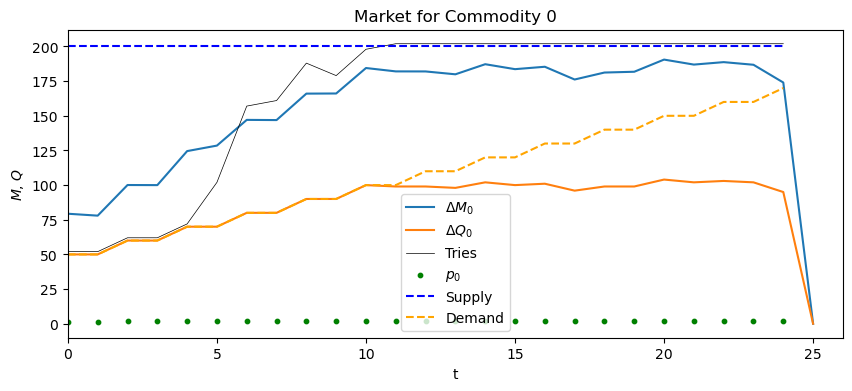

In [14]:
plot_market(0, log=False, supply_demand=True)
plt.xlim(0,T)
#plt.ylim(1e-1, 2e2)

#name = f'method={price_adjust_method} M={M} gam={gamma} eps={epsilon} max_agent_tries={max_agent_tries}'
#plt.savefig('market_plot1 ' + name + '.png')

In [15]:
#QE_df/NB

In [16]:
#plot_market(1, log=True)
#demand_df

In [17]:
np.nanmean(ME_df/QE_df, axis=0)

C:\Users\Alex\AppData\Local\Temp\ipykernel_22448\3985086816.py:1: RuntimeWarning: invalid value encountered in divide
  np.nanmean(ME_df/QE_df, axis=0)
C:\Users\Alex\AppData\Local\Temp\ipykernel_22448\3985086816.py:1: RuntimeWarning: Mean of empty slice
  np.nanmean(ME_df/QE_df, axis=0)


array([1.79951553,        nan])

C:\Users\Alex\AppData\Local\Temp\ipykernel_22448\413915956.py:57: RuntimeWarning: invalid value encountered in divide
  p = ME_df[:,i]/QE_df[:,i]


(0.0, 26.0)

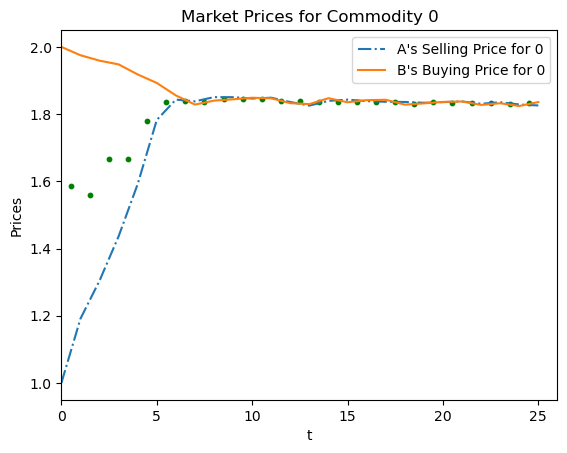

In [18]:
plot_prices(p_df, 0, log=False, includeM=False, A=0, B=NA)
plt.xlim(0,T)
#plt.ylim(1e-1, 2e2)

#name = f'method={price_adjust_method} M={M} gam={gamma} eps={epsilon} max_agent_tries={max_agent_tries}'
#plt.savefig('market_plot2 ' + name + '.png')

C:\Users\Alex\AppData\Local\Temp\ipykernel_22448\413915956.py:57: RuntimeWarning: invalid value encountered in divide
  p = ME_df[:,i]/QE_df[:,i]


(0.0, 26.0)

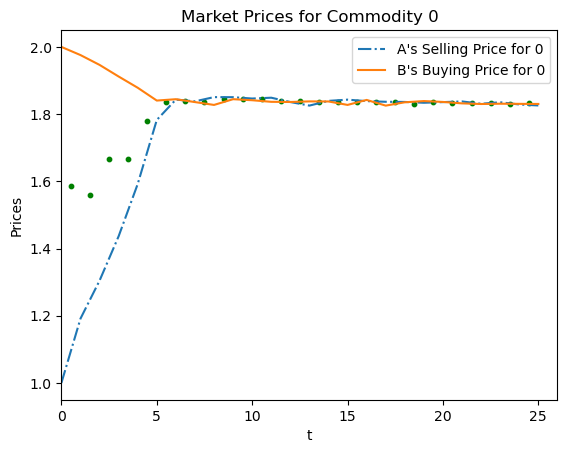

In [19]:
plot_prices(p_df, 0, log=False, includeM=False, A=0, B=NA+1)
plt.xlim(0,T)

Text(0.5, 1.0, 'Commodity 0. Blue Selling Price. Orange Asking Price')

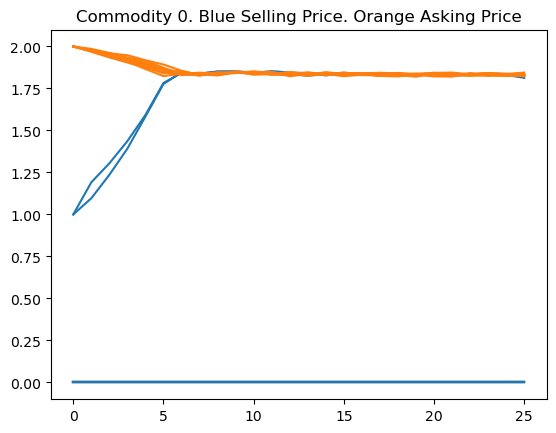

In [20]:
p_buy, p_sell = p_df[0], p_df[1]

for n in range(N):
    plt.plot(p_sell[:,n][:,0], c='C0')
    plt.plot(p_buy[:,n][:,0], c='C1')
    
plt.title('Commodity 0. Blue Selling Price. Orange Asking Price')

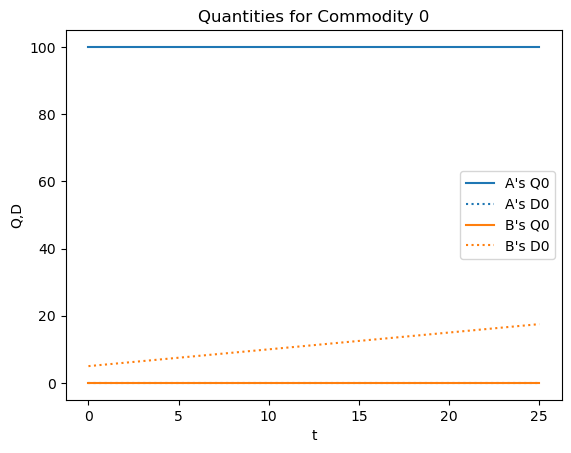

In [21]:
plot_quantities(Q_df, D_df, 0, A=0, B=NA)

In [22]:
#plot_quantities(Q_df, D_df, 0, A=1, B=NA+1)

In [23]:
#market.set_intended_exchange(ExchangeDict)

In [24]:
market.IntendedExchange

{<Agents.Agent at 0x2c176fc1e70>: array([9., 0.]),
 <Agents.Agent at 0x2c176fc30a0>: array([9., 0.]),
 <Agents.Agent at 0x2c176fc2d70>: array([8., 0.]),
 <Agents.Agent at 0x2c176fc21d0>: array([9., 0.]),
 <Agents.Agent at 0x2c176fc24d0>: array([9., 0.]),
 <Agents.Agent at 0x2c176fc3c70>: array([4., 0.]),
 <Agents.Agent at 0x2c176fc3ee0>: array([8., 0.]),
 <Agents.Agent at 0x2c176fc2f50>: array([6., 0.]),
 <Agents.Agent at 0x2c176fc1c30>: array([3., 0.]),
 <Agents.Agent at 0x2c176fc1ba0>: array([10.,  0.])}

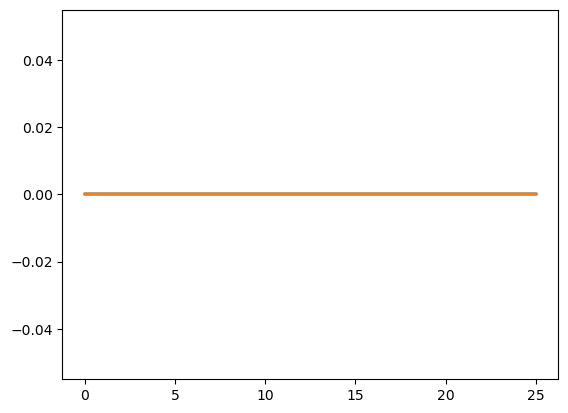

In [25]:
p_buy, p_sell = p_df[0], p_df[1]

for v in range(N):
    plt.plot(p_sell[:,v][:,1], c='C0')
    plt.plot(p_buy[:,v][:,1], c='C1')

In [26]:
#for n in range(NA):
#    plot_quantities(Q_df, D_df, 0, A=n, B=NA+n)

In [27]:
#plot_prices(p_df, 1, log=True, includeM=True, A=0, B=NA)
#plt.grid()

In [28]:
#plot_quantities(Q_df, D_df, 1, A=0, B=NA)

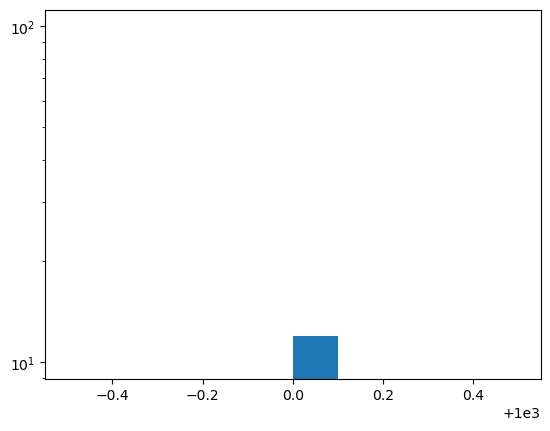

In [29]:
plt.hist([agent.M for agent in agent_list])
plt.yscale('log')

In [30]:
Q = np.zeros(n)
for agent in agent_list:
    Q += agent.Q
    
Q

ValueError: operands could not be broadcast together with shapes (11,) (2,) (11,) 

In [ ]:
Q = np.zeros(n)
for agent in agentA_list:
    Q += agent.Q
    
Q

In [ ]:
for agent in agent_list:
    
    agent.p

In [ ]:
p_buy[:,n][:,1]

In [ ]:
p_buy[:,n]